In [1]:
import pandas as pd
import numpy as np
import seaborn
import matplotlib
import statistics
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA
from sklearn.manifold import TSNE
from sklearn.manifold import MDS
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
import math
import glob
from itertools import combinations
from matplotlib import pyplot as plt
from Bio import Phylo
import biotite
from pca_plot import *
from pyranges import PyRanges

# Documentation 


We got CNV data from 3 softwares; CNVnator, QDNASeq and WiseCondor for the 279 samples of Simmons diversity project.
    
The 279 files of CNVs from CNVnator were merged with this command: 
```
!awk 'BEGIN{OFS="\t"} {print FILENAME,$0}' * > CNVnator_results.txt ```

in /branchinecta/jbazanwilliamson/CNVnator directory 


Telomeres and centromeres coordinates were extracted in Genome Table Browser

Gene anotation was extracted in Genome Table Browser(GENECODE V39/KnownGene)

In [2]:
anotation = pd.read_csv('../data/SGDP_anotation.csv', sep=',', encoding='latin-1',  index_col=1)
telomeres = pd.read_table('../data/telomere_hg38')
centromeres = pd.read_table('../data/centromeres_hg38')
hm3_cnv_data = pd.read_table('../data/hm3_cnv_submission.txt')
header_list = ['Sample_name','Type', 'Position', 'Lenght', 'RD', 'T-TEST-EVAL', 'GAUSSIAN-EVAL', 'T-TEST-EVAL(MIDDLE)','GAUSSIAN-EVAL(MIDDLE)', 'FRAQ-READ-QUALITY' ]
cnvnator_data = pd.read_table('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/CNVnator/CNVnator_results.txt', names=header_list)

telomeres['chrom'] = telomeres['chrom'].str.replace('chr', '')


centromeres['chrom'] = centromeres['chrom'].str.replace('chr', '')

#Table browser is 0-based coordinates, changed to 1-based for compability with CNV data
telomeres['chromStart'] = telomeres['chromStart'] + 1

centromeres['chromStart'] = centromeres['chromStart'] + 1

hm3_cnv_data['chr'] = hm3_cnv_data['chr'].astype(str)

black_header = ['Chromosome','Start', 'End', 'Type']
blacklist = pd.read_table('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/bin_anotation/hg19-blacklist.v2.bed', names=black_header)
blacklist['Chromosome'] = blacklist['Chromosome'].str.replace('chr', '')

blacklist

,Chromosome,Start,End,Type
0,10,38726200,42489100,High Signal Region
1,10,42524900,42819200,High Signal Region
2,10,98560400,98562500,High Signal Region
3,10,135437600,135534700,High Signal Region
4,11,0,196300,High Signal Region
...,...,...,...,...
829,X,154528900,154616300,High Signal Region
830,X,155038500,155270500,High Signal Region
831,Y,7432700,13491000,High Signal Region
832,Y,13633400,14289000,High Signal Region


,Sample_name,Type,Position,Lenght,RD,T-TEST-EVAL,GAUSSIAN-EVAL,T-TEST-EVAL(MIDDLE),GAUSSIAN-EVAL(MIDDLE),FRAQ-READ-QUALITY
1498,LP6005441-DNA_A01,duplication,5:10001-11800,1800.0,96.0883,0.000036,0.000000e+00,1.000000e+00,1.000000e+00,1
1876,LP6005441-DNA_A01,duplication,6:58776201-58779800,3600.0,240.9260,0.000070,8.625340e-114,6.149640e+00,0.000000e+00,1
2549,LP6005441-DNA_A01,duplication,8:46847801-46851800,4000.0,91.0099,0.049930,4.055890e+06,9.104630e+00,1.426030e+04,1
4639,LP6005441-DNA_A01,duplication,16:46385801-46435600,49800.0,105.1270,0.000000,2.562190e+09,0.000000e+00,2.573930e+09,1
5714,LP6005441-DNA_A01,duplication,X:58567001-58582000,15000.0,69.7822,0.000000,2.159930e-147,0.000000e+00,1.415530e-126,1
...,...,...,...,...,...,...,...,...,...,...
2651609,SS6004480,duplication,hs37d5:27031901-27049400,17500.0,54.8327,0.000448,8.002610e+08,6.121430e-04,9.260570e+08,1
2651652,SS6004480,duplication,hs37d5:27807801-27819700,11900.0,52.1034,0.000138,2.434700e+09,1.443290e-02,2.503090e+09,1
2651657,SS6004480,duplication,hs37d5:27899201-27917100,17900.0,51.9522,0.000035,3.555200e-03,7.008020e-05,0.000000e+00,1
2651709,SS6004480,duplication,hs37d5:29143101-29155600,12500.0,56.5016,0.000169,2.573310e+09,2.724670e-02,2.618780e+09,1


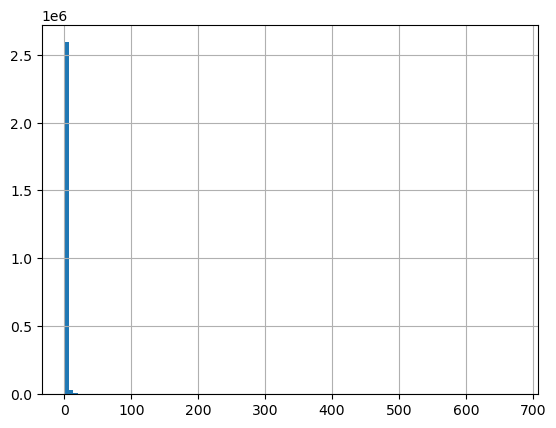

In [3]:
cnvnator_data['RD'].hist(bins=100)
#cnvnator_data['T-TEST-EVAL'].hist(bins=100)
cnvnator_data['Lenght'].describe()

cnvnator_data[cnvnator_data['RD'] > 50]

## Filtration


<AxesSubplot:>

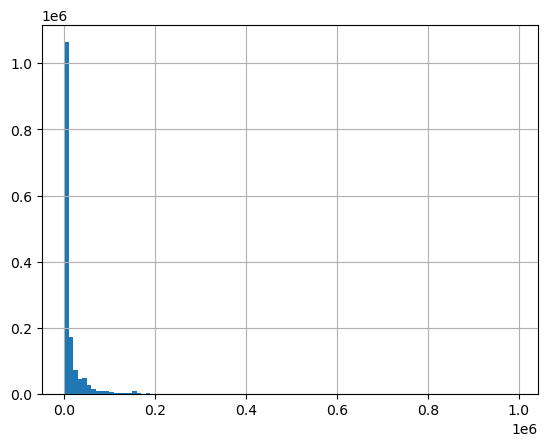

In [4]:
#FILTRATION BY SIGNIFICANCE 

cnvnator_data = cnvnator_data[cnvnator_data['T-TEST-EVAL'] <= 0.05]
#cnvnator_data = cnvnator_data[cnvnator_data['T-TEST-EVAL(MIDDLE)'] <= 5.14E-11]

## Filtering by size 
cnvnator_data = cnvnator_data[cnvnator_data['Lenght'] >= 1000] #more than 1kb 
cnvnator_data = cnvnator_data.loc[(cnvnator_data['Lenght'] < 1000000),:] #less than 1 Mb

##GAUSIAN DISTRIBUTION
#deletion = cnvnator_data[cnvnator_data['GAUSSIAN-EVAL'] < 0.0003]
#duplicatons = cnvnator_data[cnvnator_data['GAUSSIAN-EVAL'] > 4.550540e+04]

cnvnator_data['Lenght'].hist(bins=100)

In [5]:
#SEPARATE COORDINATES
coordinates = cnvnator_data['Position'].str.split(':', expand=True)
CHROMOSOME = coordinates[0]

split_position = coordinates[1].str.split('-', expand=True)
START = split_position[0]
STOP = split_position[1]

cnvnator_style= pd.DataFrame()
cnvnator_style['Sample_ID'] = cnvnator_data['Sample_name']
cnvnator_style['Chromosome'] = CHROMOSOME
cnvnator_style['Start'] = START
cnvnator_style['End'] = STOP
cnvnator_style['CNV_value'] = cnvnator_data['Type']

cnvnator_style['CNV_value'].replace('deletion', 1, inplace=True)
cnvnator_style['CNV_value'].replace('duplication', 3, inplace=True)
cnvnator_style
cnvnator_style['Start'] = cnvnator_style['Start'].astype(int)
cnvnator_style['End'] = cnvnator_style['End'].astype(int)
cnvnator_style['CNV_value'] = cnvnator_style['CNV_value'].astype(float)

cnvnator_style['Type'] = cnvnator_data['Type']

cnvnator_style['RD'] = cnvnator_data['RD']
cnvnator_style['Lenght'] = cnvnator_data['Lenght']
cnvnator_style['T-TEST-EVAL'] = cnvnator_data['T-TEST-EVAL']
cnvnator_style['GAUSSIAN-EVAL'] = cnvnator_data['GAUSSIAN-EVAL']
cnvnator_style


#Removing another reference chromosomes
chromosomes= ['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','X','Y']

cnvnator_style = cnvnator_style[cnvnator_style.Chromosome.isin(chromosomes)]

cnvnator_style.value_counts("Sample_ID")


# NOTE: 
# This result were used as output for CNVR detection for CNVnator

Sample_ID
LP6005592-DNA_G03    98448
LP6005443-DNA_E10    23169
LP6005442-DNA_E04    18722
LP6005443-DNA_F10    12604
SS6004472             6747
                     ...  
LP6005441-DNA_H11     2837
LP6005441-DNA_D11     2808
LP6005442-DNA_H09     2808
LP6005442-DNA_B12     2803
LP6005441-DNA_B12     2775
Length: 279, dtype: int64

In [6]:
#REMOVE SAMPLES WITH ABERRATIONS
samples_with_aberrations = ['LP6005441-DNA_B03', ' LP6005443-DNA_G01', 'LP6005441-DNA_G09', 'LP6005441-DNA_D04'] 

cnvnator_style = cnvnator_style[~cnvnator_style.Sample_ID.isin(samples_with_aberrations)]

cnvnator_style = cnvnator_style
cnvnator_style.value_counts("Sample_ID")

Sample_ID
LP6005592-DNA_G03    98448
LP6005443-DNA_E10    23169
LP6005442-DNA_E04    18722
LP6005443-DNA_F10    12604
SS6004472             6747
                     ...  
LP6005441-DNA_H11     2837
LP6005442-DNA_H09     2808
LP6005441-DNA_D11     2808
LP6005442-DNA_B12     2803
LP6005441-DNA_B12     2775
Length: 276, dtype: int64

In [7]:
## Filter by chromosomes
cnvnator_data_df_x = cnvnator_style[cnvnator_style.Chromosome == 'X']
cnvnator_data_df_no_sex_chr = cnvnator_style[cnvnator_style.Chromosome != 'Y']
cnvnator_data_df_no_sex_chr = cnvnator_style[cnvnator_style.Chromosome != 'X']

cnvnator_data_df_x


,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
5612,LP6005441-DNA_A01,X,1,60000,1.0,deletion,0.000000,60000.0,2.656210e-12,0.000000e+00
5613,LP6005441-DNA_A01,X,60001,63600,3.0,duplication,1.747000,3600.0,4.427010e-09,1.358200e+00
5614,LP6005441-DNA_A01,X,65501,144900,1.0,deletion,0.050844,79400.0,2.007210e-12,3.474740e-28
5615,LP6005441-DNA_A01,X,155001,156300,3.0,duplication,2.260460,1300.0,1.583960e-02,5.962230e-30
5616,LP6005441-DNA_A01,X,157001,175600,3.0,duplication,1.770210,18600.0,0.000000e+00,2.512670e+09
...,...,...,...,...,...,...,...,...,...,...
2650122,SS6004480,X,154746101,154751600,3.0,duplication,1.605410,5500.0,4.260570e-05,7.501830e+08
2650123,SS6004480,X,154798801,154804000,1.0,deletion,0.315173,5200.0,3.064860e-11,2.713240e+05
2650124,SS6004480,X,154930601,155237300,3.0,duplication,2.051740,306700.0,0.000000e+00,1.357150e-06
2650125,SS6004480,X,155251101,155255500,3.0,duplication,3.818850,4400.0,3.778070e-06,2.850670e+09


In [8]:
# Filter inviduals that have less than 100 CNVs
cnvnator_style#.groupby('Sample_ID').filter(lambda x : (x['Sample_ID'].count()<=2000).any())

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,1,10000,1.0,deletion,0.000000,10000.0,1.593730e-11,0.000000e+00
1,LP6005441-DNA_A01,1,11601,18400,3.0,duplication,1.885520,6800.0,0.000000e+00,2.870330e+09
2,LP6005441-DNA_A01,1,39901,48200,1.0,deletion,0.491248,8300.0,1.920150e-11,1.170970e+04
4,LP6005441-DNA_A01,1,51201,64200,1.0,deletion,0.269762,13000.0,1.225940e-11,7.811940e+03
6,LP6005441-DNA_A01,1,69401,70900,1.0,deletion,0.367025,1500.0,6.353720e-03,3.957490e-06
...,...,...,...,...,...,...,...,...,...,...
2650199,SS6004480,Y,28811601,28819400,3.0,duplication,22.740800,7800.0,0.000000e+00,1.677210e+09
2650201,SS6004480,Y,58819401,58917600,3.0,duplication,152.129000,98200.0,0.000000e+00,3.350000e+08
2650202,SS6004480,Y,58917601,58967800,1.0,deletion,0.020383,50200.0,3.174750e-12,2.871000e+09
2650203,SS6004480,Y,58969301,59034000,3.0,duplication,6.555290,64700.0,0.000000e+00,9.377560e-16


<h2> Removing blacklist regions 

In [7]:
blacklist_ranges = PyRanges(blacklist)
cnvnator_style_ranges = PyRanges(cnvnator_style)
blacklist_ranges

,Chromosome,Start,End,Type
0,1,0,750100,High Signal Region
1,1,814500,845200,High Signal Region
2,1,2052400,2056000,High Signal Region
3,1,2582800,2693900,High Signal Region
4,1,4362200,4364300,High Signal Region
...,...,...,...,...
829,X,154528900,154616300,High Signal Region
830,X,155038500,155270500,High Signal Region
831,Y,7432700,13491000,High Signal Region
832,Y,13633400,14289000,High Signal Region


In [8]:
cnvnator_style_df = cnvnator_style_ranges.overlap(blacklist_ranges, invert=True)
#cnvnator_style_df = cnvnator_style_df.as_df()
cnvnator_style_df#.sort_values(by=['Chromosome', 'Start'])

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,912001,913500,1.0,deletion,0.279937,1500.0,6.982630e-05,3.198940e-15
1,LP6005441-DNA_A01,1,954801,956500,1.0,deletion,0.622383,1700.0,3.328280e-02,2.050770e+04
2,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
3,LP6005441-DNA_A01,1,1223401,1225300,1.0,deletion,0.354554,1900.0,4.901130e-03,1.499170e+07
4,LP6005441-DNA_A01,1,1285401,1286800,1.0,deletion,0.080614,1400.0,6.272450e-08,1.827930e-45
...,...,...,...,...,...,...,...,...,...,...
687608,SS6004480,Y,22494701,22496000,1.0,deletion,0.385241,1300.0,1.351890e-02,8.937770e-05
687609,SS6004480,Y,22497301,22500100,1.0,deletion,0.483505,2800.0,2.311780e-02,1.459540e+09
687610,SS6004480,Y,22507701,22512200,3.0,duplication,4.054850,4500.0,4.986960e-04,1.226960e-04
687611,SS6004480,Y,23901401,23951400,1.0,deletion,0.000130,50000.0,3.187450e-12,0.000000e+00


In [11]:
cnvnator_style_df['RD'].hist(bins=100)
cnvnator_style_df['GAUSSIAN-EVAL'].hist(bins=100)
cnvnator_style_df['T-TEST-EVAL'].describe()

AttributeError: ('PyRanges object has no attribute', 'hist')

AttributeError: ('PyRanges object has no attribute', 'groupby')

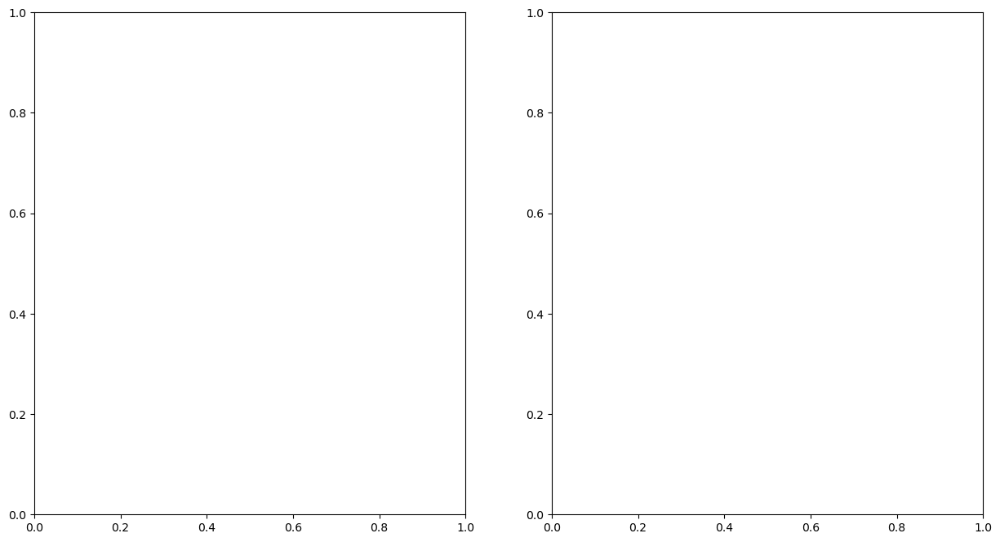

In [12]:
fig, axs = plt.subplots(1, 2, figsize=(15, 8))

df_plot= cnvnator_style_df.groupby(['Type'])['Lenght']

df_plot.plot(kind='hist',stacked=True, bins=100, legend=True, ax=axs[0]) # alpha for transparency

plt.xscale('log')
#plt.show()

df_plot = cnvnator_style_df.groupby(['Type'])['Lenght']

df_plot.plot(kind='hist',stacked=True, bins=100, legend=True, ax=axs[1]) # alpha for transparency

plt.show()

In [65]:
# SAMPLE TO COMPARE 
samples = cnvnator_style.loc[cnvnator_style['Sample_ID'] == "LP6005442-DNA_B01"]
samples.loc[samples['Chromosome']== '1'].head(20)

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
748649,LP6005442-DNA_B01,1,1,10000,1.0,deletion,0.000000,10000.0,1.593730e-11,0.000000e+00
748650,LP6005442-DNA_B01,1,11601,18800,3.0,duplication,2.584290,7200.0,0.000000e+00,2.151340e+09
748651,LP6005442-DNA_B01,1,33701,35000,3.0,duplication,1.776580,1300.0,9.453060e-03,7.643420e-22
748652,LP6005442-DNA_B01,1,45101,76800,3.0,duplication,1.531770,31700.0,0.000000e+00,2.749280e+09
748653,LP6005442-DNA_B01,1,122301,124000,3.0,duplication,1.622440,1700.0,2.902750e-02,2.552690e-04
748654,LP6005442-DNA_B01,1,137401,139700,3.0,duplication,1.829610,2300.0,1.344550e-06,3.399330e-13
748655,LP6005442-DNA_B01,1,177201,227700,1.0,deletion,0.005085,50500.0,3.155890e-12,5.091920e-194
748656,LP6005442-DNA_B01,1,230901,237000,3.0,duplication,1.622360,6100.0,1.065970e-08,5.870810e+03
748657,LP6005442-DNA_B01,1,248701,267400,3.0,duplication,1.300410,18700.0,0.000000e+00,5.179740e+08
748658,LP6005442-DNA_B01,1,267401,318300,1.0,deletion,0.009539,50900.0,3.131090e-12,1.261630e-195


In [66]:
samples = cnvnator_style_df.loc[cnvnator_style_df['Sample_ID'] == "LP6005442-DNA_B01"]
samples.loc[samples['Chromosome']== '4']

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
162331,LP6005442-DNA_B01,4,738501,741400,1.0,deletion,0.382726,2900.0,1.099120e-10,1.804740e-15
162332,LP6005442-DNA_B01,4,1602401,1603800,1.0,deletion,0.556440,1400.0,2.194770e-02,1.928200e-07
162333,LP6005442-DNA_B01,4,3572901,3576500,3.0,duplication,1.923240,3600.0,0.000000e+00,8.474580e-63
162334,LP6005442-DNA_B01,4,3592501,3595800,3.0,duplication,1.896920,3300.0,0.000000e+00,1.899250e-08
162335,LP6005442-DNA_B01,4,4014901,4021200,3.0,duplication,1.545250,6300.0,0.000000e+00,4.223270e-23
...,...,...,...,...,...,...,...,...,...,...
162413,LP6005442-DNA_B01,4,189366501,189368400,1.0,deletion,0.409878,1900.0,2.823570e-04,5.079020e-17
162414,LP6005442-DNA_B01,4,189424401,189426100,1.0,deletion,0.379767,1700.0,4.287970e-03,4.848800e-15
162415,LP6005442-DNA_B01,4,189437101,189438900,1.0,deletion,0.445521,1800.0,2.390590e-07,2.852930e-13
162416,LP6005442-DNA_B01,4,190063201,190064300,1.0,deletion,0.583030,1100.0,2.983260e-02,4.168900e-02


<h1> Adaptative introgression paper data 
    
https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6860971/

In [9]:
#pd.set_option('display.max_rows', 400)


archaic_data = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/NIHMS1057227-CNVs.csv')
archaic_data = archaic_data.drop(columns=['name'])

header= ['Sample', 'Region', 'Country', 'Sample_ID', 'Sex']
archaic_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/archaic_anotation.csv', names=header, index_col=3)

papers_names_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/archaic_cnv_anotation.csv', index_col=0)

archaic_data['Chromosome'] = archaic_data['chr'].str.replace('chr', '')
archaic_data = archaic_data.drop(columns=['chr'])
first_column = archaic_data.pop('Chromosome')
archaic_data.insert(0, 'Chromosome', first_column)
#archaic_data#['MEL_Papuan_HGDP00554_F']

a = archaic_anotation.merge(papers_names_anotation, left_index=True, right_index=True)
a = a.set_index("Biosample")
b= pd.read_csv('../data/SGDP_anotation.csv', sep=',', encoding='latin-1',  index_col=0)
c = a.merge(b, left_index=True, right_index=True)
c = c.set_index("Sample")
c = c.loc[:,["Region", "Country", "3-Illumina_ID"]]


archaic_data.loc[archaic_data['Chromosome'] == '1'].sort_values(by='start').head(100)

,Chromosome,start,end,AFR_BantuSEHerero_HGDP01028_M,AFR_BantuSEHerero_HGDP01035_M,AFR_BantuKenya_HGDP01414_F,AFR_BantuKenya_HGDP01417_M,AFR_BantuSETswana_HGDP01030_M,AFR_BantuSETswana_HGDP01034_M,AFR_Biaka_HGDP00457_M,...,Pongo_abelii.SB550_Sibu,Pongo_pygmaeus.A939_Nonja,Pongo_pygmaeus.A942_Gusti,Pongo_pygmaeus.A943_Tilda,Pongo_pygmaeus.A944_Napoleon,Pongo_pygmaeus.KB4204_Dinah,Pongo_pygmaeus.KB5404_Billy,Pongo_pygmaeus.KB5405_Louis,Pongo_pygmaeus.KB5406_Doris,Pongo_pygmaeus.KB5543_Baldy
4,1,228416,267160,25.356205,26.947875,21.402028,25.119371,33.538046,26.208535,27.854900,...,1.755784,1.789332,1.999602,1.819331,1.627895,1.772766,1.798521,1.943588,1.570548,1.682988
12,1,521526,568203,17.875750,16.406981,15.916677,14.211191,19.301836,16.930978,15.724644,...,1.892335,1.638105,2.045797,1.794610,1.664672,1.814563,1.833169,1.636279,1.932070,1.646897
13,1,563872,572534,592.654016,875.917401,814.583338,1230.985097,815.557291,985.870941,616.571378,...,17.363798,21.377159,25.211293,21.957171,20.817677,21.065862,131.051664,72.480488,98.266840,10.111808
29,1,899742,901754,1.687674,1.908226,1.612003,1.943254,1.892704,1.885649,1.831222,...,1.668851,0.393950,0.436527,0.459743,0.742526,1.631311,1.355506,1.677574,1.552956,1.763860
56,1,974768,978161,1.723267,1.738481,1.735712,1.518285,1.500395,1.698948,1.784821,...,2.248982,0.572580,0.429163,0.446511,0.476026,2.277004,1.326295,2.170298,1.422584,1.692004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
391,1,17231801,17255960,4.327506,4.056273,4.234895,4.519720,5.473090,5.346427,3.926636,...,3.137796,2.916423,2.959828,3.349385,3.128180,3.472536,3.737584,3.728429,3.436526,3.013456
406,1,17593888,17624343,2.033922,1.929866,1.902173,2.040466,1.892829,2.028957,1.951667,...,2.245410,2.170467,2.627667,2.427087,2.458161,2.084938,2.187453,2.156249,2.100986,2.000427
410,1,18810014,18811469,1.772283,2.065152,1.996543,1.896283,1.991792,1.973519,1.755632,...,1.745370,2.053511,2.516821,2.040989,2.425419,2.356334,1.936186,2.176461,2.260968,1.987367
428,1,19741516,19743850,2.080887,1.766208,1.922307,2.060330,2.144232,1.907029,2.244147,...,2.101368,1.959792,1.961492,1.803808,2.014573,1.883629,1.978415,2.129439,1.806490,1.595120


In [10]:
counts = archaic_data.iloc[:,3:254]
counts = counts.T 
counts = c.merge(counts, left_index=True, right_index=True)
counts = counts.set_index("3-Illumina_ID")
counts = counts.drop(columns=['Region', 'Country'])

counts_a = counts.T
#counts_a
#counts_a['LP6005442-DNA_B01'].sort_values()

In [11]:
counts = archaic_data
counts = counts.T 
counts = c.merge(counts, left_index=True, right_index=True)
counts = counts.set_index("3-Illumina_ID")
counts = counts.drop(columns=['Region', 'Country'])

counts = counts.T

counts.insert(0, 'Chromosome', archaic_data['Chromosome'])
counts.insert(1, 'Start', archaic_data['start'])
counts.insert(2, 'End', archaic_data['end'])

same_name_archaic =  counts
same_name_archaic

3-Illumina_ID,Chromosome,Start,End,LP6005519-DNA_C05,LP6005442-DNA_B01,LP6005443-DNA_B10,LP6005441-DNA_F09,LP6005442-DNA_G01,LP6005441-DNA_D07,LP6005441-DNA_A04,...,LP6005519-DNA_B06,LP6005677-DNA_F01,LP6005441-DNA_H09,LP6005441-DNA_B11,LP6005441-DNA_D02,LP6005441-DNA_H07,LP6005441-DNA_D06,LP6005443-DNA_H01,LP6005441-DNA_A06,LP6005592-DNA_B01
0,1,21910306,21913877,2.401028,1.998262,1.99382,1.954707,1.954912,1.744118,1.974834,...,1.985123,1.808764,1.852649,1.8203,1.768439,1.837633,1.829354,1.853747,1.975165,1.78793
1,1,101212616,101214920,2.016179,2.002721,1.957054,2.004279,1.92147,1.917796,2.127451,...,1.860985,1.935829,1.841631,1.828189,1.951551,1.964953,2.027913,2.04401,2.04998,2.031175
2,1,147384646,147386567,2.139658,1.747312,1.877853,1.727462,1.933126,2.134733,1.815096,...,1.860781,1.816506,1.817291,2.038003,2.068898,1.77547,1.944979,2.065557,1.83025,1.841507
3,1,195013533,195020996,2.346854,1.804865,1.996412,1.94836,1.825581,1.814401,1.905848,...,1.889087,1.59252,1.762702,1.806363,1.819496,1.025321,2.155907,1.949125,1.678309,1.772575
4,1,228416,267160,28.275513,22.632874,25.19126,25.47146,25.607324,26.130299,24.47818,...,25.270744,26.448447,21.417776,26.617903,24.307306,27.64258,28.186419,27.282453,25.899915,19.172355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5130,22,31678952,31682546,2.192174,2.10464,1.983139,1.790199,1.739021,2.016616,2.079623,...,2.020915,2.075747,2.271578,2.12772,1.929148,1.953169,1.945864,2.001003,1.931213,1.803273
5131,22,32112132,32113222,2.268124,1.905573,1.59166,1.93206,2.0577,2.037391,1.956664,...,1.662585,1.85905,1.835675,2.17907,1.904821,2.000083,1.873114,1.847847,1.921276,1.763232
5132,22,50252755,50261847,2.383905,2.145915,2.18008,1.865969,2.096408,2.019804,2.063512,...,1.877926,1.976315,2.017628,1.91006,1.940184,1.798868,1.840821,1.947781,2.076042,1.991117
5133,22,33050377,33056621,2.362471,1.908293,1.98927,1.937375,1.909353,1.810818,1.891251,...,2.011201,1.9498,2.013586,1.913698,1.801449,1.97971,1.9702,1.94429,1.829112,2.022726


In [16]:
count = counts_a.T
#features = archaic_anotation.merge(count, left_index=True, right_index=True)
#features = features.loc[:,["Region", "Country"]]
#features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(counts_a.T)

x = StandardScaler().fit_transform(X)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=count.index)




df_pca = anotation.merge(df_pca, left_index=True, right_index=True)
df_pca

,2-ena_id,4-reich_id,5-ena_ftp_bam_ptr,6-Sequencing_Panel,7-Gender,8-Population_ID,9-Contributor,10-Region,11-Country,12-Town,...,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
3-Illumina_ID,,,,,,,,,,,,,,,,,,,,,
LP6005443-DNA_B06,SAMEA3302859,S_Icelandic-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...,C,F,Icelandic,Coriell,WestEurasia,Iceland,Cell_line_repository_sampling_location_unknown,...,-2.064271,1.268795,7.582693,-5.186522,-7.449214,1.597403,-3.994466,-5.893180,-3.052676,-2.334831
LP6005442-DNA_D08,SAMEA3302837,S_Icelandic-1,ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...,C,F,Icelandic,Coriell,WestEurasia,Iceland,Cell_line_repository_sampling_location_unknown,...,-6.634009,2.742635,4.229136,-4.669253,-8.643739,2.065607,-4.150106,-6.216467,-2.567698,2.739049
LP6005441-DNA_D07,SAMEA3302616,S_Makrani-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324870/LP6005...,C,F,Makrani,Howard Cann,SouthAsia,Pakistan,?,...,-14.023536,6.777031,12.867001,-4.698124,-5.953628,1.008707,-1.225951,0.339175,-3.595641,5.372792
LP6005441-DNA_C07,SAMEA3302771,S_Makrani-1,ftp.sra.ebi.ac.uk/vol1/ERZ312/ERZ312785/LP6005...,C,M,Makrani,Howard Cann,SouthAsia,Pakistan,?,...,-8.518061,5.182573,12.797773,-10.492898,-8.229135,0.699795,2.295955,-2.839390,-0.204197,-4.515116
LP6005442-DNA_F12,SAMEA3302764,S_Tubalar-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324267/LP6005...,C,F,Tubalar,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Artybash and Kebezen, Altai-Sayan Upland",...,-4.072285,-3.532626,-15.023069,3.219845,-0.394946,0.253971,-1.925691,-1.601559,1.806811,-6.471934
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005441-DNA_H06,SAMEA3302662,S_Karitiana-2,ftp.sra.ebi.ac.uk/vol1/ERZ312/ERZ312827/LP6005...,C,F,Karitiana,Howard Cann,America,Brazil,?,...,-10.391385,4.163947,8.757118,12.068099,2.792765,0.068520,-0.148013,14.960833,-4.558790,-7.275418
LP6005441-DNA_H10,SAMEA3302766,S_Russian-2,ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125631/srt.al...,C,F,Russian,Howard Cann,WestEurasia,Russia,Vologda Administrative Region,...,-13.943043,8.615522,16.901378,-2.209348,-9.167962,2.813846,-5.824724,-0.205770,-3.255232,1.567720
LP6005519-DNA_A06,SAMEA3302692,S_Burmese-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324351/LP6005...,C,M,Burmese,Toomas Kivisild / Joseph Wee Tien Seng,EastAsia,Myanmar,Yangon (sampled in Singapore),...,-0.836253,-8.722601,-14.597679,1.459572,-0.911028,-4.667838,4.977166,-7.561827,6.792788,-7.908307


                        2-ena_id     4-reich_id  \
10-Region                                         
WestEurasia         SAMEA3302859  S_Icelandic-2   
WestEurasia         SAMEA3302837  S_Icelandic-1   
SouthAsia           SAMEA3302616    S_Makrani-2   
SouthAsia           SAMEA3302771    S_Makrani-1   
CentralAsiaSiberia  SAMEA3302764    S_Tubalar-1   
...                          ...            ...   
America             SAMEA3302662  S_Karitiana-2   
WestEurasia         SAMEA3302766    S_Russian-2   
EastAsia            SAMEA3302692    S_Burmese-2   
EastAsia            SAMEA3302895    S_Burmese-1   
Africa              SAMEA3302716      S_Mbuti-2   

                                                    5-ena_ftp_bam_ptr  \
10-Region                                                               
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...   
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...   
SouthAsia           ftp.sra.ebi.ac.uk/vol1/E

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


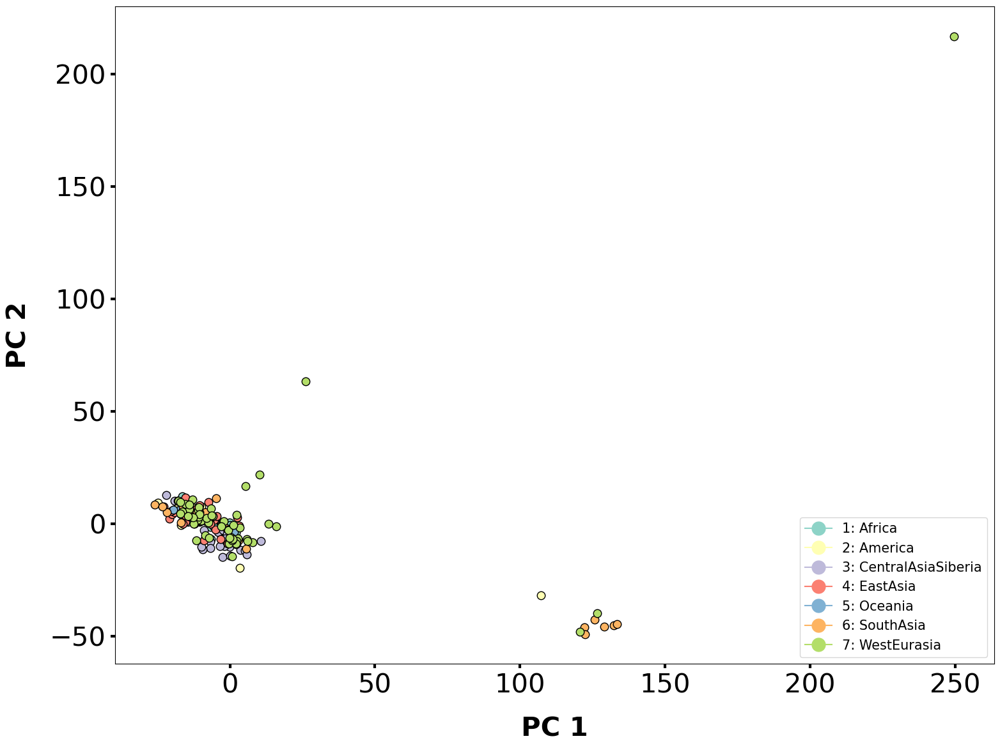

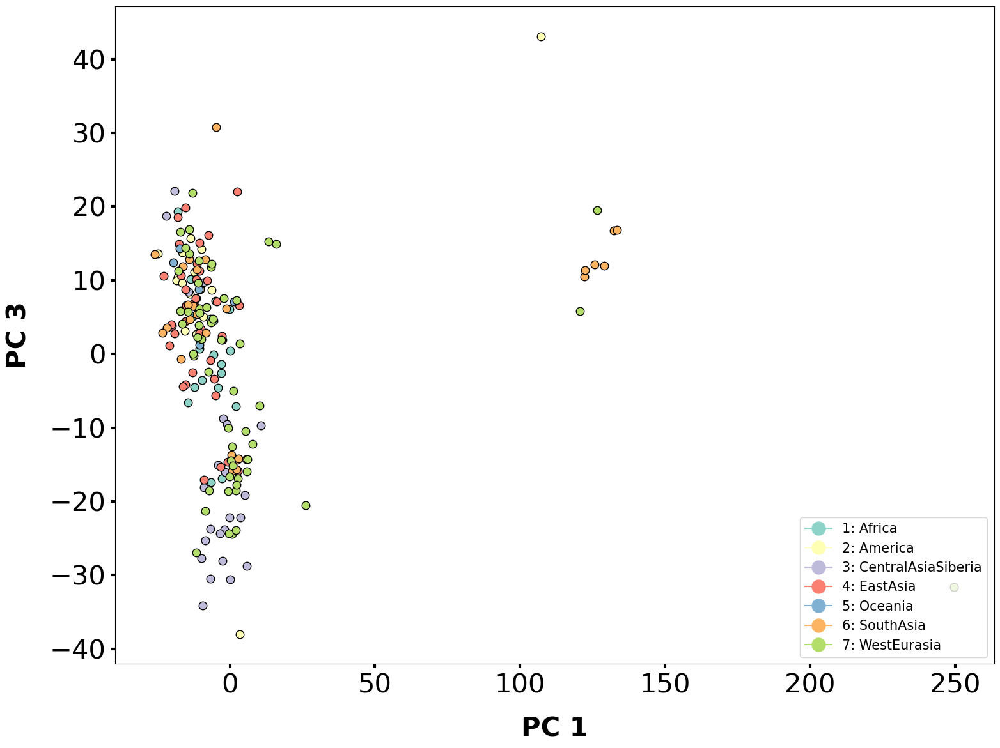

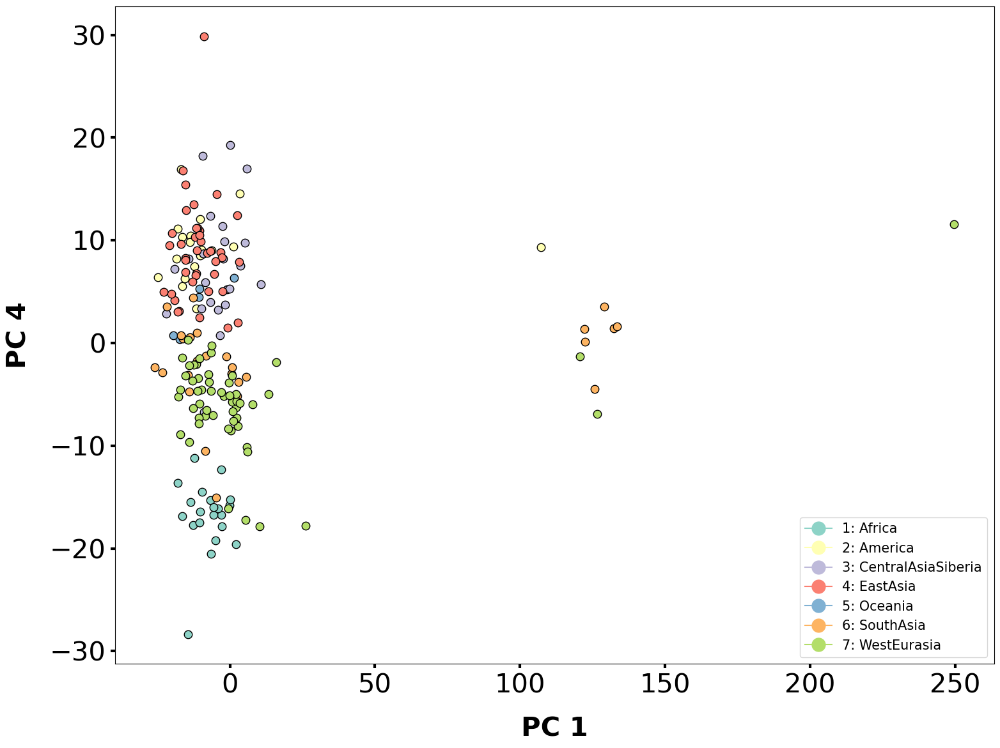

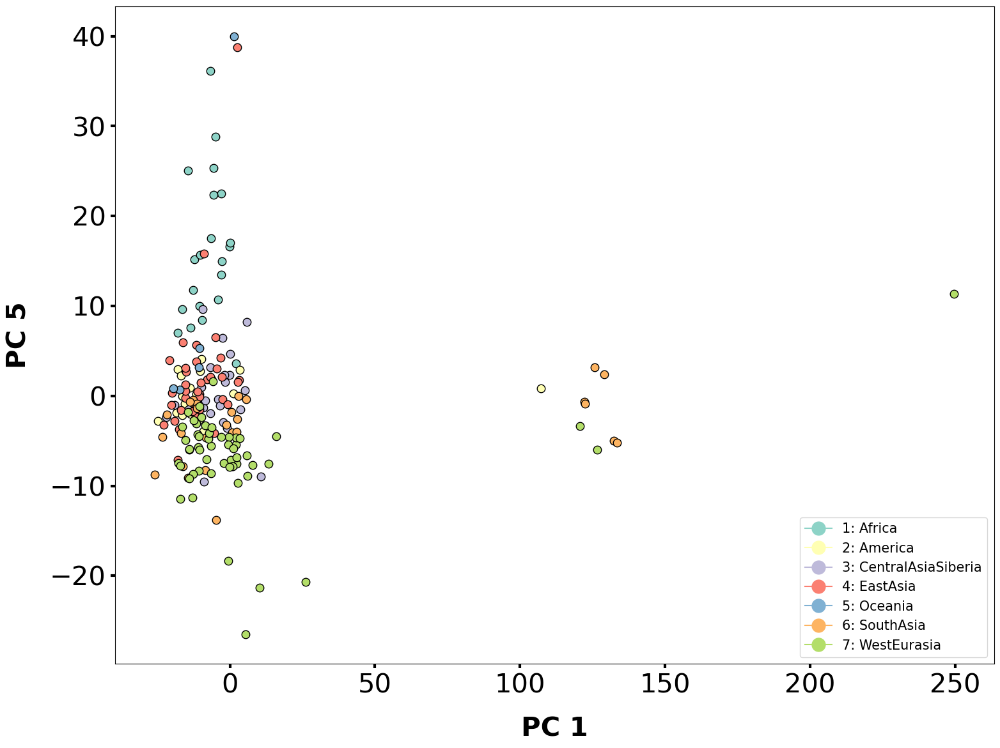

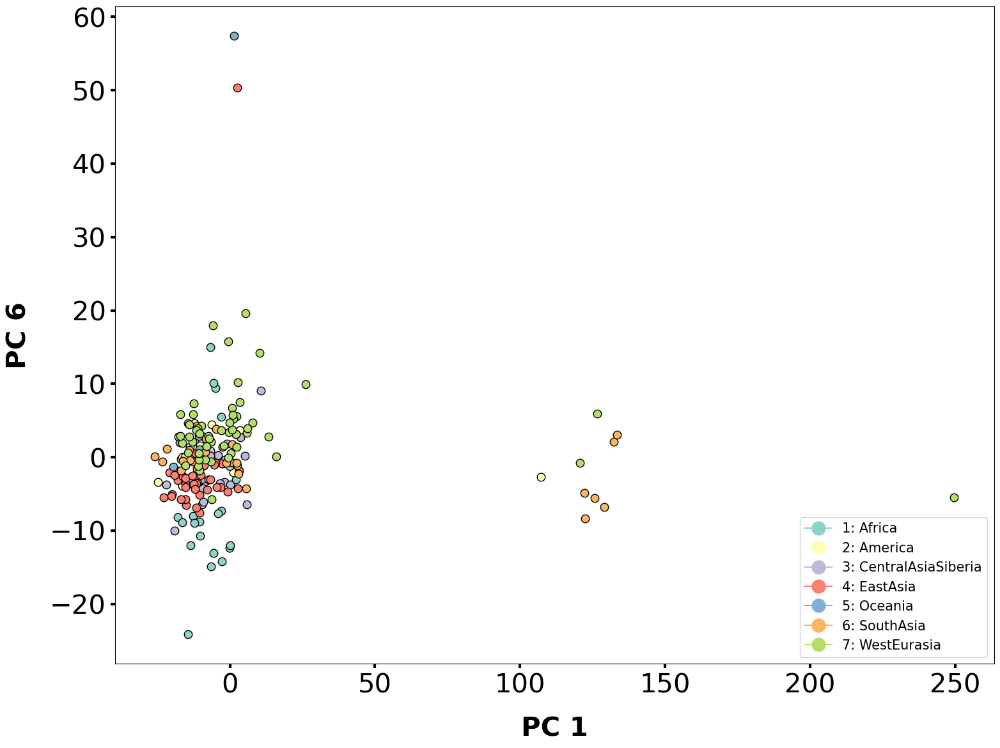

...

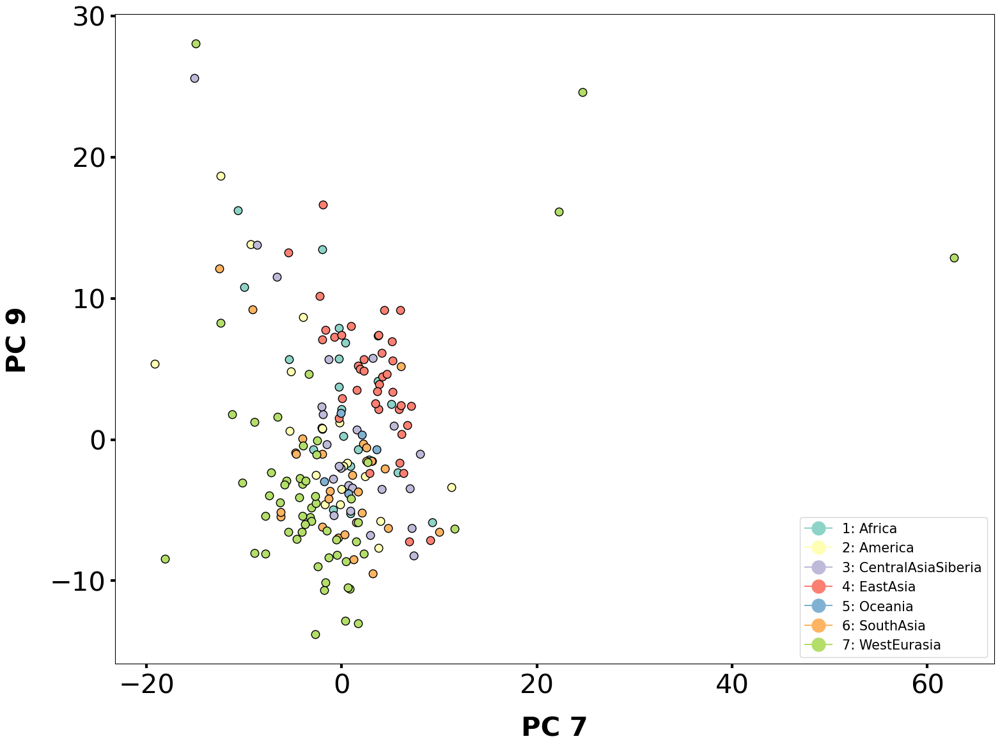

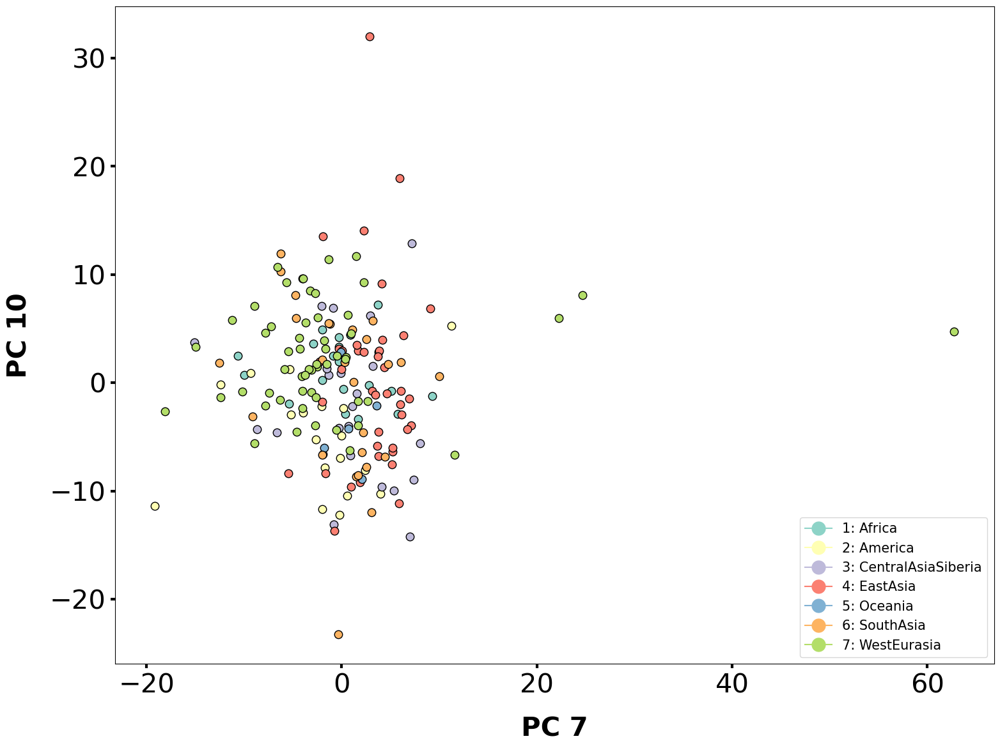

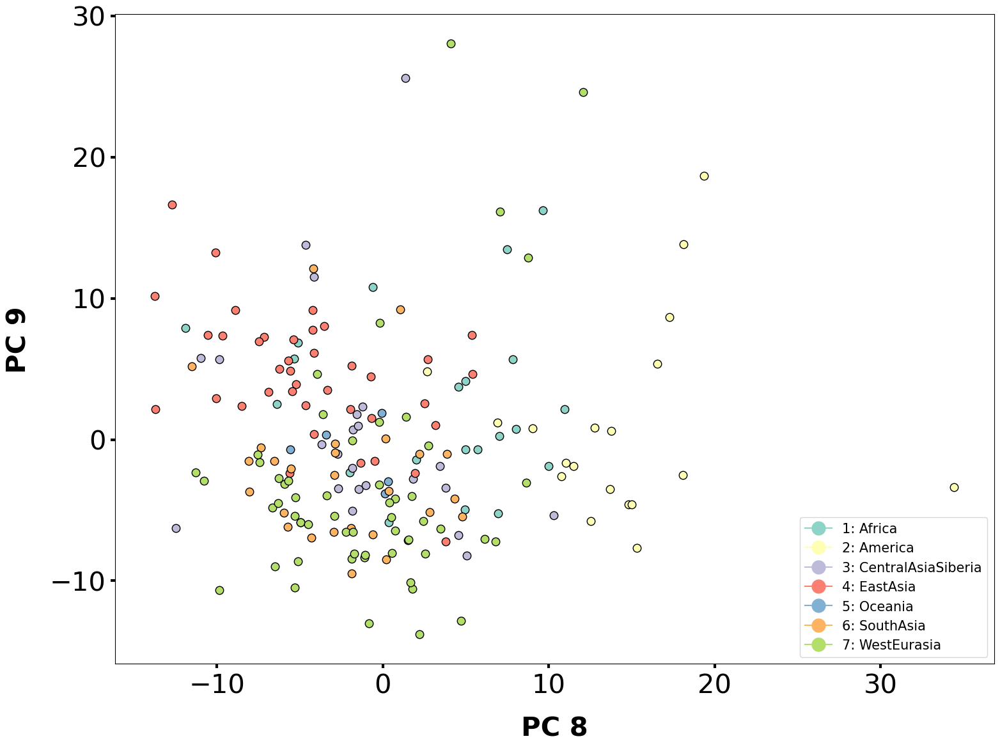

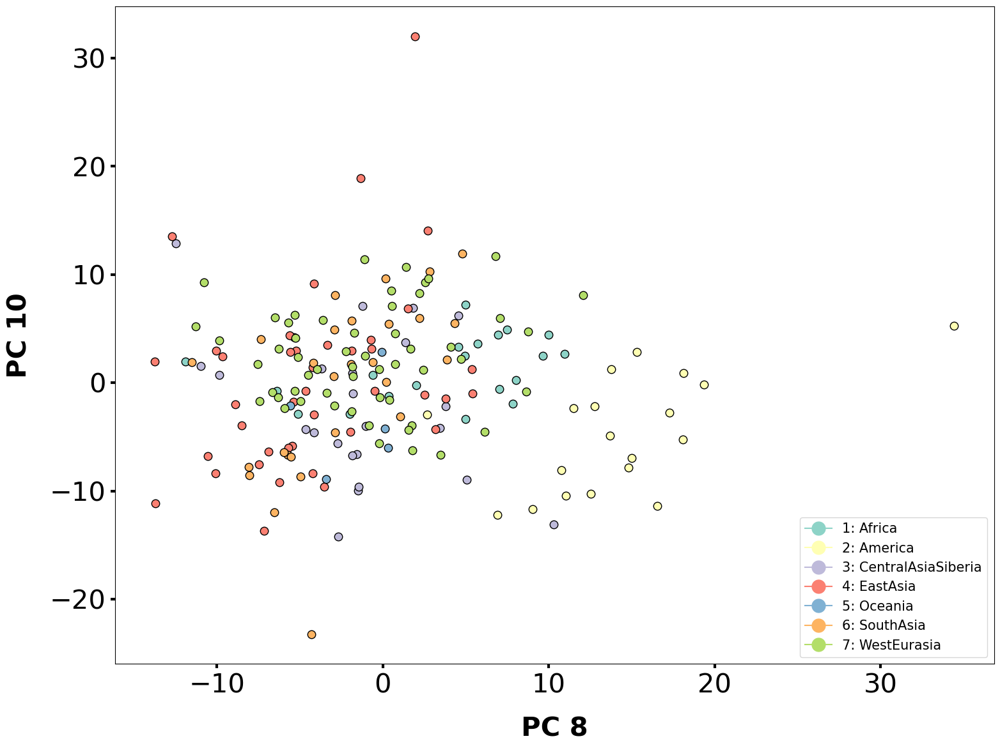

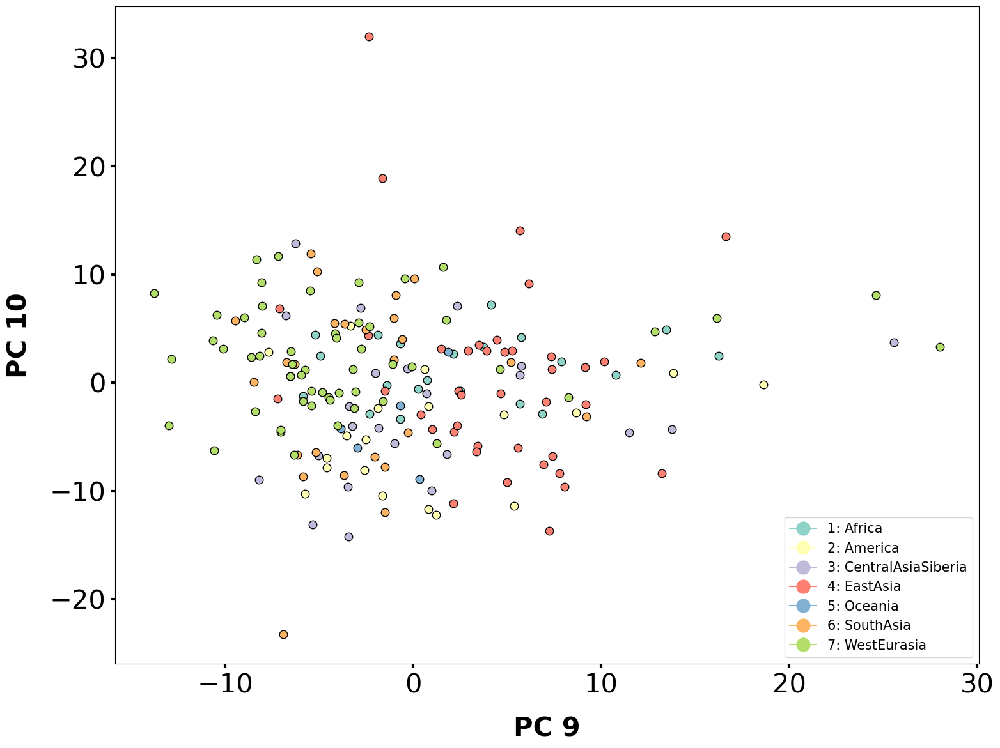

In [97]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)


In [88]:
pca.explained_variance_ratio_

array([0.23088838, 0.07848437, 0.03907977, 0.01819508, 0.01630781,
       0.01227403, 0.01054727, 0.01034539, 0.00985075, 0.00871378])

<h2> Filtering my CNVs only in archaic papers CNVs

In [12]:
archaic_ranges = PyRanges(same_name_archaic)

qdnaseq_df = cnvnator_style_ranges.overlap(archaic_ranges, invert=False)
qdnaseq_df = qdnaseq_df.as_df()

qdnaseq_df = qdnaseq_df.sort_values(by=['Sample_ID','Chromosome', 'Start'])
qdnaseq_df#.sort_values(by=['Chromosome', 'Start'])

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
1,LP6005441-DNA_A01,1,471201,551200,1.0,deletion,0.187758,80000.0,1.992160e-12,2.215930e+09
2,LP6005441-DNA_A01,1,561401,563700,1.0,deletion,0.515678,2300.0,6.286550e-06,1.378130e-10
3,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
4,LP6005441-DNA_A01,1,1642401,1646800,1.0,deletion,0.479367,4400.0,3.622100e-11,3.265140e-04
...,...,...,...,...,...,...,...,...,...,...
169426,SS6004480,9,140195901,140197300,1.0,deletion,0.137698,1400.0,1.095710e-04,3.893360e-11
169427,SS6004480,9,141040501,141042900,1.0,deletion,0.531346,2400.0,1.641130e-03,1.328480e+03
169428,SS6004480,9,141073601,141076000,3.0,duplication,2.142220,2400.0,4.586490e-02,4.818780e-17
169429,SS6004480,9,141081401,141116700,3.0,duplication,1.328760,35300.0,0.000000e+00,2.834580e+09


In [121]:
qdnaseq_df['T-TEST-EVAL'].describe()

count    2.971060e+05
mean     2.507576e-03
std      8.199603e-03
min      0.000000e+00
25%      8.227800e-13
50%      3.187450e-11
75%      6.982225e-06
max      4.999600e-02
Name: T-TEST-EVAL, dtype: float64

In [17]:
#samples = qdnaseq_df.loc[qdnaseq_df['Sample_ID'] == "LP6005442-DNA_B01"]
#samples.loc[samples['Chromosome']== '1']
deletions['End']

1            551200
2            563700
3           1014200
4           1646800
5           4127700
            ...    
169422    136452500
169424    138217600
169425    138480200
169426    140197300
169427    141042900
Name: End, Length: 167090, dtype: int32

In [13]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = qdnaseq_df[qdnaseq_df['Type'] == 'deletion'] 
duplications= qdnaseq_df[qdnaseq_df['Type'] == 'duplication'] 


In [19]:
#deletions = deletions.astype(np.uint8,errors='ignore')
deletions.sort_values(by=['Chromosome', 'Start'])

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
7445,LP6005441-DNA_F04,1,176101,230900,1.0,deletion,0.043879,54800.0,2.908260e-12,1.036720e-05
15981,LP6005442-DNA_F04,1,176201,230100,1.0,deletion,0.041386,53900.0,2.956820e-12,1.901880e-05
1275,LP6005441-DNA_A12,1,176901,230500,1.0,deletion,0.042500,53600.0,2.973370e-12,4.151830e-38
23283,LP6005443-DNA_E01,1,177001,230500,1.0,deletion,0.042935,53500.0,2.978930e-12,1.304890e-05
13785,LP6005442-DNA_C10,1,177101,230500,1.0,deletion,0.039828,53400.0,2.984500e-12,1.870130e+09
...,...,...,...,...,...,...,...,...,...,...
134398,LP6005441-DNA_A01,9,141105701,141107200,1.0,deletion,0.458801,1500.0,4.728550e-02,4.018230e-06
140223,LP6005441-DNA_E08,9,141105701,141107200,1.0,deletion,0.423220,1500.0,3.584170e-02,4.371670e-03
149662,LP6005442-DNA_G07,9,141105701,141107200,1.0,deletion,0.465031,1500.0,4.837620e-02,6.651120e-07
150159,LP6005442-DNA_G12,9,141105701,141107200,1.0,deletion,0.458567,1500.0,3.756150e-02,1.907940e-07


In [22]:
#change to df when using telomeres and centromeres filtration
final_cnv = deletions.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_cnv
#Sample_ID	Chr	Start	End	CNV_value	Type	RD	LENGHT	T-TEST-EVAL	GAUSSIAN-EVAL


Sample_ID,Chromosome,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,1,176101,230900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,176201,230100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,176901,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,177001,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,177101,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72043,9,141105101,141106700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72044,9,141105101,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72045,9,141105501,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72046,9,141105701,141107200,0.458801,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [23]:
from scipy import stats
#final_cnv = final_cnv.iloc[new]
final = final_cnv.iloc[:,3:284]
counts = final
counts = counts.fillna(2)

#counts = counts[counts.columns.intersection(counts_a.columns)]

#counts = counts.drop(columns=['LP6005592-DNA_G03',
#                     'LP6005443-DNA_E10',
#                     'LP6005442-DNA_E04'])

counts = counts.T
counts = counts.sort_index()
counts

,0,1,2,3,4,5,6,7,8,9,...,72038,72039,72040,72041,72042,72043,72044,72045,72046,72047
Sample_ID,,,,,,,,,,,,,,,,,,,,,
LP6005441-DNA_A01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,0.458801,2.0
LP6005441-DNA_A03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A04,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A05,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A06,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
SS6004477,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
SS6004478,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0


In [24]:
#IMPUTATION

features = anotation.merge(counts, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country",]]
features = features.sort_index()
features 


,7-Gender,10-Region,11-Country
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus)
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,F,America,Colombia
LP6005441-DNA_A05,M,WestEurasia,France
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo)
...,...,...,...
SS6004476,M,America,Brazil
SS6004477,M,Oceania,Australia
SS6004478,U,Oceania,Australia
SS6004479,F,America,Mexico


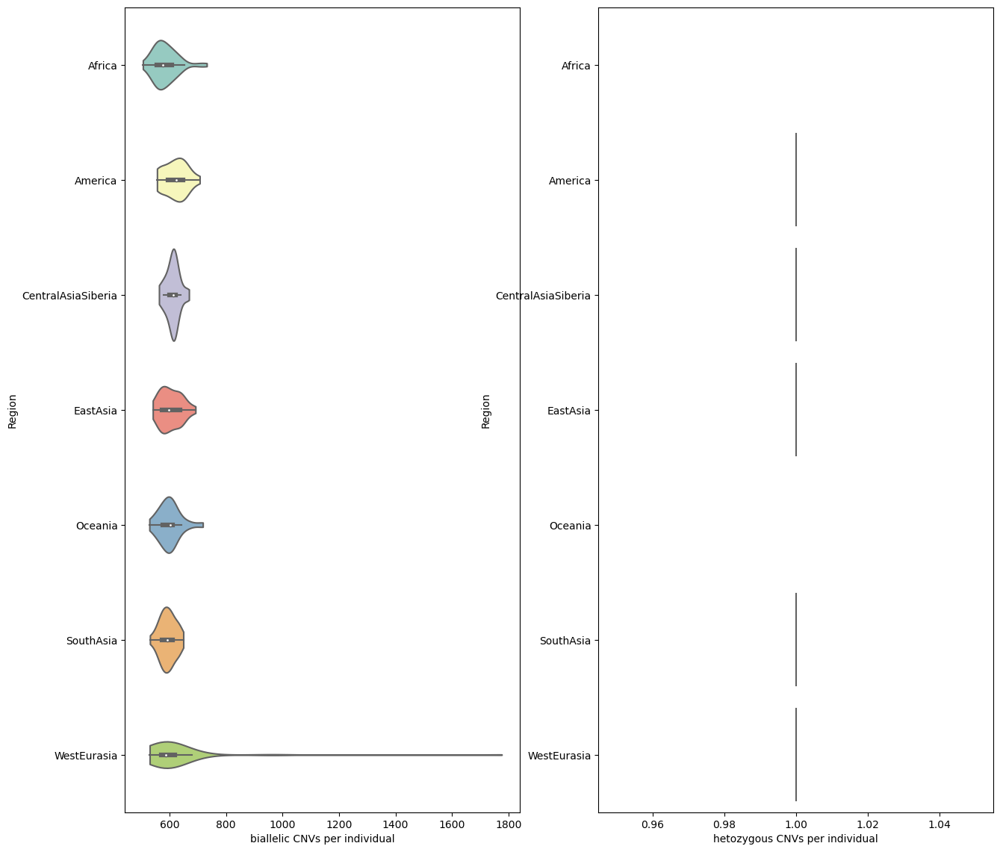

In [25]:
#import seaborn as sns

#pd.set_option("display.max_rows", None, "display.max_columns", None)
biallelic_deletions = deletions[deletions['RD'] < 2 ] 
biallelic_deletions = biallelic_deletions.groupby('Sample_ID').size()

biallelic_deletions = pd.DataFrame(biallelic_deletions)
#biallelic_deletions = biallelic_deletions.set_index('SAMPLE')

biallelic_deletions = features.merge(biallelic_deletions, left_index=True, right_index=True)
#biallelic_deletions = biallelic_deletions.reset_index()

#heterozygous_deletions.value_counts('SAMPLE').sort_index()
biallelic_deletions.columns = ['7-Gender', '10-Region', '11-Country', 'TYPE']
biallelic_deletions


#pd.set_option("display.max_rows", None, "display.max_columns", None)
heterozygous_deletions = deletions[deletions['RD'] > 1] 
heterozygous_deletions = heterozygous_deletions.groupby('Sample_ID').size()
heterozygous_deletions = pd.DataFrame(heterozygous_deletions)
heterozygous_deletions = features.merge(heterozygous_deletions, left_index=True, right_index=True)
heterozygous_deletions.columns = ['7-Gender', '10-Region', '11-Country', 'TYPE']
heterozygous_deletions
heterozygous_deletions


fig, axs = plt.subplots(1, 2, figsize=(15, 14))

ax = seaborn.violinplot(x="TYPE", y="10-Region", data=biallelic_deletions, palette='Set3', order=[ "Africa","America", "CentralAsiaSiberia","EastAsia", "Oceania", "SouthAsia", "WestEurasia"], ax=axs[0], cut=0)

ax.set_xlabel("biallelic CNVs per individual")
ax.set_ylabel("Region")

ax = seaborn.violinplot(x="TYPE", y="10-Region", data=heterozygous_deletions, palette='Set3', order=[ "Africa","America", "CentralAsiaSiberia","EastAsia", "Oceania", "SouthAsia", "WestEurasia"], ax=axs[1], cut=0)

ax.set_xlabel("hetozygous CNVs per individual")
ax.set_ylabel("Region")
plt.show()

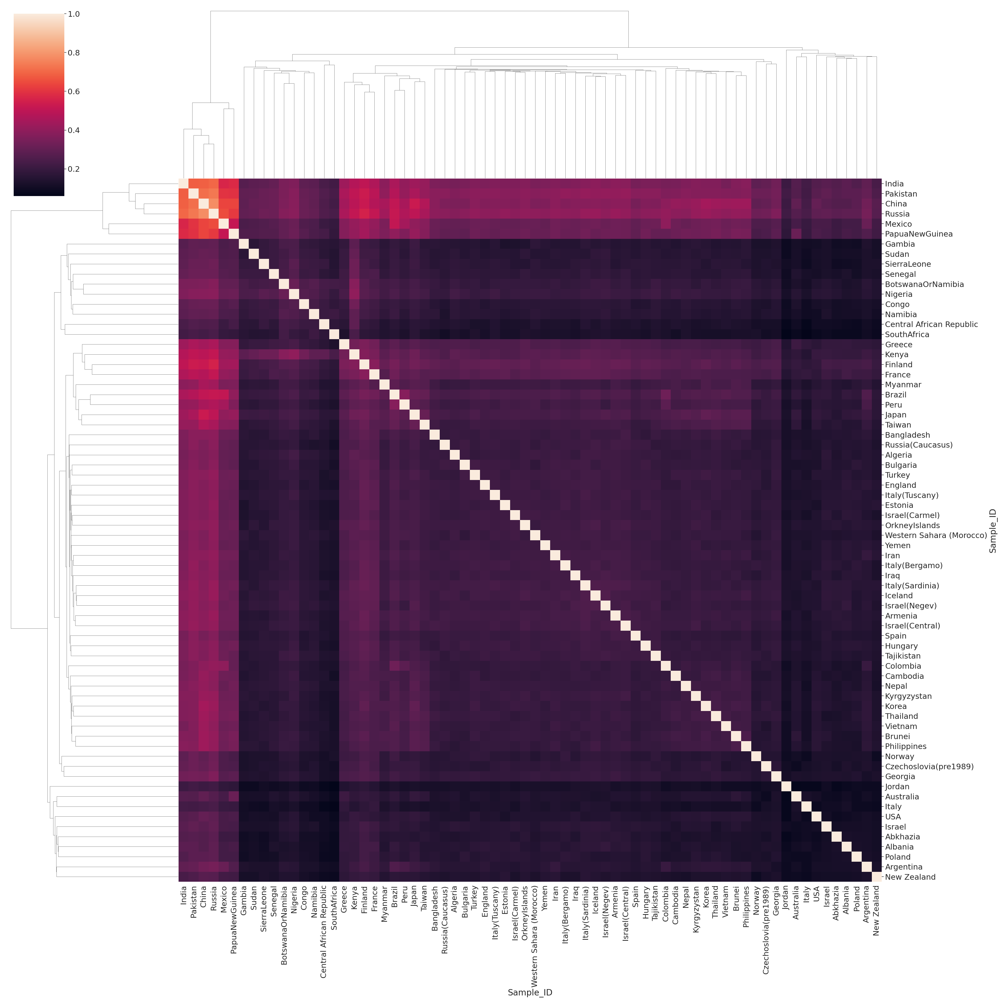

In [26]:
freq = final_cnv.iloc[:,3:283]
freq_input = freq.rename(columns=anotation['11-Country'])
df = freq_input.T

df = df.notnull().groupby(level=0).mean()

seaborn.set(font_scale=2)
corrmatrix = df.T.corr(method='pearson')
seaborn.clustermap(corrmatrix, figsize=(40,40))#, row_colors=row_colors, row_cluster=True, figsize=(40,40))

#plt.savefig('clustermap_countries.pdf')


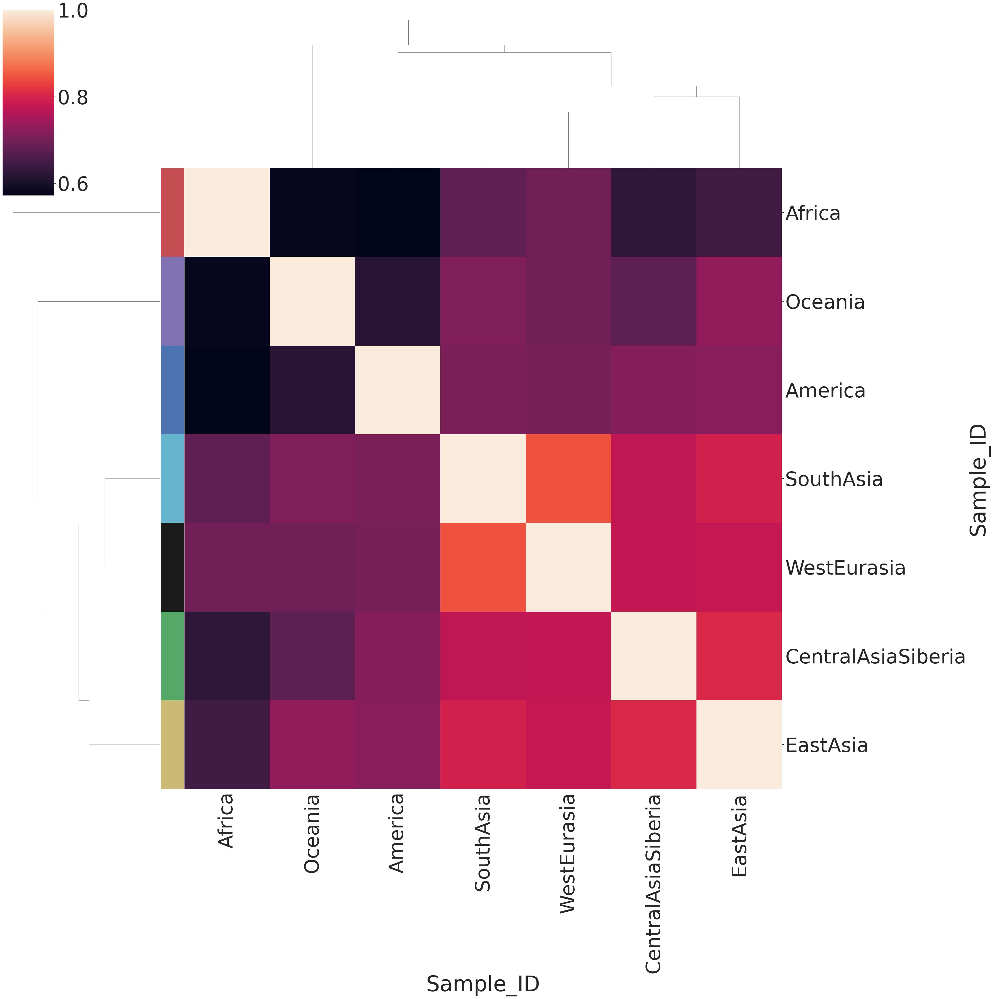

In [27]:
freq = final_cnv.iloc[:,3:283]
freq_input = freq.rename(columns=anotation['10-Region'])
df = freq_input.T
#df = df.reset_index()

#df.groupby('SAMPLE').count().div(df.groupby('SAMPLE').size(),0)


df = df.notnull().groupby(level=0).mean()

df = df.T

lut = dict(zip(df.columns.unique(), "rbgymck"))
lut

seaborn.set(font_scale=5)
corrmatrix = df.corr(method='pearson')
row_colors = df.columns.map(lut)
seaborn.clustermap(corrmatrix, row_colors=row_colors, row_cluster=True, figsize=(40,40))
#plt.savefig('clustermap_regions.pdf')


In [28]:
#imp = SimpleImputer(missing_values=np.nan, strategy='mean')
#x = imp.fit_transform(counts.T)

#track features for pca & tsne
#X = StandardScaler().fit_transform(x)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus),-0.391083,0.399645,4.541992,-0.437044,0.102977,-1.563984,0.059956,0.046980,1.492064,-0.304543
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea,-1.983974,1.109635,-3.545365,3.992802,-2.957737,0.429240,2.141825,1.382511,-1.495550,-0.327840
LP6005441-DNA_A04,F,America,Colombia,-4.480845,1.810892,-3.577153,-7.988289,6.298951,-2.015266,2.968834,-2.291582,-1.153361,-1.171649
LP6005441-DNA_A05,M,WestEurasia,France,1.035061,-0.522757,6.246320,0.212543,-1.017835,-1.024521,0.715576,-0.073019,1.390273,1.789029
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo),0.259485,-0.277735,8.009538,1.266864,0.183167,-1.954209,1.982441,0.336367,-1.317292,-2.324252
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,M,America,Brazil,-0.673057,0.848656,-2.259832,-4.564216,11.924591,5.322708,-6.883549,-4.300164,0.812074,4.088860
SS6004477,M,Oceania,Australia,0.705240,-0.010180,-5.579502,9.414564,8.706612,4.477598,-4.411347,-0.163500,-4.987263,-2.585869
SS6004478,U,Oceania,Australia,0.715118,-1.230858,-4.467401,10.772898,5.124274,4.200900,-7.322891,-1.147787,-1.350168,7.865214
SS6004479,F,America,Mexico,-2.055230,1.352536,-4.175942,-4.308573,10.030089,7.015912,-7.215620,0.820256,2.821869,-3.349420


In [29]:
pca.explained_variance_ratio_

array([0.01247697, 0.0106702 , 0.00906145, 0.00764846, 0.00668669,
       0.00611979, 0.00591146, 0.005471  , 0.00515832, 0.00499184])

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.391083     0.399645     4.541992   
Oceania            F    PapuaNewGuinea    -1.983974     1.109635    -3.545365   
America            F          Colombia    -4.480845     1.810892    -3.577153   
WestEurasia        M            France     1.035061    -0.522757     6.246320   
WestEurasia        M    Italy(Bergamo)     0.259485    -0.277735     8.009538   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.673057     0.848656    -2.259832   
Oceania            M         Australia     0.705240    -0.010180    -5.579502   
Oceania            U         Australia     0.715118    -1.230858    -4.467401   
America            F            Mexico    -2.055230     1.352536    -4.175942   
Africa             M        

Text(0.5, 1.0, 'PCA deletions (archaic genes)')

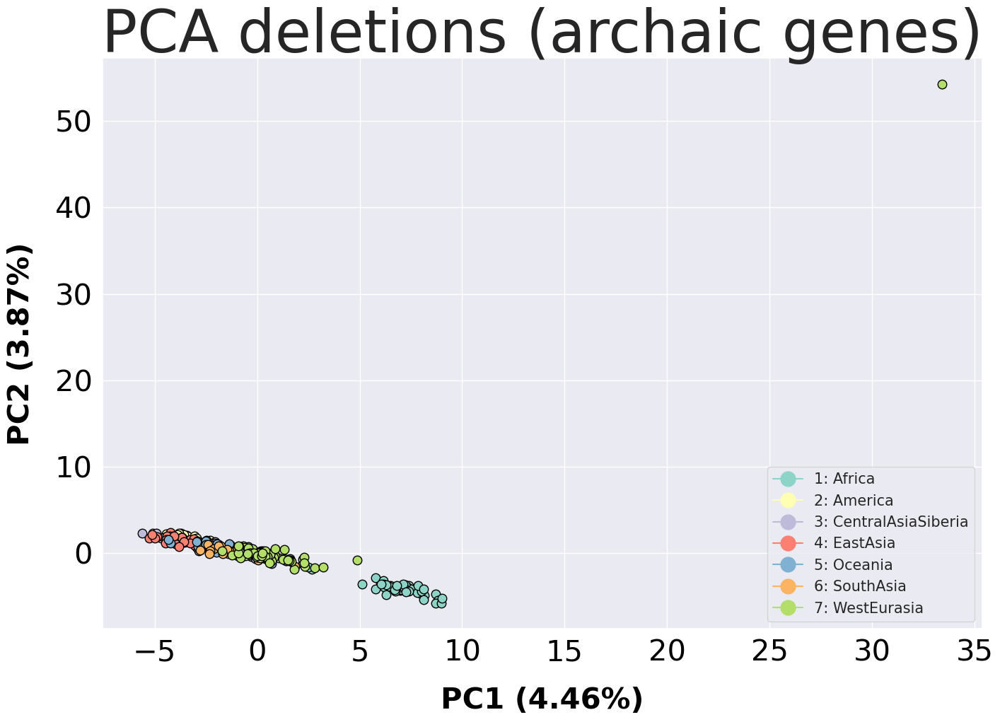

In [32]:
plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC1 (4.46%)', label_vertical='PC2 (3.87%)', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
plt.title("PCA deletions (archaic genes)")
#plt.savefig('pca_deletions.pdf')

                 7-Gender    10-Region  component_1  component_2  component_3  \
11-Country                                                                      
Russia(Caucasus)        M  WestEurasia    -0.391083     0.399645     4.541992   
PapuaNewGuinea          F      Oceania    -1.983974     1.109635    -3.545365   
Colombia                F      America    -4.480845     1.810892    -3.577153   
France                  M  WestEurasia     1.035061    -0.522757     6.246320   
Italy(Bergamo)          M  WestEurasia     0.259485    -0.277735     8.009538   
...                   ...          ...          ...          ...          ...   
Brazil                  M      America    -0.673057     0.848656    -2.259832   
Australia               M      Oceania     0.705240    -0.010180    -5.579502   
Australia               U      Oceania     0.715118    -1.230858    -4.467401   
Mexico                  F      America    -2.055230     1.352536    -4.175942   
Sudan                   M   

Text(0.5, 1.0, 'PCA deletions (archaic genes)')

/opt/spack/opt/spack/linux-rhel8-icelake/gcc-8.4.1/anaconda3-2021.05-fmo625scqdt32etnaksoexe3rd6sea7j/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  fig.canvas.print_figure(bytes_io, **kw)


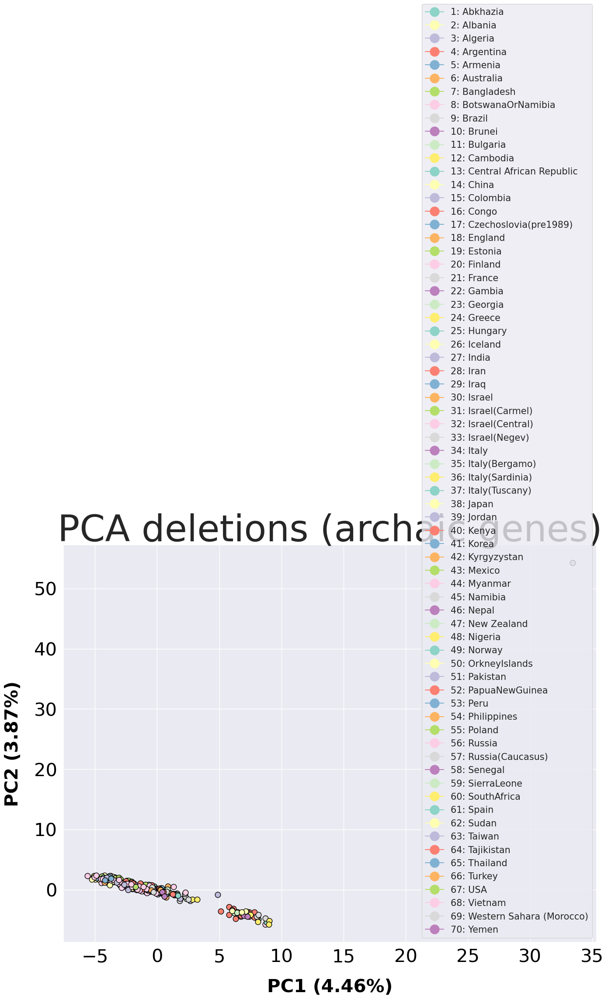

In [33]:
plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC1 (4.46%)', label_vertical='PC2 (3.87%)', factor='11-Country', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
plt.title("PCA deletions (archaic genes)")
#plt.savefig('pca_deletions_countries.pdf')

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.391083     0.399645     4.541992   
Oceania            F    PapuaNewGuinea    -1.983974     1.109635    -3.545365   
America            F          Colombia    -4.480845     1.810892    -3.577153   
WestEurasia        M            France     1.035061    -0.522757     6.246320   
WestEurasia        M    Italy(Bergamo)     0.259485    -0.277735     8.009538   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.673057     0.848656    -2.259832   
Oceania            M         Australia     0.705240    -0.010180    -5.579502   
Oceania            U         Australia     0.715118    -1.230858    -4.467401   
America            F            Mexico    -2.055230     1.352536    -4.175942   
Africa             M        

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


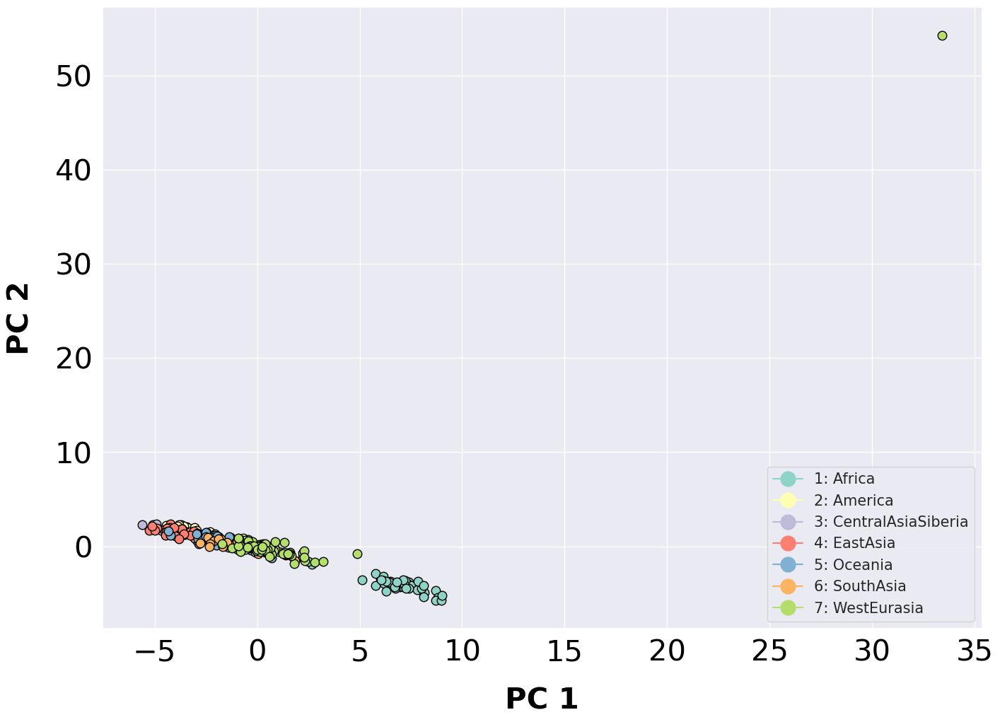

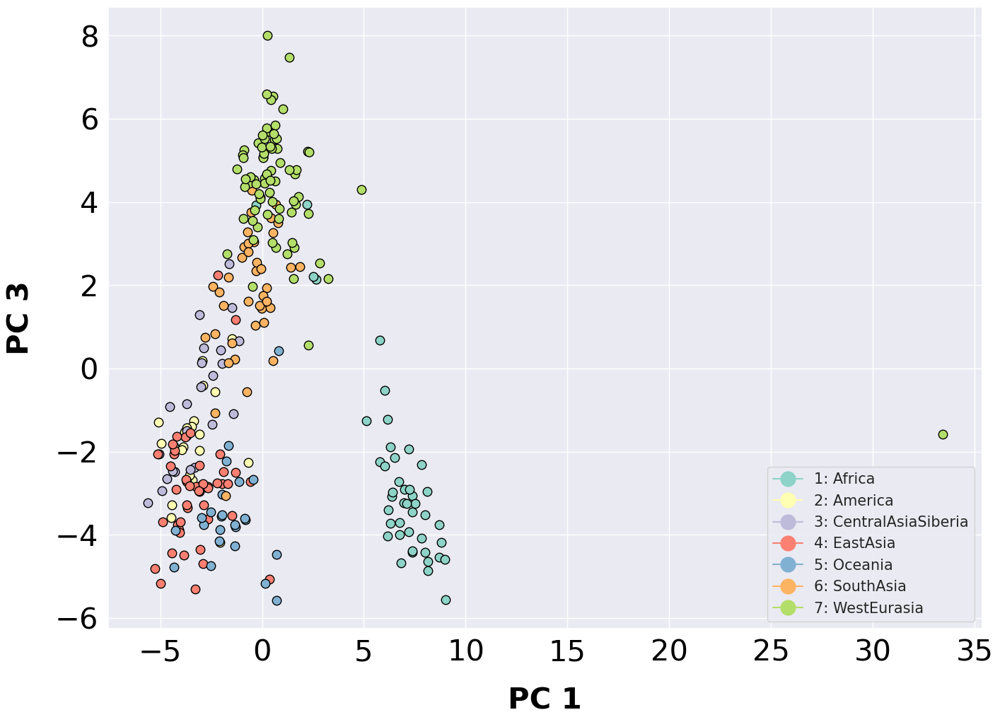

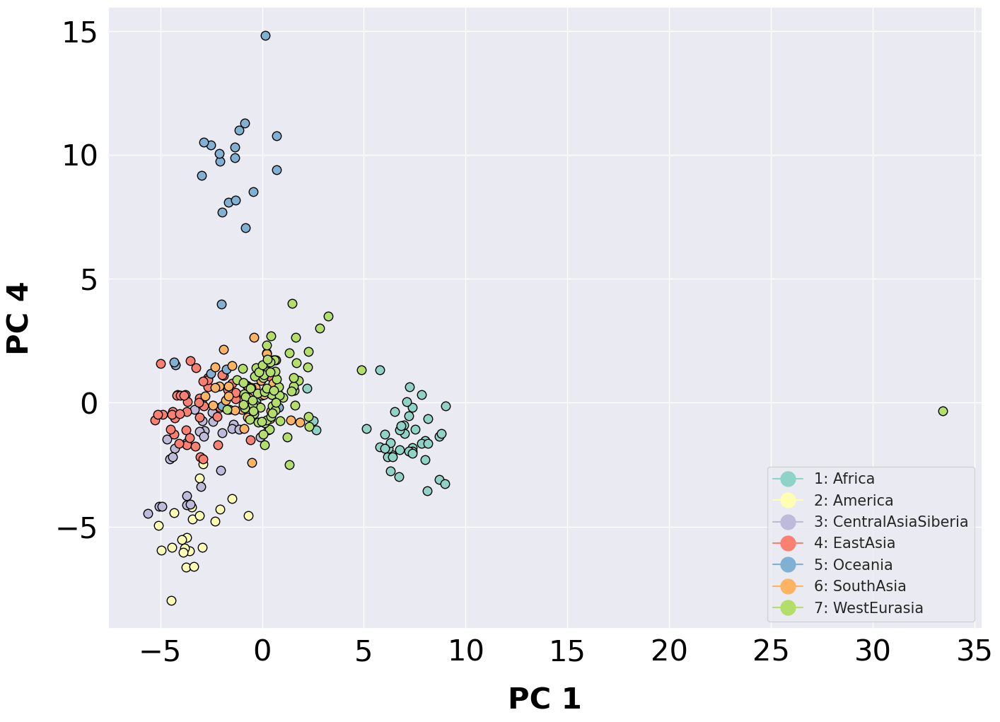

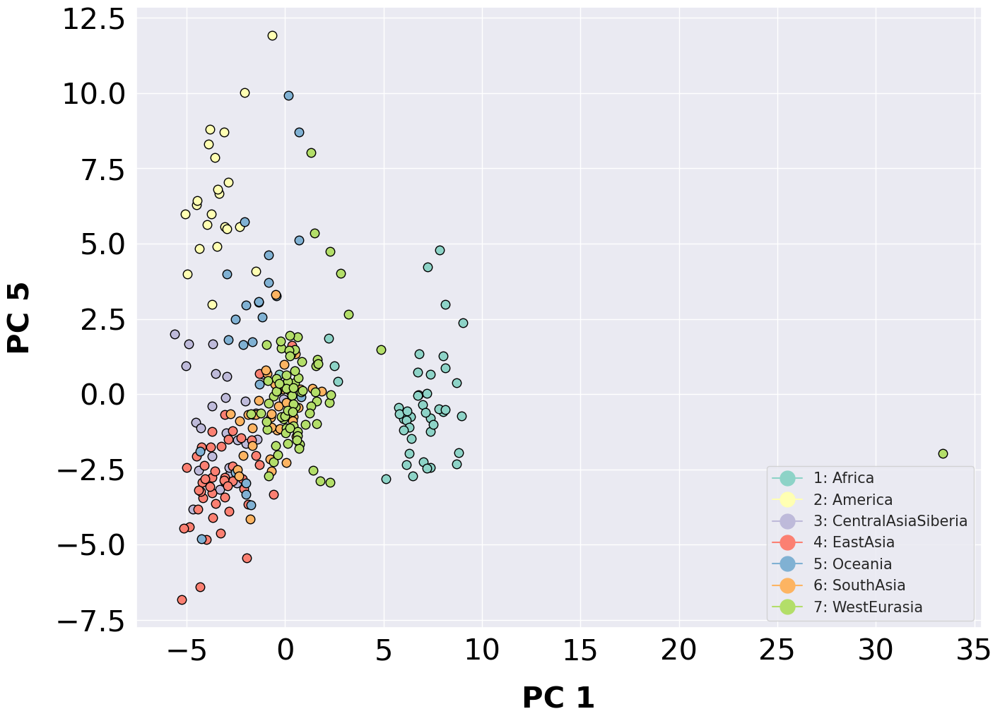

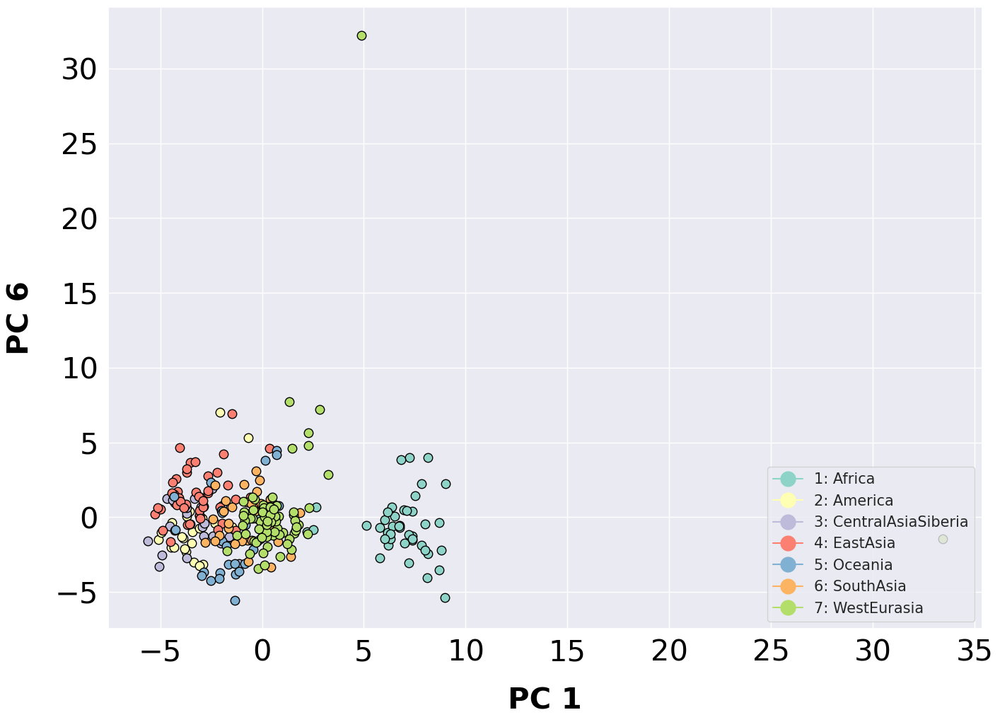

...

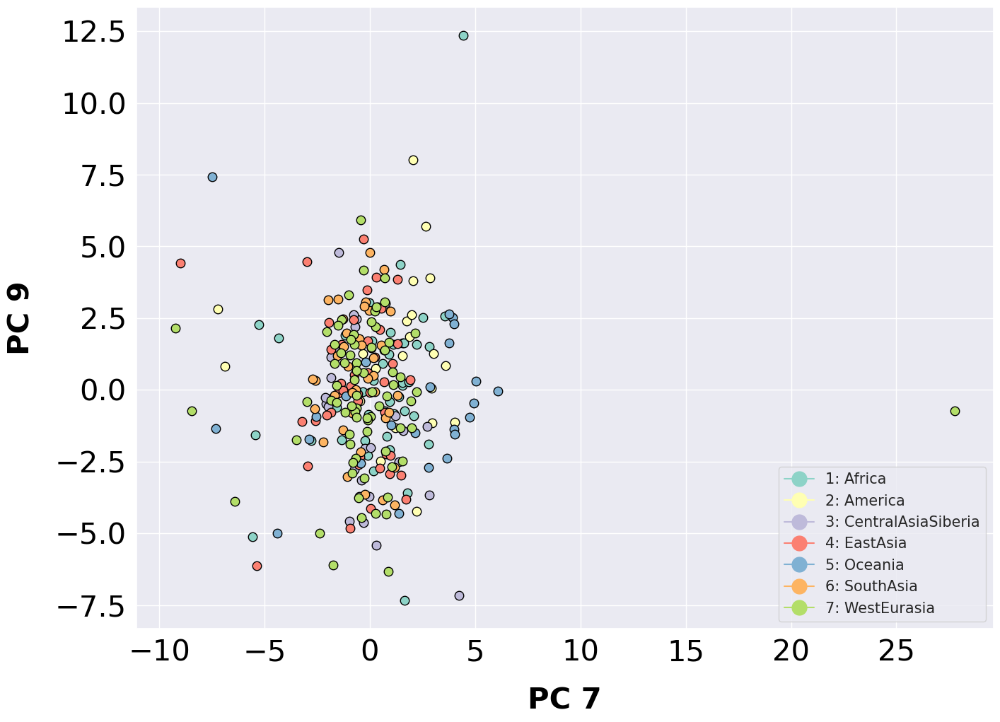

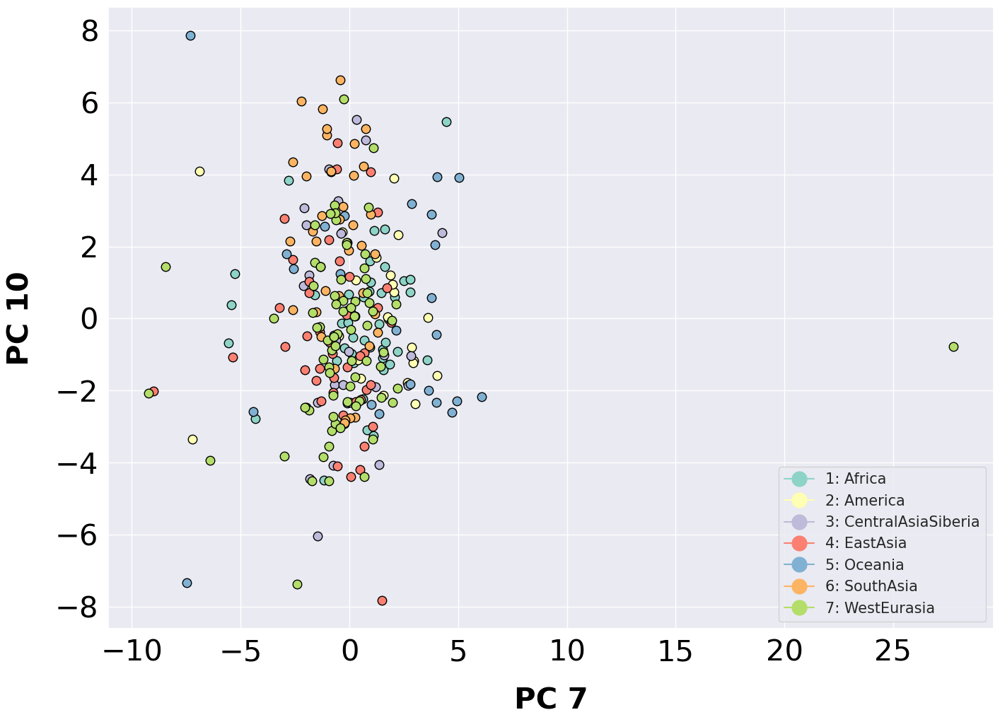

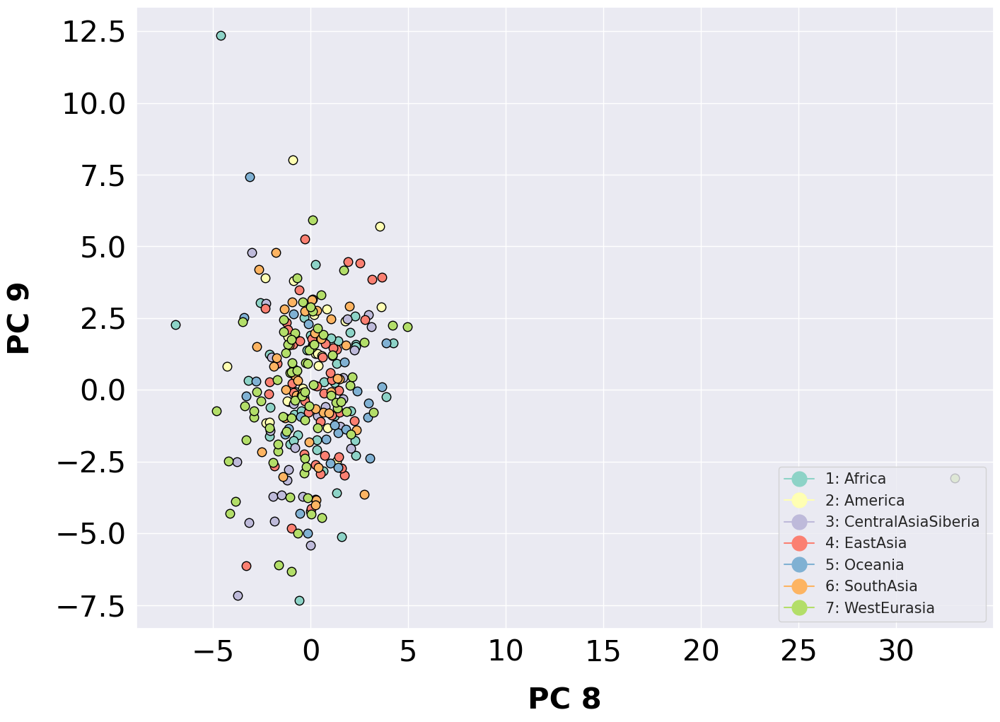

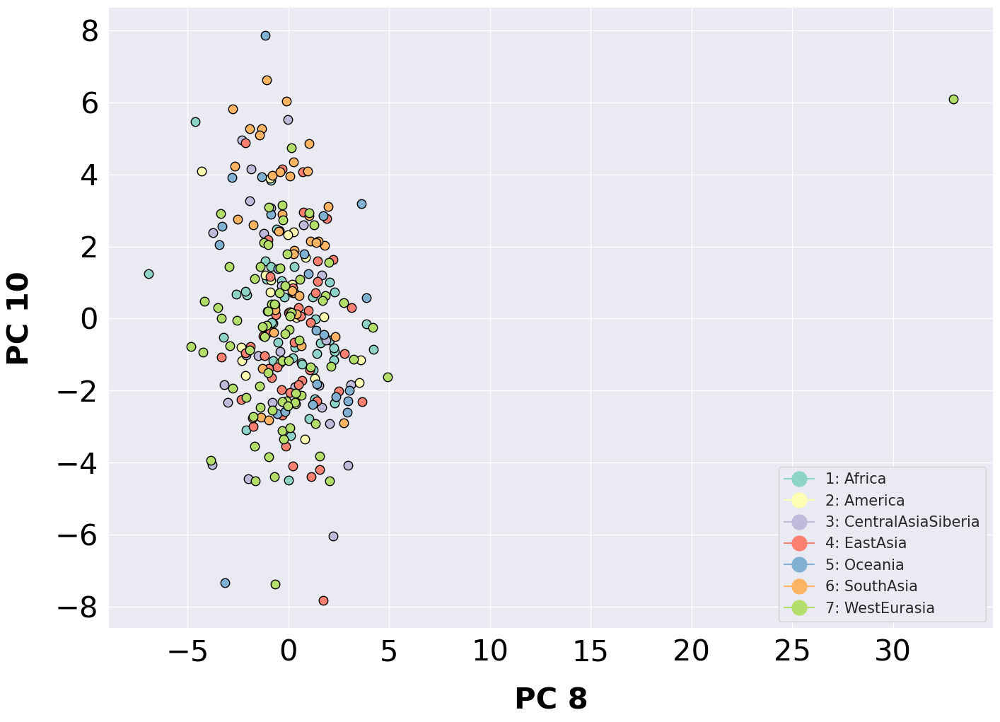

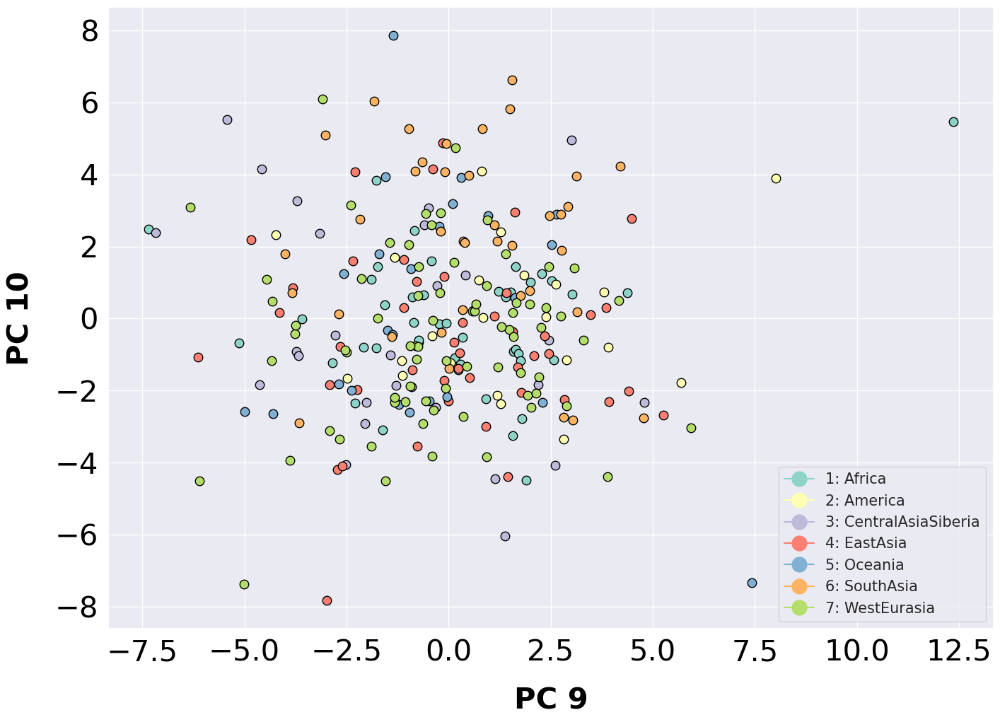

In [34]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [35]:
## DUPLICATIONS

In [37]:
final_cnv = duplications.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_duplications = final_cnv.iloc[:,4:284]
counts_duplications = final_duplications
counts_duplications = counts_duplications.fillna(2)


#counts = counts[counts.columns.intersection(counts_a.columns)]
#counts = counts.drop(columns=['LP6005592-DNA_G03',
#                     'LP6005443-DNA_E10',
#                     'LP6005442-DNA_E04'])


counts_duplications = counts_duplications.T
counts_duplications = counts_duplications.sort_index()


features_duplications = anotation.merge(counts_duplications, left_index=True, right_index=True)
features_duplications = features_duplications.loc[:,["7-Gender","10-Region", "11-Country",]]
features_duplications = features_duplications.sort_index()
features_duplications


,7-Gender,10-Region,11-Country
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,F,America,Colombia
LP6005441-DNA_A05,M,WestEurasia,France
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo)
LP6005441-DNA_A08,M,Africa,Congo
...,...,...,...
SS6004476,M,America,Brazil
SS6004477,M,Oceania,Australia
SS6004478,U,Oceania,Australia
SS6004479,F,America,Mexico


In [38]:
#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts_duplications)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features_duplications.index)




df_pca = features_duplications.merge(df_pca, left_index=True, right_index=True)
pca.explained_variance_ratio_

array([0.08596231, 0.05382916, 0.03718016, 0.02752539, 0.02203545,
       0.0200666 , 0.01883749, 0.0163119 , 0.01554593, 0.01463615])

            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340467    -0.834025   
America            F        Colombia    -0.393125    -4.738392    -0.449193   
WestEurasia        M          France    -1.252207     5.991516    -0.055160   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984452     0.679682   
Africa             M           Congo    -2.094010    17.023110    -1.516999   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486307    -0.701936   
Oceania            M       Australia    -0.094900    -3.406952     0.573689   
Oceania            U       Australia    -0.086403    -4.128626     0.494580   
America            F          Mexico    -0.059402    -2.805856     1.252535   
Africa             M           Sudan    -2.035247   

Text(0.5, 1.0, 'PCA duplications (archaic genes)')

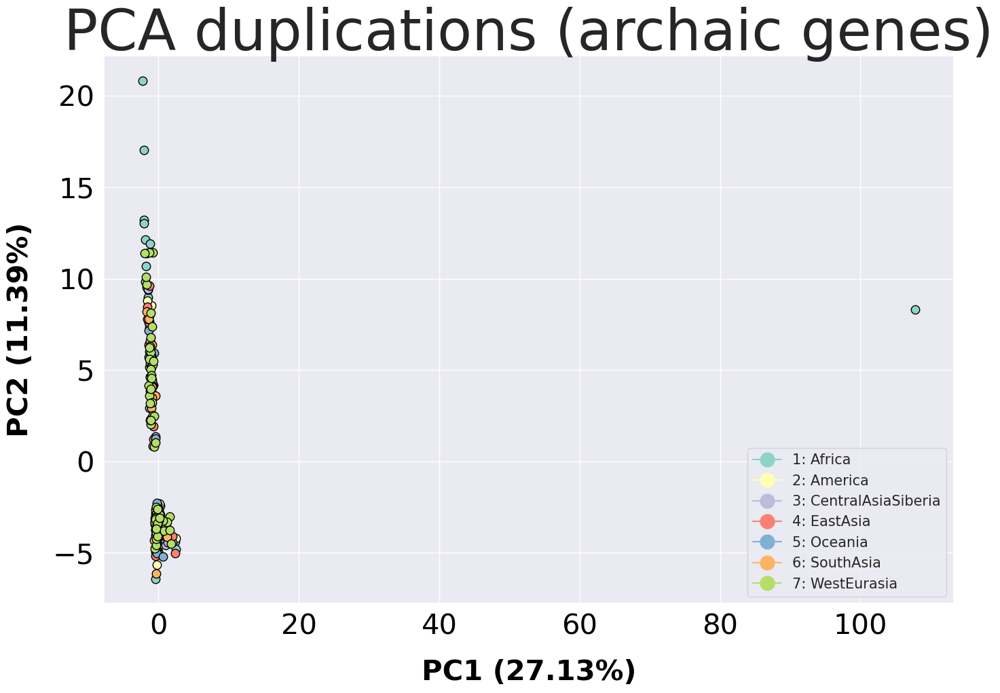

In [39]:
d = plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC1 (27.13%)', label_vertical='PC2 (11.39%)', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
plt.title("PCA duplications (archaic genes)")
#plt.savefig('pca_duplications.pdf')

            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340467    -0.834025   
America            F        Colombia    -0.393125    -4.738392    -0.449193   
WestEurasia        M          France    -1.252207     5.991516    -0.055160   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984452     0.679682   
Africa             M           Congo    -2.094010    17.023110    -1.516999   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486307    -0.701936   
Oceania            M       Australia    -0.094900    -3.406952     0.573689   
Oceania            U       Australia    -0.086403    -4.128626     0.494580   
America            F          Mexico    -0.059402    -2.805856     1.252535   
Africa             M           Sudan    -2.035247   

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


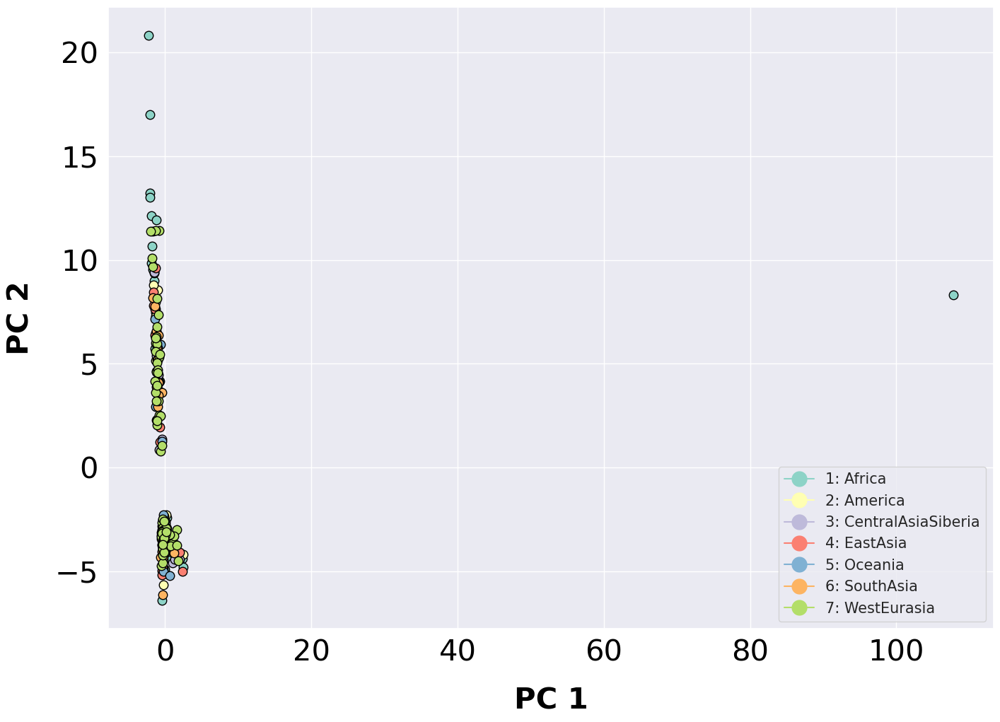

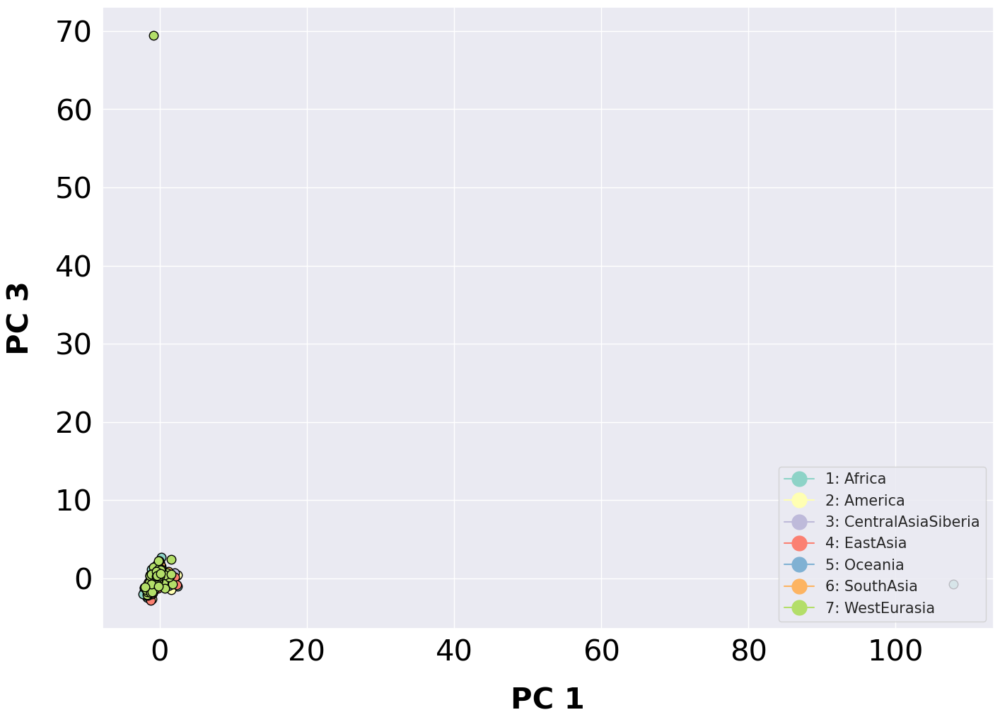

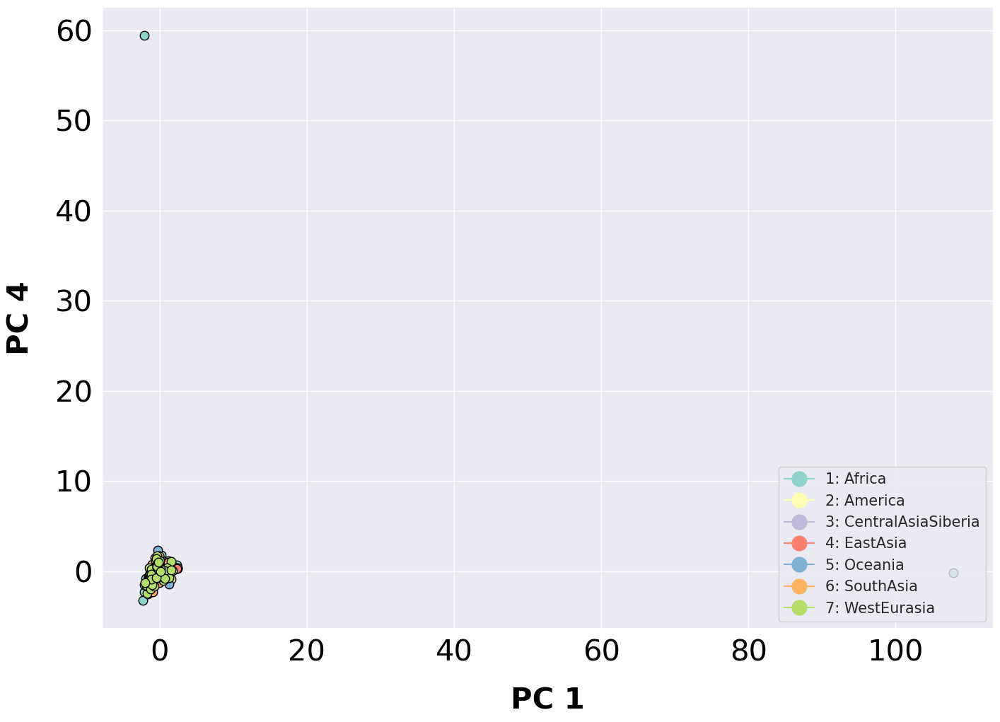

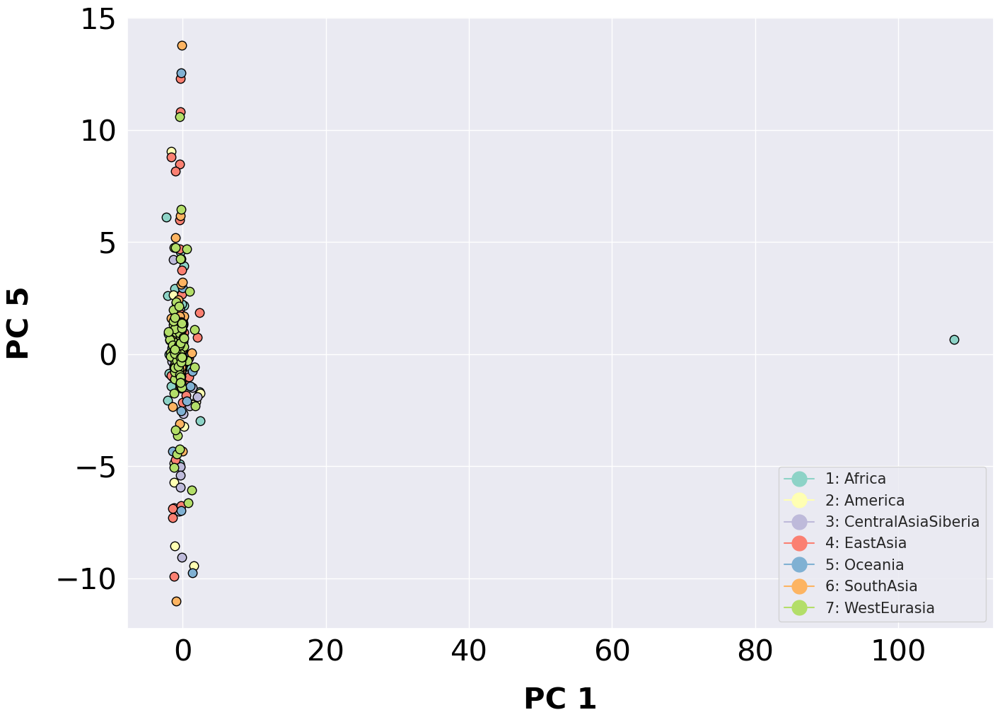

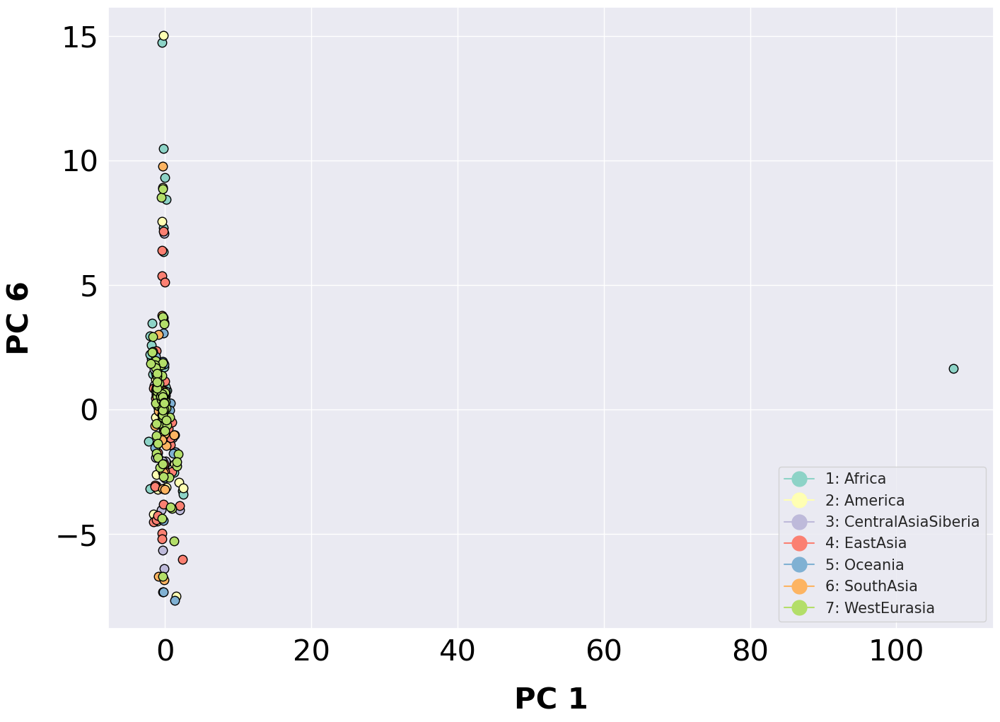

...

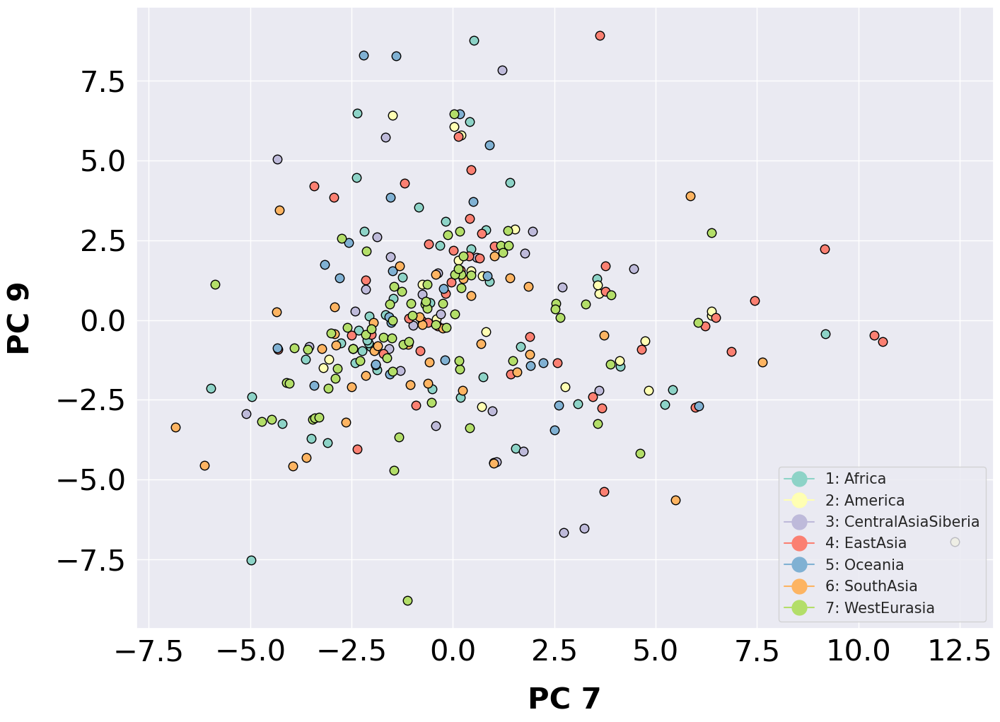

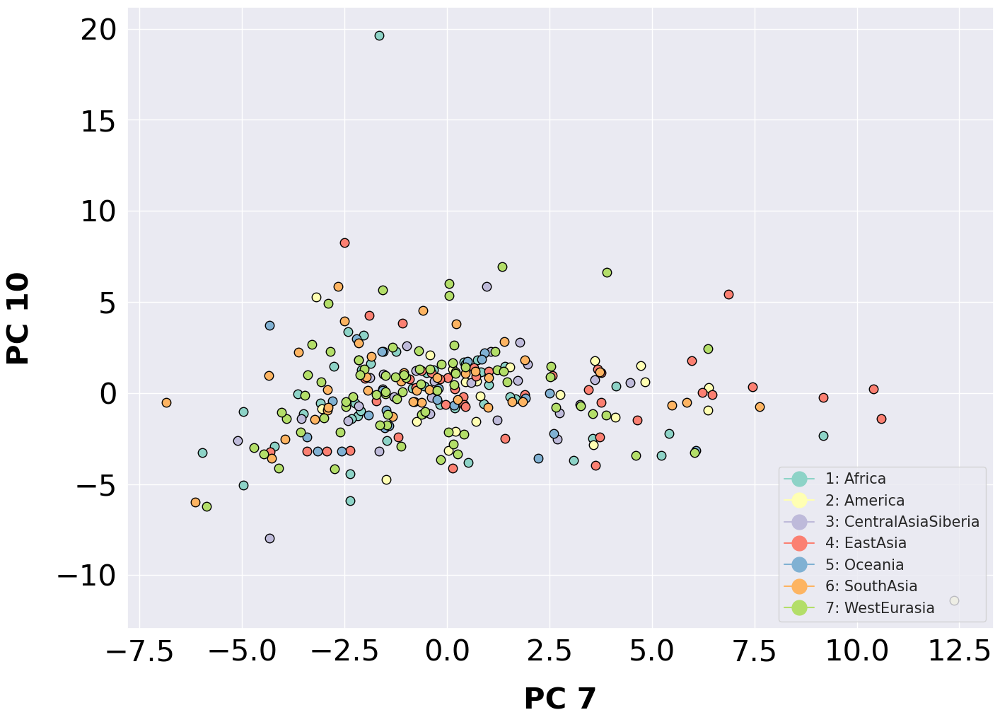

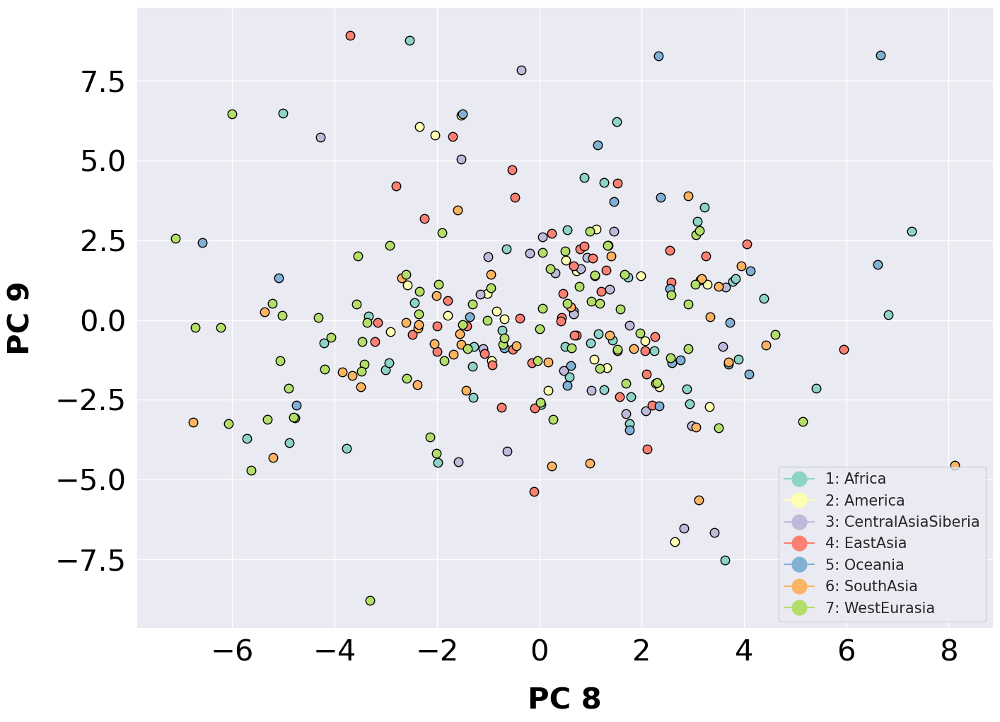

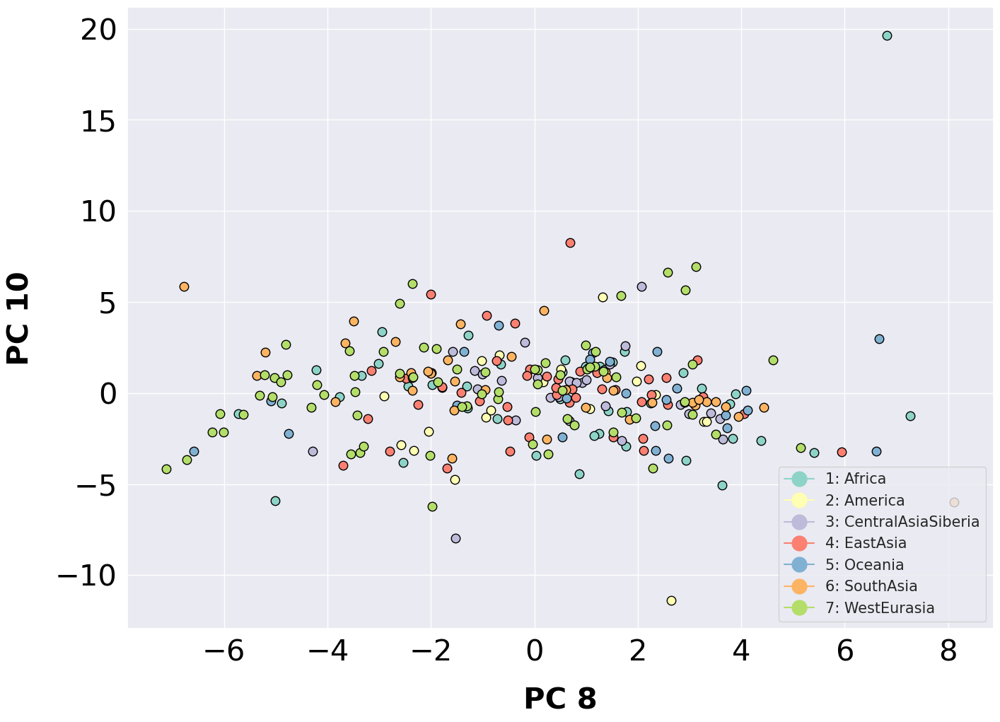

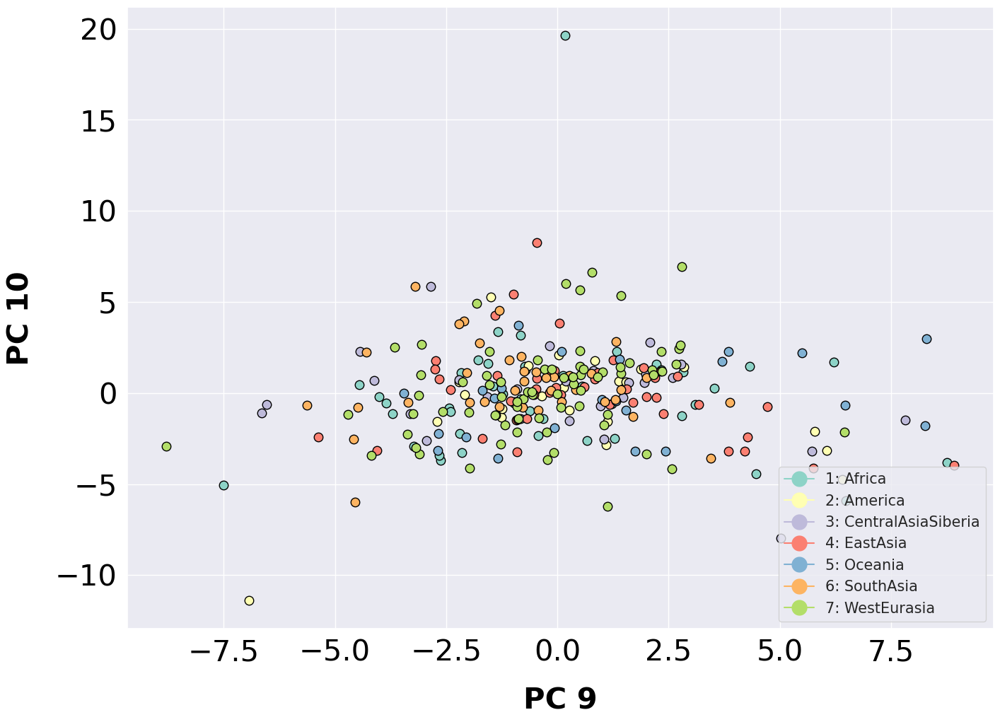

In [40]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h1> Studmant Data

In [79]:
header= ['Sample', 'Region', 'Country', 'Sample_ID', 'Sex']
studmant_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore//branchinecta/jbazanwilliamson/Studmant_anotation.csv', names=header, index_col=0)#Studmant data

studmant_data = pd.read_csv('/home/jbazanwilliamson/borgstore//branchinecta/jbazanwilliamson/Studmant_cnvs.csv')
studmant_data['contig'] = studmant_data['contig'].str.replace('chr', '')
studmant_data

n_uncalled = np.sum(studmant_data==-1,1)
studmant_data = studmant_data[n_uncalled==0]
studmant_data

studmant_anotation

,Region,Country,Sample_ID,Sex
Sample,,,,
AFR_BantuKenya_HGDP01414_F,AFR,BantuKenya,HGDP01414,F
AFR_BantuKenya_HGDP01417_M,AFR,BantuKenya,HGDP01417,M
AFR_BantuSEHerero_HGDP01028_M,AFR,BantuSEHerero,HGDP01028,M
AFR_BantuSEHerero_HGDP01035_M,AFR,BantuSEHerero,HGDP01035,M
AFR_BantuSETswana_HGDP01030_M,AFR,BantuSETswana,HGDP01030,M
...,...,...,...,...
WEA_SpainIBS_HG01504_F,WEA,SpainIBS,HG01504,F
WEA_Tuscan_HGDP01163_M,WEA,Tuscan,HGDP01163,M
WEA_Tuscan_HGDP01168_F,WEA,Tuscan,HGDP01168,F


In [80]:
#Subsetting deletions 
#studmant_data = studmant_data[studmant_data['bi-allelic'] == True] 
deletions = studmant_data[studmant_data['type'] == "DEL"] 
counts = deletions.iloc[:,6:283]
X = counts.T
X = X.sort_index()
X

,2,3,6,7,13,47,48,49,50,51,...,14998,14999,15001,15002,15005,15006,15007,15008,15010,15011
AFR_BantuKenya_HGDP01414_F,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
AFR_BantuKenya_HGDP01417_M,2,2,2,2,2,2,2,2,2,0,...,1,2,1,2,1,1,1,1,1,1
AFR_BantuSEHerero_HGDP01028_M,1,2,2,2,2,2,2,2,2,2,...,1,2,1,2,1,1,1,1,1,1
AFR_BantuSEHerero_HGDP01035_M,2,2,2,2,2,2,2,2,2,1,...,1,2,1,2,1,1,1,1,1,1
AFR_BantuSETswana_HGDP01030_M,2,2,1,2,2,2,2,2,2,1,...,1,2,1,2,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WEA_SpainIBS_HG01504_F,2,2,2,2,2,2,2,2,2,1,...,2,2,2,2,2,2,2,2,2,2
WEA_Tuscan_HGDP01163_M,2,2,2,2,2,2,2,2,2,2,...,1,2,1,2,1,1,1,1,1,1
WEA_Tuscan_HGDP01168_F,2,2,2,2,2,2,2,2,2,1,...,2,2,2,2,2,2,2,2,2,2
WEA_YemeniteJew_4695_F,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2


explained variance ratio (first four components): [0.19544748 0.05440631 0.03412876 0.02418402]


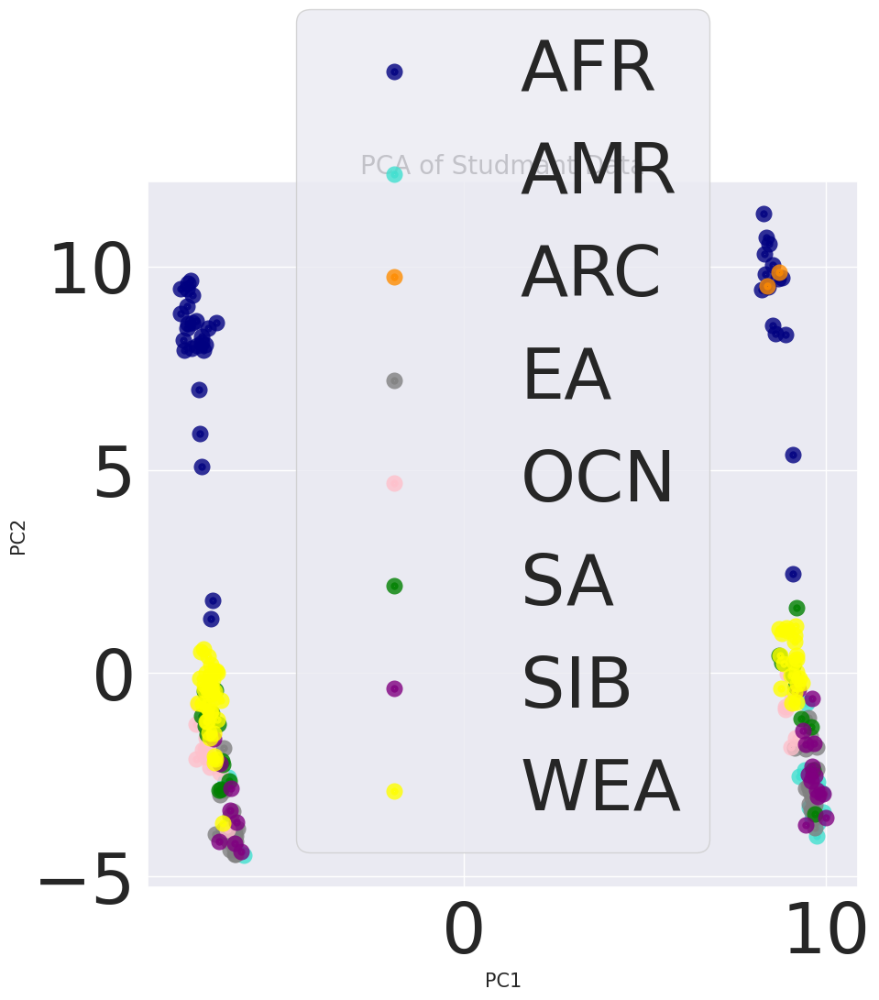

In [81]:
features = studmant_anotation.merge(X, left_index=True, right_index=True)
features = features.loc[:,["Region", "Country"]]

y = features.Region.astype('category').cat.codes
target_names = np.array(['AFR', 'AMR', 'ARC', 'EA', 'OCN', 'SA', 'SIB', 'WEA'])#list(X.index)


pca = PCA(n_components=4)
X_r = pca.fit(X).transform(X)

# Percentage of variance explained for each components
print(
    "explained variance ratio (first four components): %s"
    % str(pca.explained_variance_ratio_)
)


plt.figure(figsize=(10, 10))

colors = ["navy", "turquoise", "darkorange", "gray", "pink", "green", "purple", "yellow"]
lw = 7

for color, i, target_name in zip(colors, [0,1,2,3,4,5,6,7], target_names):
    plt.scatter(
        X_r[y == i, 0], X_r[y == i, 1], color=color, alpha=0.8, lw=lw, label=target_name
    )
plt.legend(loc="best", shadow=False, scatterpoints=1)
plt.title("PCA of Studmant Data", fontsize=20)
plt.xlabel('PC1', fontsize=15)
plt.ylabel('PC2', fontsize=15)

plt.show()


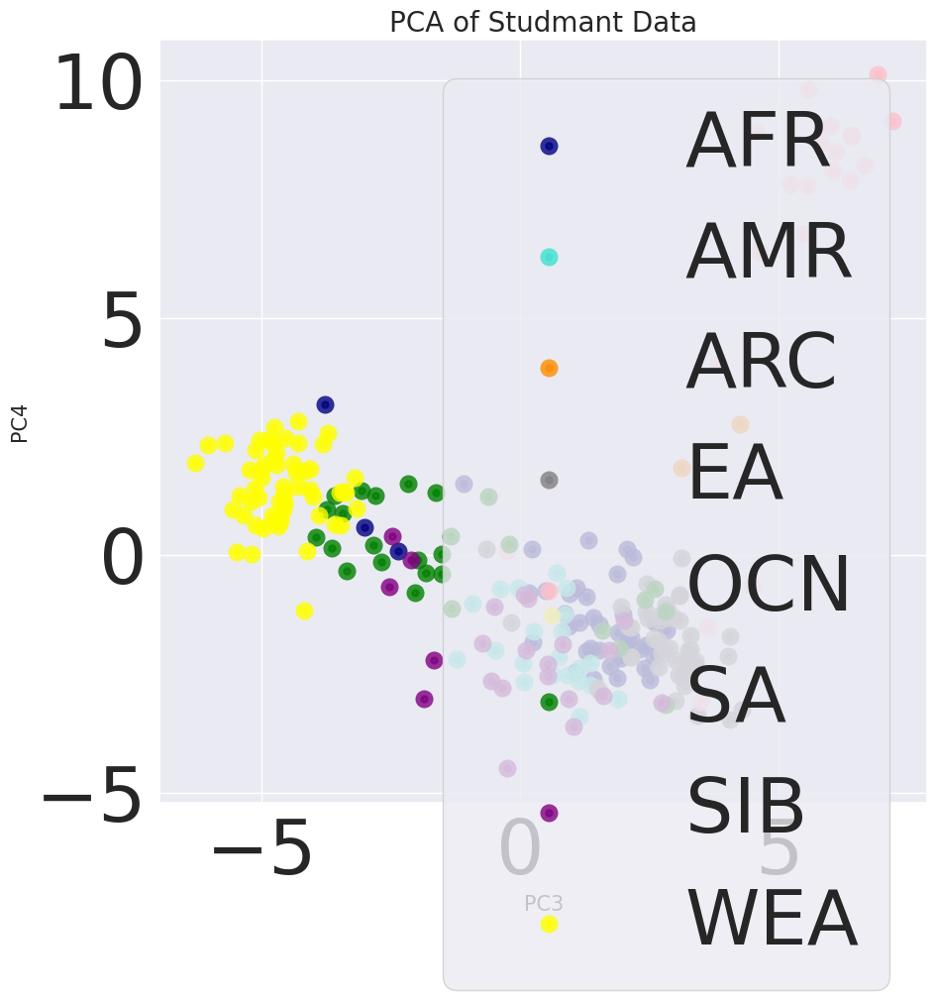

In [82]:
plt.figure(figsize=(10, 10))
colors = ["navy", "turquoise", "darkorange", "gray", "pink", "green", "purple", "yellow"]
lw = 7

for color, i, target_name in zip(colors, [0,1,2,3,4,5,6,7], target_names):
    plt.scatter(
        X_r[y == i, 2], X_r[y == i, 3], color=color, alpha=0.8, lw=lw, label=target_name
    )
plt.legend(loc="best", shadow=False, scatterpoints=1)
plt.title("PCA of Studmant Data", fontsize=20)
plt.xlabel('PC3', fontsize=15)
plt.ylabel('PC4', fontsize=15)
plt.show()


In [90]:
count = counts.T
features = studmant_anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["Region", "Country"]]

#imputation and normalization 
#imp = SimpleImputer(missing_values=np.nan, strategy='mean')
#X = imp.fit_transform(counts.T)
#x = StandardScaler().fit_transform(counts.T)

#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts.T)

#pca = PCA(n_components=10)
#pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)

df_pca = features.merge(df_pca, left_index=True, right_index=True)


In [91]:
pca.explained_variance_ratio_

array([0.19544748, 0.05440631, 0.03412876, 0.02418402, 0.01688253,
       0.01357949, 0.01003279, 0.00851302, 0.00730657, 0.00663845])

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645046     0.121758   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375330   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213548   
AFR     BantuSEHerero     9.078236     5.380755    -1.094737     1.510423   
AFR     BantuSETswana    -7.661655     8.481486     1.353043    -1.949370   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048446     8.117159   
WEA            Tuscan    -7.140537    -2.064879     6.661012     8.210497   
WEA            Tuscan    -7.174189    -0.384488    -4.667761     1.127802   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688520     0.604952   
WEA       YemeniteJew    -7.156184    -1.286642    -1.511111    -0.392288   

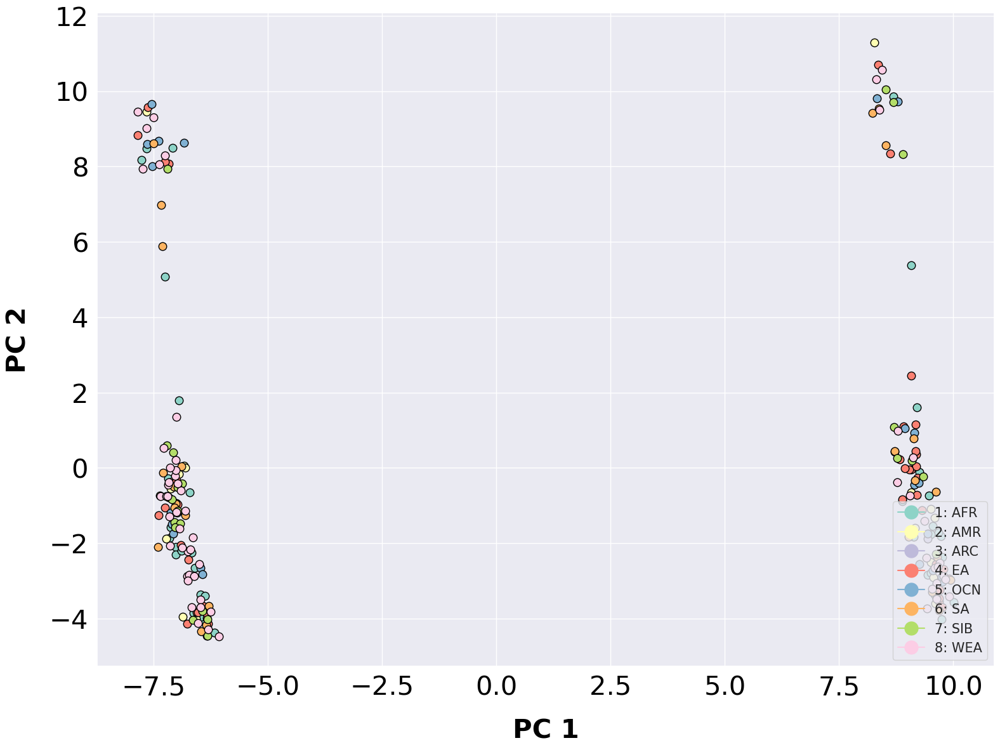

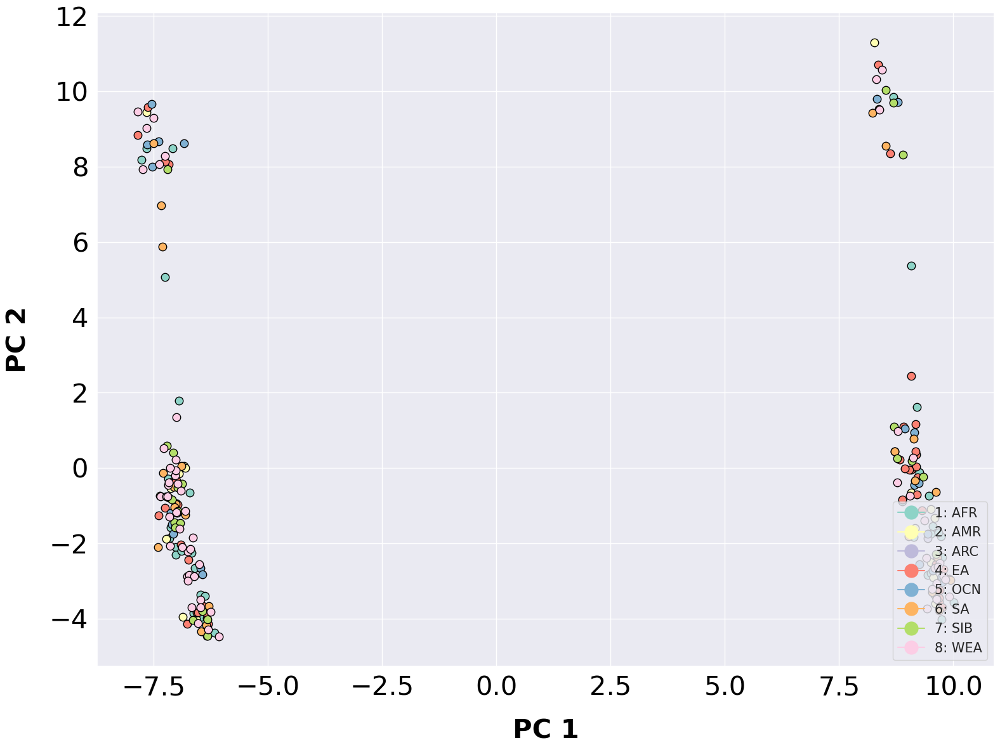

In [92]:
plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC 1', label_vertical='PC 2', factor='Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645046     0.121758   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375330   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213548   
AFR     BantuSEHerero     9.078236     5.380755    -1.094737     1.510423   
AFR     BantuSETswana    -7.661655     8.481486     1.353043    -1.949370   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048446     8.117159   
WEA            Tuscan    -7.140537    -2.064879     6.661012     8.210497   
WEA            Tuscan    -7.174189    -0.384488    -4.667761     1.127802   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688520     0.604952   
WEA       YemeniteJew    -7.156184    -1.286642    -1.511111    -0.392288   

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


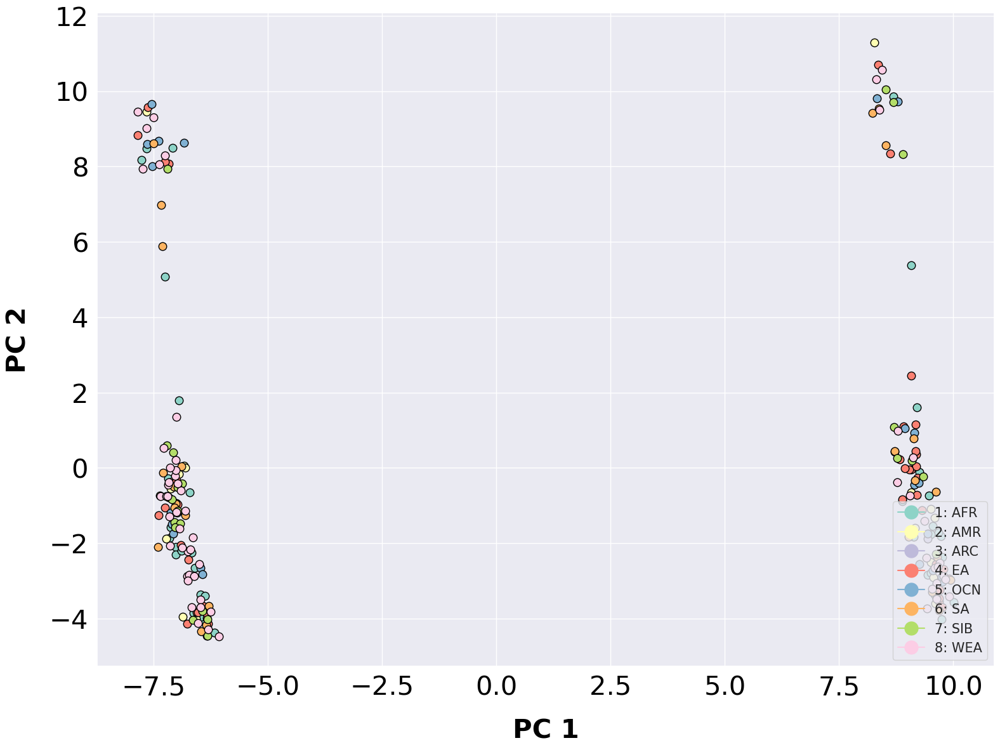

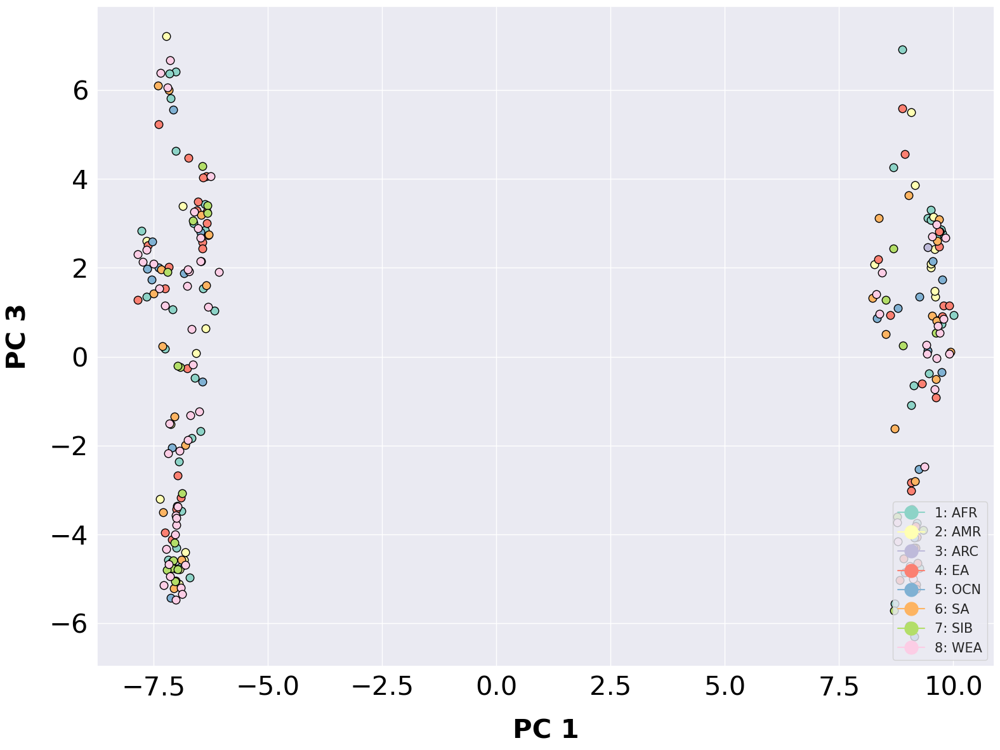

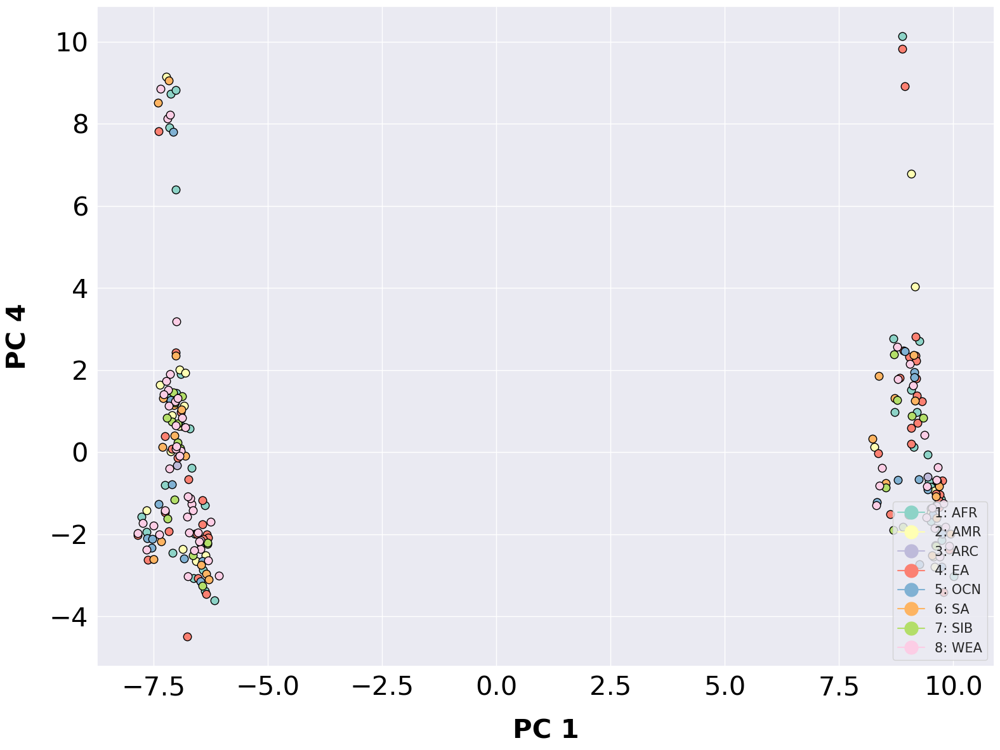

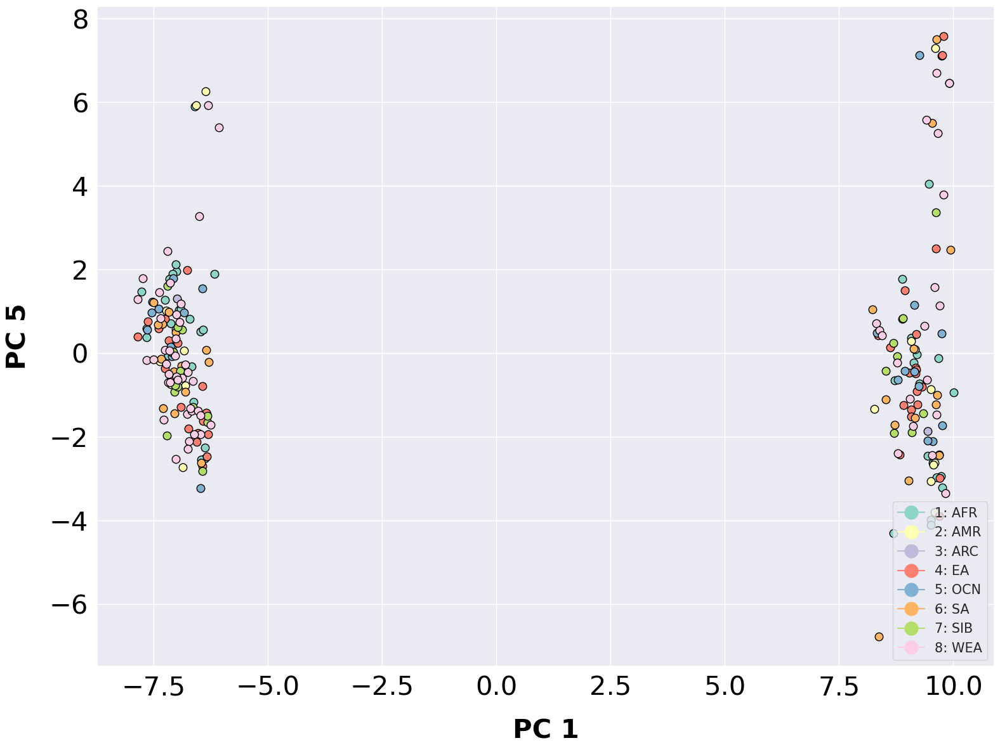

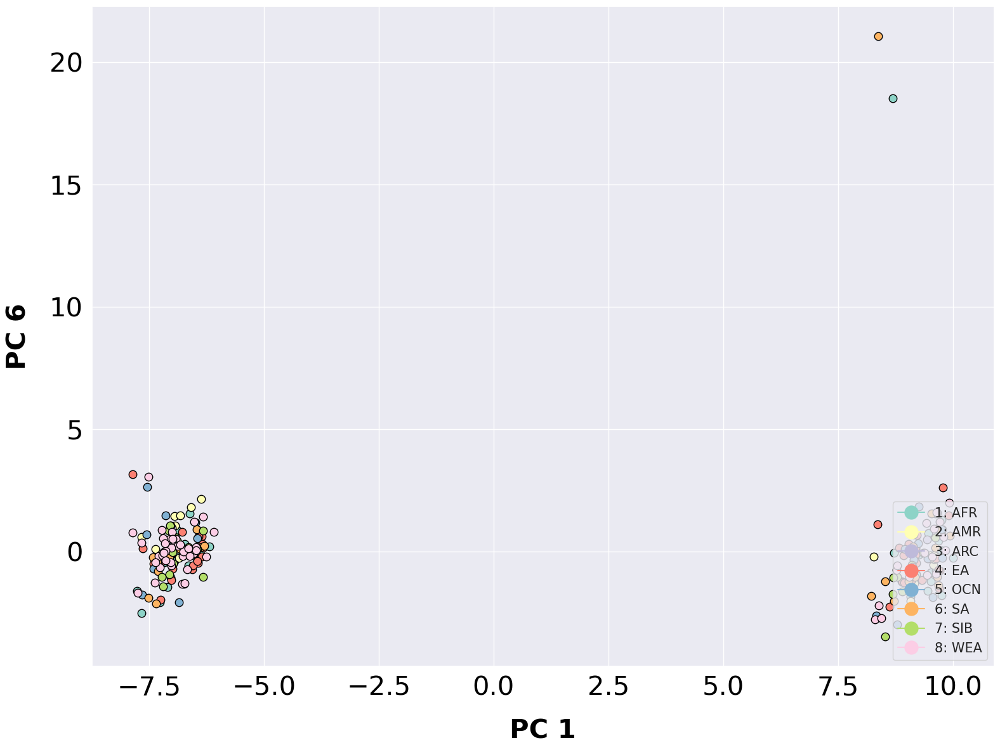

...

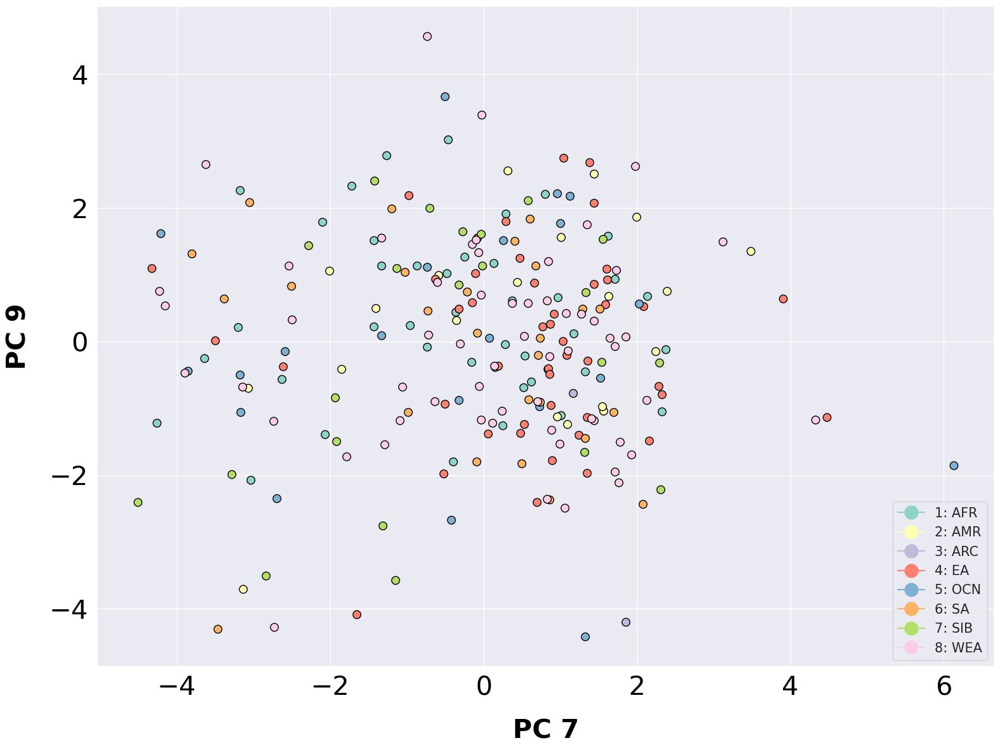

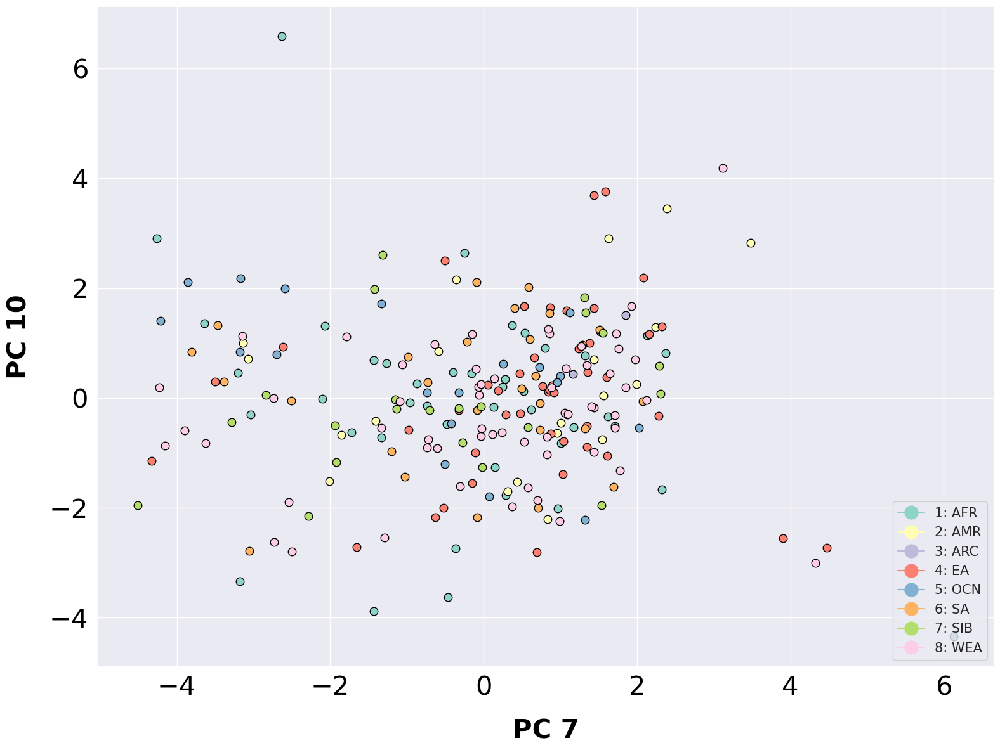

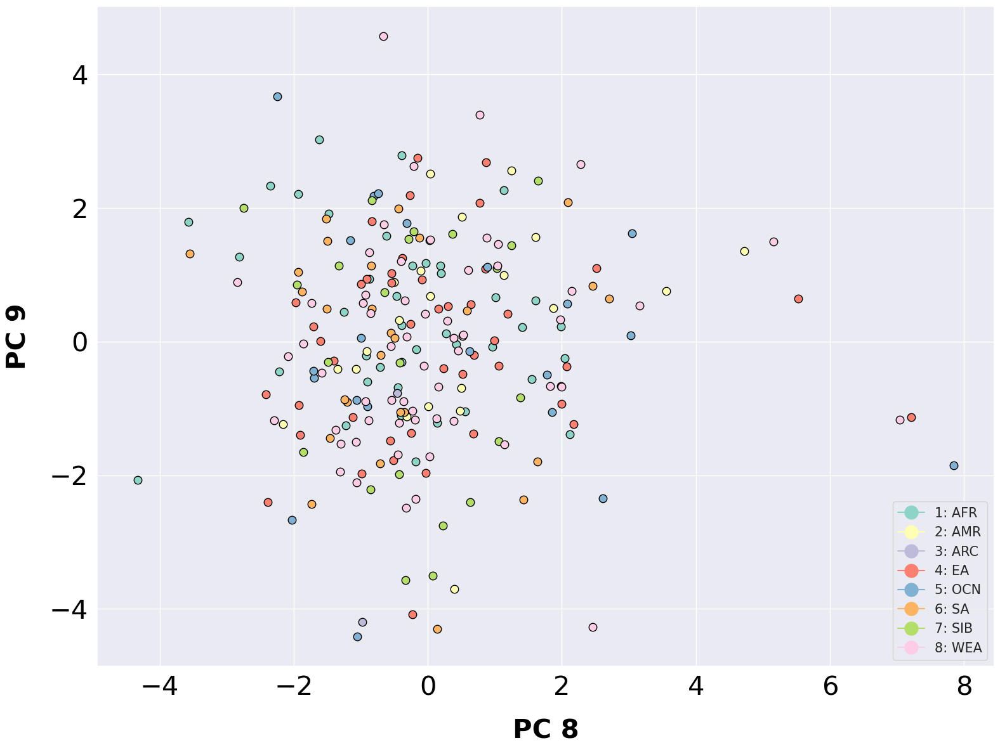

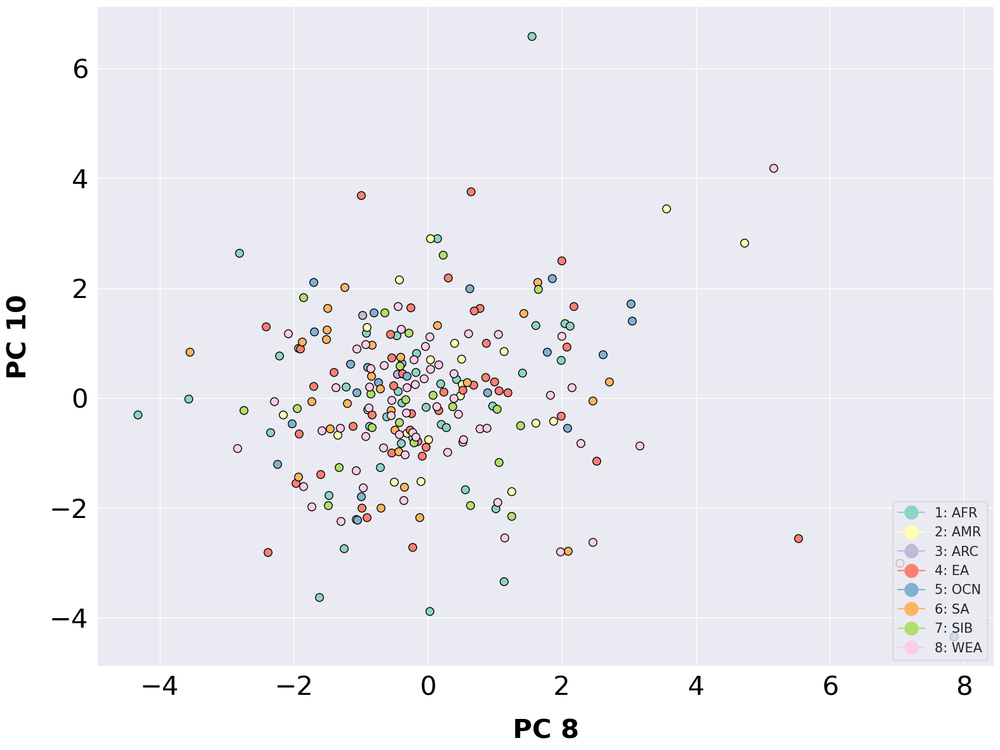

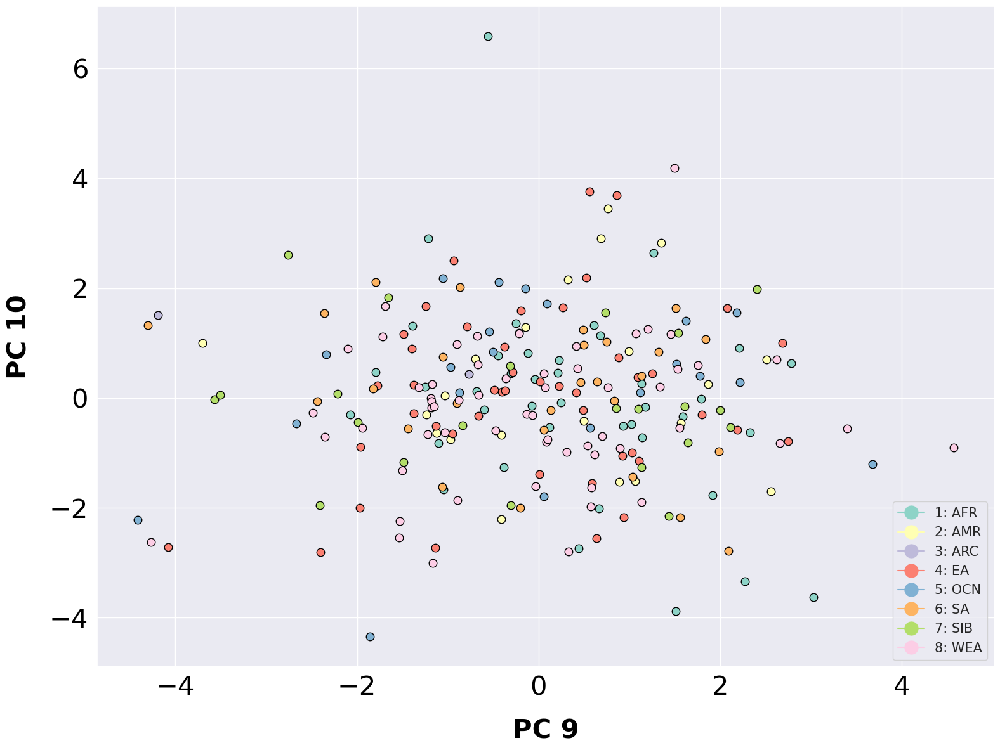

In [93]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h2> My data with only archaic paper samples 

In [94]:
hg_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/archaic_cnv_anotation.csv', index_col=2)

anotation_for_hg = pd.read_csv('../data/SGDP_anotation.csv', sep=',', encoding='latin-1', index_col=0)
new_anotation = anotation_for_hg.merge(hg_anotation, left_index=True, right_index=True)
#new_anotation = new_anotation.set_index("3-Illumina_ID")
new_anotation = new_anotation.set_index("Sample")

new_anotation = new_anotation.merge(archaic_anotation, left_index=True, right_index=True)
new_anotation = new_anotation.set_index("3-Illumina_ID")
new_anotation


,4-reich_id,5-ena_ftp_bam_ptr,6-Sequencing_Panel,7-Gender,8-Population_ID,9-Contributor,10-Region,11-Country,12-Town,13-Latitude,14-Longitude,15-DNA_Source,16-BioSamples Accession,17-Embargo,Sex_x,Population_code,Sample,Region,Country,Sex_y
3-Illumina_ID,,,,,,,,,,,,,,,,,,,,
LP6005677-DNA_B01,S_Albanian-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324400/LP6005...,C,F,Albanian,David Comas,WestEurasia,Albania,Tirana,41.30,19.80,Genomic_from_blood,SAMEA3302780,FullyPublic,female,Albanian,EUR_Albanian_ALB212_,EUR,Albanian,NaN
LP6005443-DNA_D05,S_Tlingit-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324311/LP6005...,C,F,Tlingit,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302889,FullyPublic,female,Tlingit,SIB_TlingitNikolskoye_Ale14_F,SIB,TlingitNikolskoye,F
LP6005443-DNA_H02,S_Aleut-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324343/LP6005...,C,F,Aleut,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302642,FullyPublic,female,Aleut,SIB_AleutBeringIsland_Ale20_F,SIB,AleutBeringIsland,F
LP6005443-DNA_A03,S_Aleut-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324286/LP6005...,C,M,Aleut,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302773,FullyPublic,male,Aleut,SIB_AleutBeringIsland_Ale22_M,SIB,AleutBeringIsland,M
LP6005443-DNA_E05,S_Tlingit-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324318/LP6005...,C,M,Tlingit,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Petropavlovsk-Kamchatski, Commander Islands",53.00,158.65,Genomic_from_blood,SAMEA3302853,FullyPublic,male,Tlingit,SIB_TlingitPreobrazhenskoye_Ale32_M,SIB,TlingitPreobrazhenskoye,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005443-DNA_H11,S_Mixtec-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324348/LP6005...,C,F,Mixtec,William Klitz / Cheryl Winkler,America,Mexico,?,17.00,-97.00,Genomic_from_cell_lines,SAMEA3302811,FullyPublic,female,Mixtec,AMR_Mixtec_mixa0105_F,AMR,Mixtec,F
LP6005443-DNA_E11,S_Mixe-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324324/LP6005...,C,F,Mixe,William Klitz / Cheryl Winkler,America,Mexico,"Tmazulapan, Mixe",16.95,-96.58,Genomic_from_cell_lines,SAMEA3302796,FullyPublic,female,Mixe,AMR_Mixe_mixe0002_F,AMR,Mixe,F
LP6005443-DNA_F11,S_Mixe-3,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324333/LP6005...,C,F,Mixe,William Klitz / Cheryl Winkler,America,Mexico,"Tamazulapan, Mixe",16.95,-96.58,Genomic_from_cell_lines,SAMEA3302723,FullyPublic,female,Mixe,AMR_Mixe_mixe0042_F,AMR,Mixe,F


In [95]:
samples_with_aberrations = list(new_anotation.index)

only_archaic_samples = qdnaseq_df[qdnaseq_df.Sample_ID.isin(samples_with_aberrations)]

only_archaic_samples

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
1,LP6005441-DNA_A01,1,471201,551200,1.0,deletion,0.187758,80000.0,1.992160e-12,2.215930e+09
2,LP6005441-DNA_A01,1,561401,563700,1.0,deletion,0.515678,2300.0,6.286550e-06,1.378130e-10
3,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
4,LP6005441-DNA_A01,1,1642401,1646800,1.0,deletion,0.479367,4400.0,3.622100e-11,3.265140e-04
...,...,...,...,...,...,...,...,...,...,...
167256,LP6005677-DNA_F01,9,138479101,138480200,1.0,deletion,0.000000,1100.0,1.448840e-10,2.479530e-85
167257,LP6005677-DNA_F01,9,139663401,139665100,1.0,deletion,0.342230,1700.0,1.456840e-02,3.936460e-05
167258,LP6005677-DNA_F01,9,139912201,139913300,1.0,deletion,0.491329,1100.0,1.079430e-02,4.271100e-11
167259,LP6005677-DNA_F01,9,141118301,141121700,3.0,duplication,1.548300,3400.0,1.874970e-10,3.035980e-17


In [96]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = only_archaic_samples[only_archaic_samples['Type'] == 'deletion'] 
duplications= only_archaic_samples[only_archaic_samples['Type'] == 'duplication'] 
duplications

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.08923,6900.0,0.000000e+00,5.215800e-35
8,LP6005441-DNA_A01,1,12931701,12937200,3.0,duplication,1.93720,5500.0,0.000000e+00,2.777380e+01
15,LP6005441-DNA_A01,1,13178001,13182000,3.0,duplication,1.60333,4000.0,0.000000e+00,9.707000e-09
16,LP6005441-DNA_A01,1,16875201,16884000,3.0,duplication,1.45973,8800.0,0.000000e+00,4.021390e+04
17,LP6005441-DNA_A01,1,16885001,16906500,3.0,duplication,4.28452,21500.0,0.000000e+00,6.772410e+07
...,...,...,...,...,...,...,...,...,...,...
167242,LP6005677-DNA_F01,9,70650701,70654900,3.0,duplication,1.44435,4200.0,7.732300e-06,3.712950e+05
167243,LP6005677-DNA_F01,9,70663301,70667900,3.0,duplication,1.68017,4600.0,1.385850e-10,6.411030e+05
167246,LP6005677-DNA_F01,9,90528501,90531500,3.0,duplication,1.70224,3000.0,2.328940e-05,7.420850e+08
167259,LP6005677-DNA_F01,9,141118301,141121700,3.0,duplication,1.54830,3400.0,1.874970e-10,3.035980e-17


<h2> High frequency CNVs

In [97]:
final_cnv = deletions.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_cnv

Sample_ID,Chromosome,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,LP6005592-DNA_D03,LP6005592-DNA_D04,LP6005592-DNA_E02,LP6005592-DNA_F03,LP6005592-DNA_G03,LP6005677-DNA_B01,LP6005677-DNA_D01,LP6005677-DNA_D03,LP6005677-DNA_E01,LP6005677-DNA_F01
0,1,176101,230900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,176201,230100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,176901,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,177001,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,177101,231100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52794,9,141105101,141106700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52795,9,141105101,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52796,9,141105501,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52797,9,141105701,141107200,0.458801,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [98]:
counts = final_cnv.iloc[:,3:283]
counts = counts.fillna(2)
X = counts.T
X = X.sort_index()
X

,0,1,2,3,4,5,6,7,8,9,...,52789,52790,52791,52792,52793,52794,52795,52796,52797,52798
Sample_ID,,,,,,,,,,,,,,,,,,,,,
LP6005441-DNA_A01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,0.458801,2.0
LP6005441-DNA_A03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A04,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A05,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A06,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005677-DNA_B01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,0.031425,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005677-DNA_D01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005677-DNA_D03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0


In [99]:
features = anotation.merge(X, left_index=True, right_index=True)
features = features.loc[:,["10-Region", "11-Country"]]
features = features.sort_index()
features

,10-Region,11-Country
LP6005441-DNA_A01,WestEurasia,Russia(Caucasus)
LP6005441-DNA_A03,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,America,Colombia
LP6005441-DNA_A05,WestEurasia,France
LP6005441-DNA_A06,WestEurasia,Italy(Bergamo)
...,...,...
LP6005677-DNA_B01,WestEurasia,Albania
LP6005677-DNA_D01,America,Mexico
LP6005677-DNA_D03,Africa,SouthAfrica
LP6005677-DNA_E01,America,Peru


In [111]:
#PCA
pca = PCA(n_components=10)
pca_results = pca.fit(X).transform(X)

#pca = PCA(n_components=10)
#pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)

df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca 

,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005441-DNA_A01,WestEurasia,Russia(Caucasus),0.160588,-0.881082,-4.706913,0.908661,-1.056176,0.887530,-4.277058,1.960931,1.183139,0.409428
LP6005441-DNA_A03,Oceania,PapuaNewGuinea,-0.594257,1.919866,1.898215,-4.473102,0.577592,-2.228795,-3.602996,-3.141304,-0.818590,4.247010
LP6005441-DNA_A04,America,Colombia,-2.447319,5.465177,4.567008,9.740477,0.072630,-2.317922,-3.212110,3.002776,3.859085,4.911828
LP6005441-DNA_A05,WestEurasia,France,0.670014,-3.122314,-5.599969,-0.304976,-1.055661,-0.209961,-3.039597,1.076507,-4.484732,-0.768683
LP6005441-DNA_A06,WestEurasia,Italy(Bergamo),0.358528,-2.814105,-8.073150,0.959970,-0.543320,-0.120702,-3.941551,-4.843769,-5.623834,1.002691
...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005677-DNA_B01,WestEurasia,Albania,0.222229,-2.408594,-6.872462,0.919662,-1.786635,-1.161677,-2.599985,1.289903,2.755102,-1.031414
LP6005677-DNA_D01,America,Mexico,-1.715657,4.689224,1.797187,8.944122,1.270052,-1.356176,-2.593573,-0.902794,-5.732833,-4.295293
LP6005677-DNA_D03,Africa,SouthAfrica,2.945712,-10.416462,7.350660,3.429439,-2.665015,0.172240,3.749054,-4.224622,-3.516260,-0.020697
LP6005677-DNA_E01,America,Peru,-1.753236,5.035367,1.725804,10.022607,0.490748,-3.054883,2.666830,-2.605514,3.100808,2.271096


                   11-Country  component_1  component_2  component_3  \
10-Region                                                              
WestEurasia  Russia(Caucasus)     0.160588    -0.881082    -4.706913   
Oceania        PapuaNewGuinea    -0.594257     1.919866     1.898215   
America              Colombia    -2.447319     5.465177     4.567008   
WestEurasia            France     0.670014    -3.122314    -5.599969   
WestEurasia    Italy(Bergamo)     0.358528    -2.814105    -8.073150   
...                       ...          ...          ...          ...   
WestEurasia           Albania     0.222229    -2.408594    -6.872462   
America                Mexico    -1.715657     4.689224     1.797187   
Africa            SouthAfrica     2.945712   -10.416462     7.350660   
America                  Peru    -1.753236     5.035367     1.725804   
America                  Peru    -2.082820     4.758125     1.886053   

             component_4  component_5  component_6  component_7

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


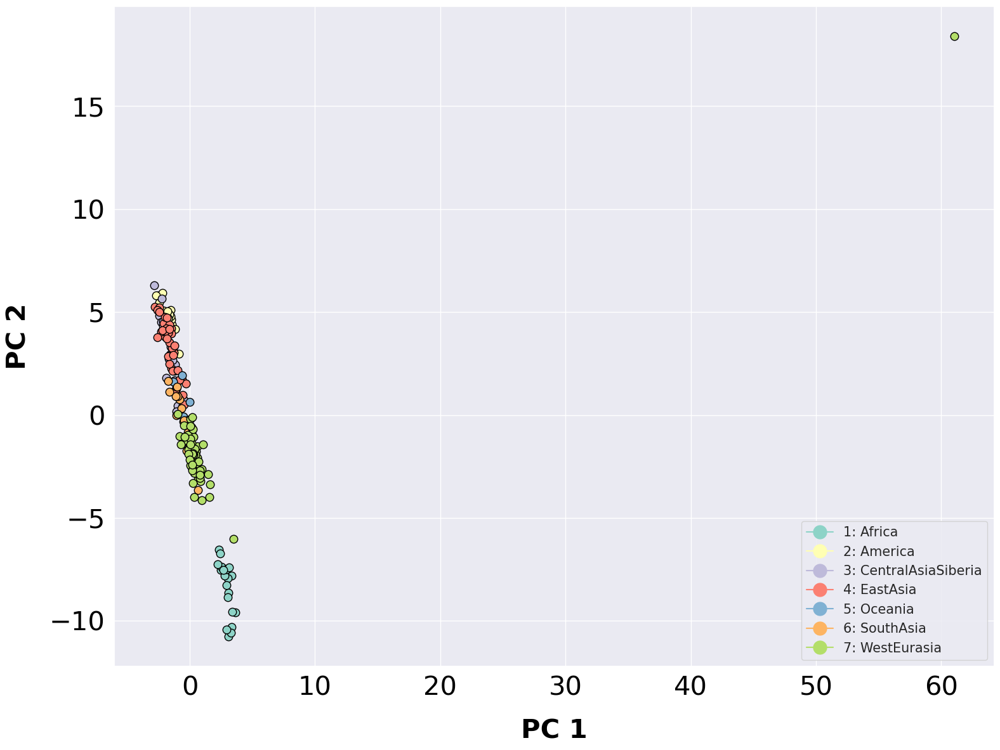

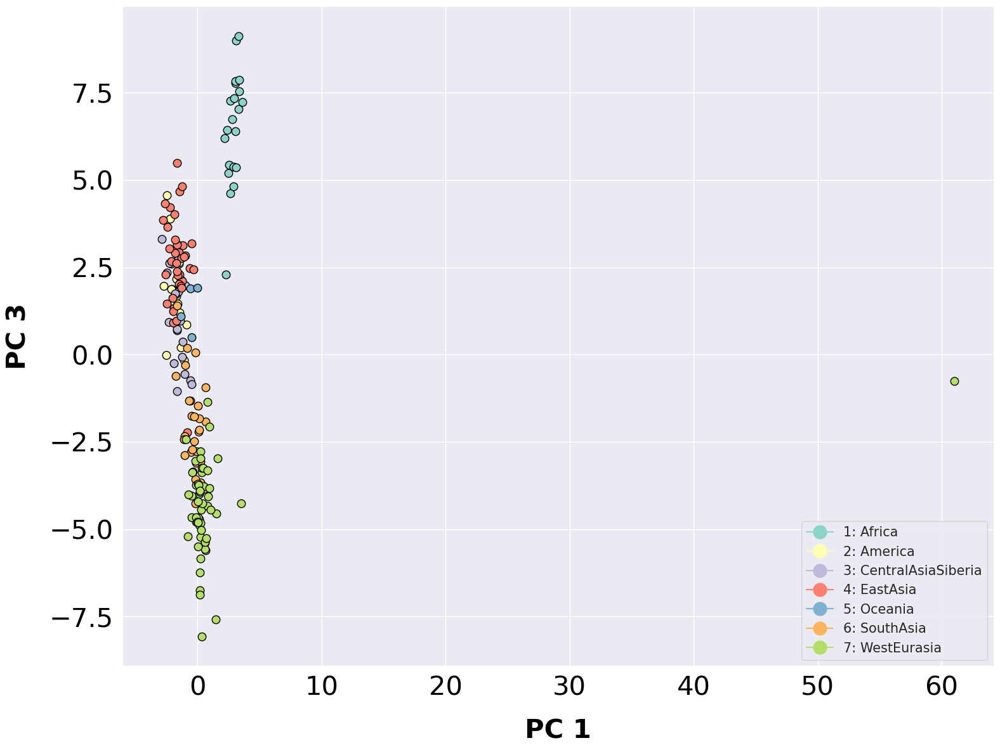

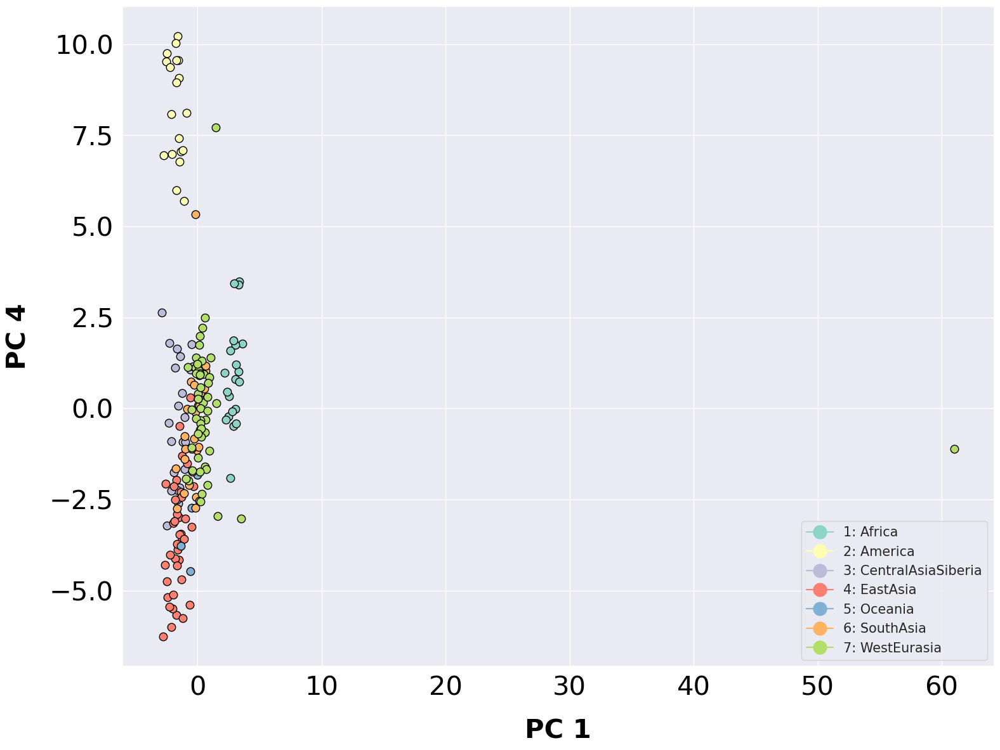

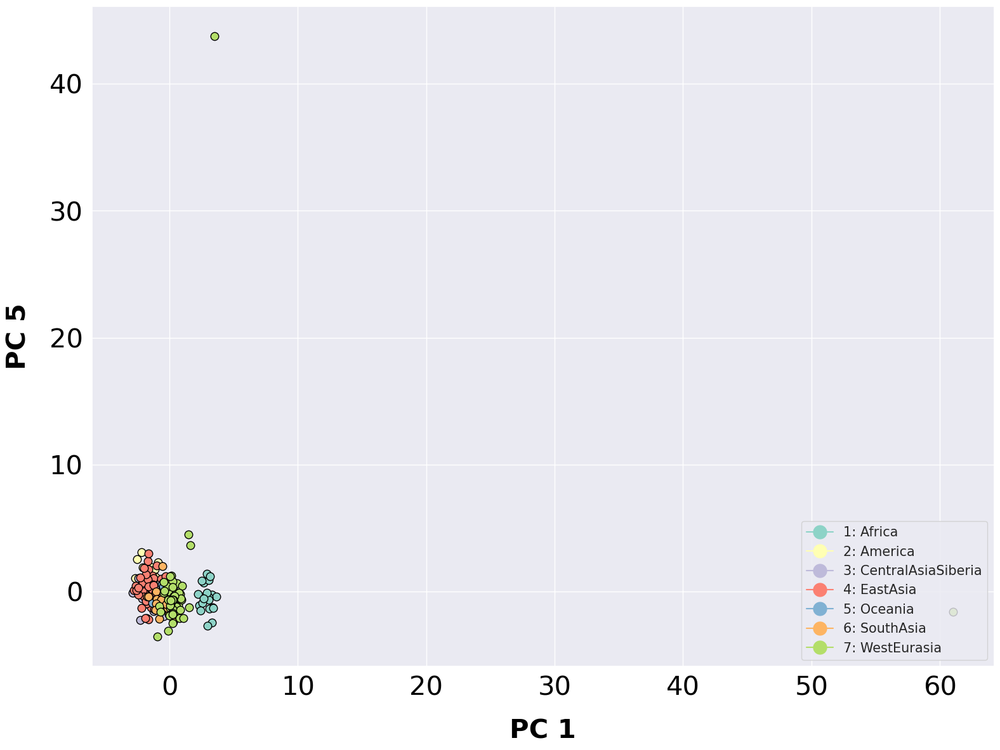

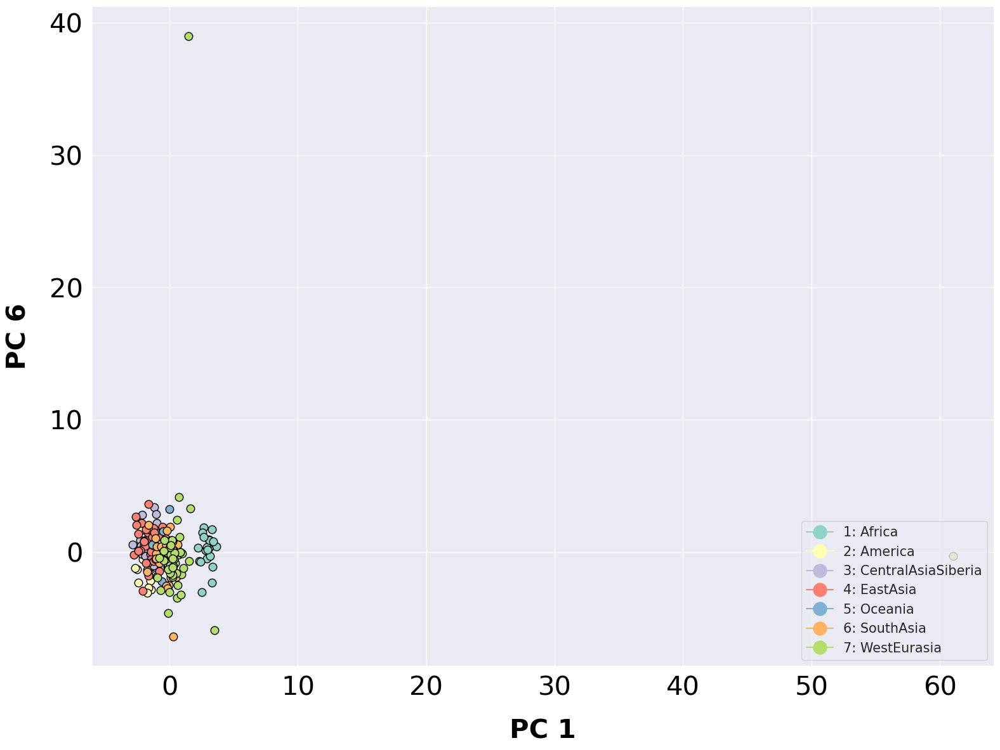

...

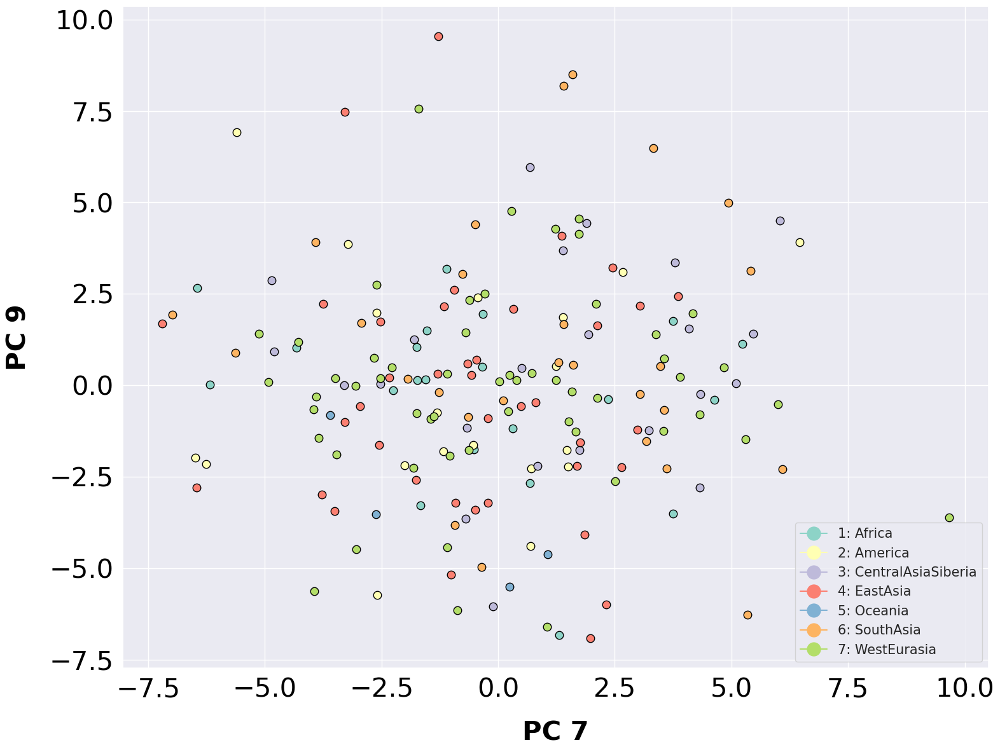

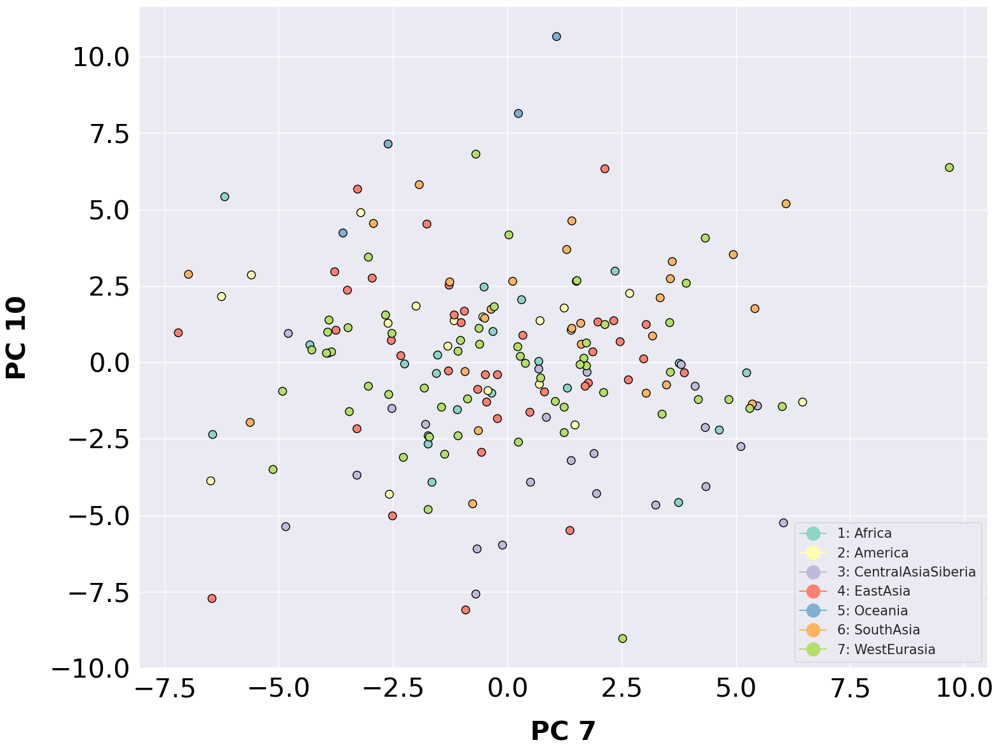

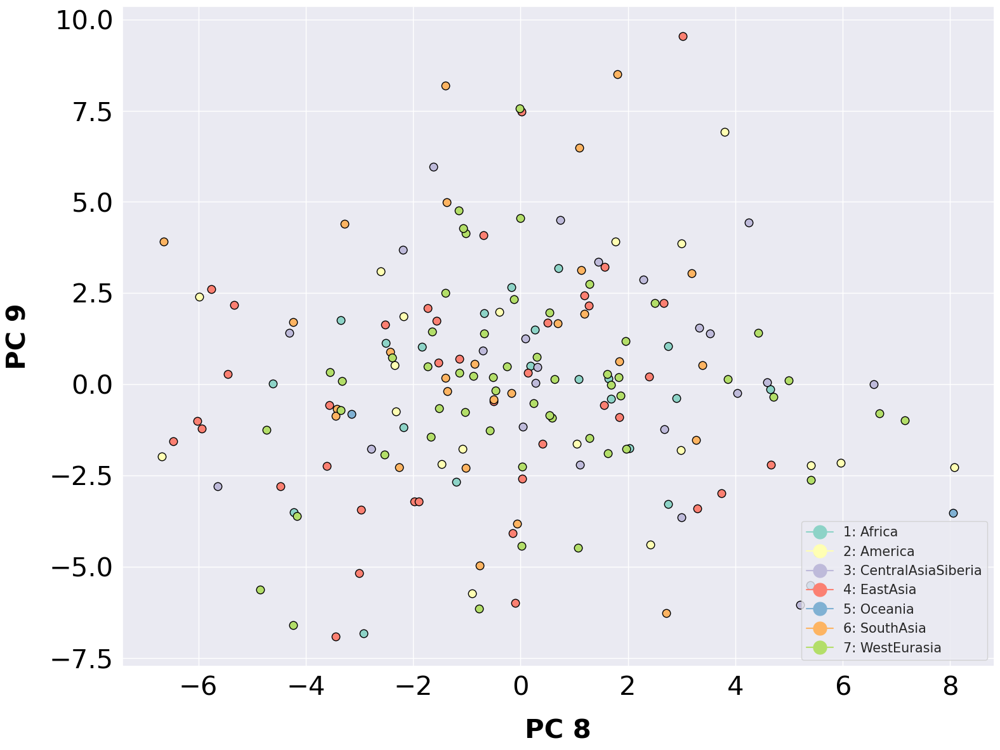

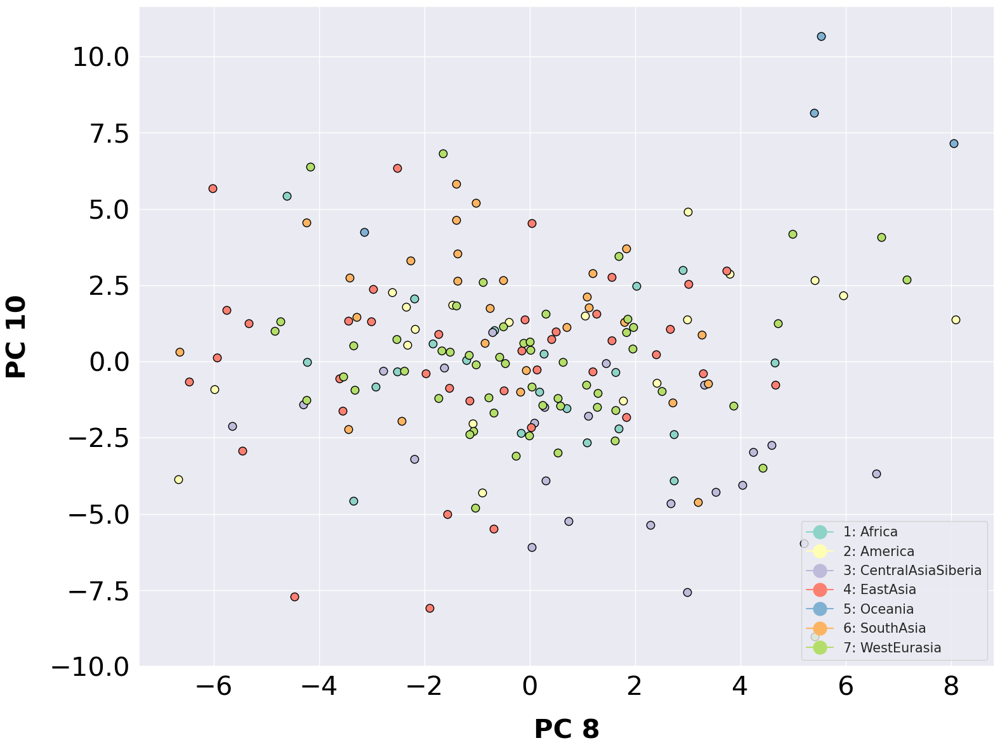

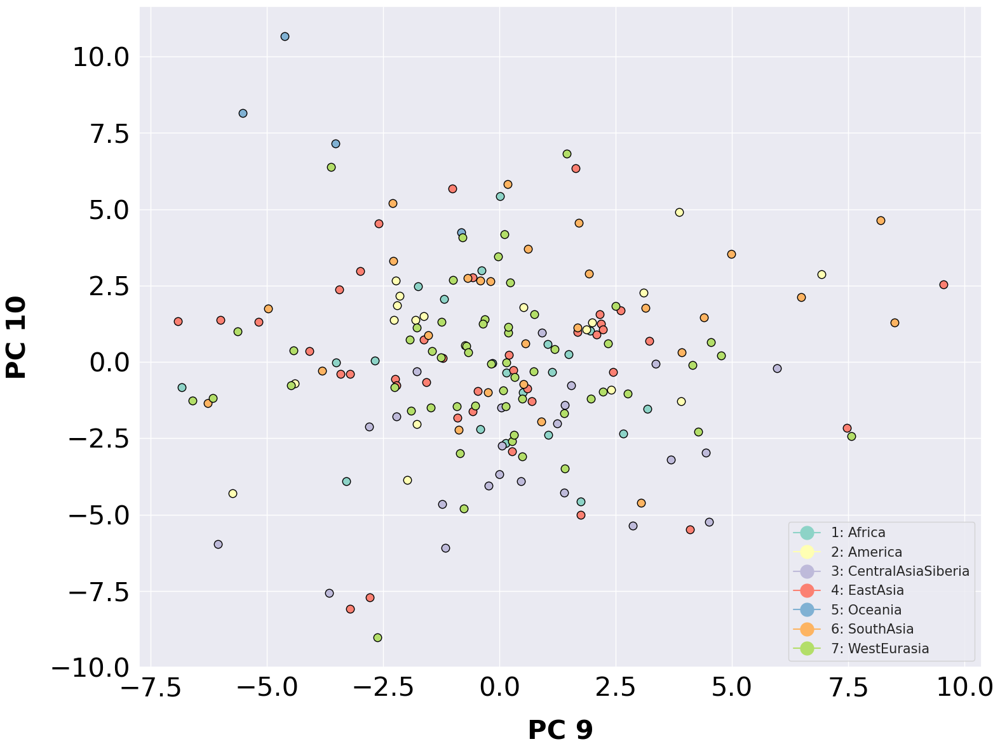

In [112]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h1> getting overlapping regions with sudmant

In [116]:
studmant_data = studmant_data.rename(columns={"contig": "Chromosome", "start": "Start", "end":"End"})

In [119]:
studmant_ranges = PyRanges(studmant_data)

qdnaseq_df = cnvnator_style_ranges.overlap(studmant_ranges, invert=False)
qdnaseq_df = qdnaseq_df.as_df()

qdnaseq_df = qdnaseq_df.sort_values(by=['Sample_ID','Chromosome', 'Start'])
qdnaseq_df#.sort_values(by=['Chromosome', 'Start'])

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
1,LP6005441-DNA_A01,1,471201,551200,1.0,deletion,0.187758,80000.0,1.992160e-12,2.215930e+09
2,LP6005441-DNA_A01,1,723801,728100,3.0,duplication,1.594500,4300.0,1.120070e-02,1.742820e+09
3,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
4,LP6005441-DNA_A01,1,4124201,4127700,1.0,deletion,0.505571,3500.0,4.553500e-11,2.217790e-35
...,...,...,...,...,...,...,...,...,...,...
229336,SS6004480,X,153459601,153466400,3.0,duplication,1.882080,6800.0,3.234320e-09,7.076210e+01
229337,SS6004480,X,153474401,153496200,3.0,duplication,1.734000,21800.0,0.000000e+00,2.123580e+09
229338,SS6004480,X,153498901,153518500,3.0,duplication,1.886020,19600.0,0.000000e+00,2.117350e+07
229339,SS6004480,X,154798801,154804000,1.0,deletion,0.315173,5200.0,3.064860e-11,2.713240e+05


In [120]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = qdnaseq_df[qdnaseq_df['Type'] == 'deletion'] 
duplications= qdnaseq_df[qdnaseq_df['Type'] == 'duplication'] 


In [121]:
#change to df when using telomeres and centromeres filtration
final_cnv = deletions.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_cnv
#Sample_ID	Chr	Start	End	CNV_value	Type	RD	LENGHT	T-TEST-EVAL	GAUSSIAN-EVAL


Sample_ID,Chromosome,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,1,176101,230900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,176201,230100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,176901,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,177001,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,177101,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62901,X,154918501,154922400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62902,X,154918501,154922500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62903,X,154918501,154922700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62904,X,154918601,154921700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [122]:
from scipy import stats
#final_cnv = final_cnv.iloc[new]
final = final_cnv.iloc[:,3:284]
counts = final
counts = counts.fillna(2)

#counts = counts[counts.columns.intersection(counts_a.columns)]

#counts = counts.drop(columns=['LP6005592-DNA_G03',
#                     'LP6005443-DNA_E10',
#                     'LP6005442-DNA_E04'])

counts = counts.T
counts = counts.sort_index()
counts

,0,1,2,3,4,5,6,7,8,9,...,62896,62897,62898,62899,62900,62901,62902,62903,62904,62905
Sample_ID,,,,,,,,,,,,,,,,,,,,,
LP6005441-DNA_A01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A04,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A05,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A06,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
SS6004477,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
SS6004478,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0


In [123]:
#IMPUTATION

features = anotation.merge(counts, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country",]]
features = features.sort_index()
features 


,7-Gender,10-Region,11-Country
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus)
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,F,America,Colombia
LP6005441-DNA_A05,M,WestEurasia,France
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo)
...,...,...,...
SS6004476,M,America,Brazil
SS6004477,M,Oceania,Australia
SS6004478,U,Oceania,Australia
SS6004479,F,America,Mexico


In [124]:
#imp = SimpleImputer(missing_values=np.nan, strategy='mean')
#x = imp.fit_transform(counts.T)

#track features for pca & tsne
#X = StandardScaler().fit_transform(x)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus),-0.324541,-0.236852,0.139187,3.719723,-3.465099,-0.558143,-1.045993,-2.164999,0.025507,1.495864
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea,-0.340423,-2.279938,-0.221830,-4.144939,2.180921,4.840713,-1.198029,0.048536,-2.377150,-1.085538
LP6005441-DNA_A04,F,America,Colombia,-0.881239,-4.185372,-0.310231,-2.599182,2.630390,-7.161902,5.138809,-0.152975,-5.030257,-1.768066
LP6005441-DNA_A05,M,WestEurasia,France,-0.102870,0.961607,0.671355,4.406183,-3.264355,0.357999,-1.094082,-0.992370,-0.121691,1.769916
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo),-0.284336,-0.916065,0.574300,4.577102,-3.369170,-0.500851,1.047998,2.022022,-2.105412,-1.356089
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,M,America,Brazil,-0.122749,-2.094711,0.175281,-1.098863,2.131052,-4.982214,7.979588,3.610570,2.373920,-2.547002
SS6004477,M,Oceania,Australia,-0.063813,0.558381,-0.531477,-3.912803,2.794263,7.995052,5.506282,-0.004709,5.194660,-0.623525
SS6004478,U,Oceania,Australia,-0.555267,0.524906,-0.805894,-3.415713,1.297981,9.036852,2.745435,1.227747,7.076599,-3.935112
SS6004479,F,America,Mexico,-0.360864,-2.472830,0.234377,-2.352758,3.287950,-3.529921,8.781716,5.423824,8.617369,-5.382660


            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.324541    -0.236852     0.139187   
Oceania            F    PapuaNewGuinea    -0.340423    -2.279938    -0.221830   
America            F          Colombia    -0.881239    -4.185372    -0.310231   
WestEurasia        M            France    -0.102870     0.961607     0.671355   
WestEurasia        M    Italy(Bergamo)    -0.284336    -0.916065     0.574300   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.122749    -2.094711     0.175281   
Oceania            M         Australia    -0.063813     0.558381    -0.531477   
Oceania            U         Australia    -0.555267     0.524906    -0.805894   
America            F            Mexico    -0.360864    -2.472830     0.234377   
Africa             M        

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


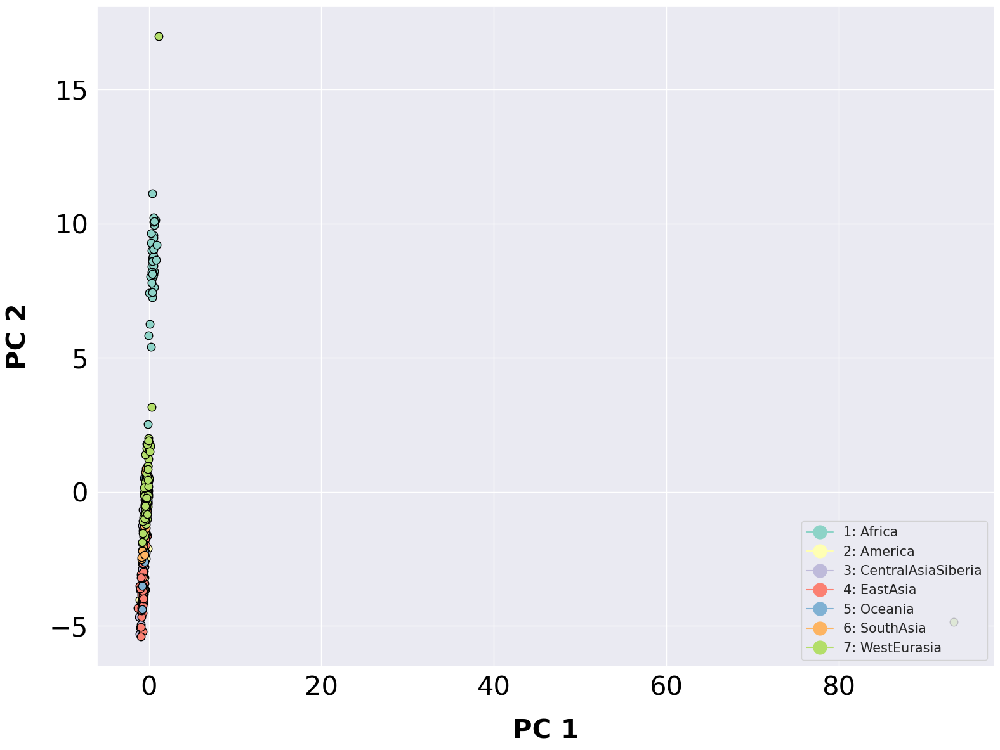

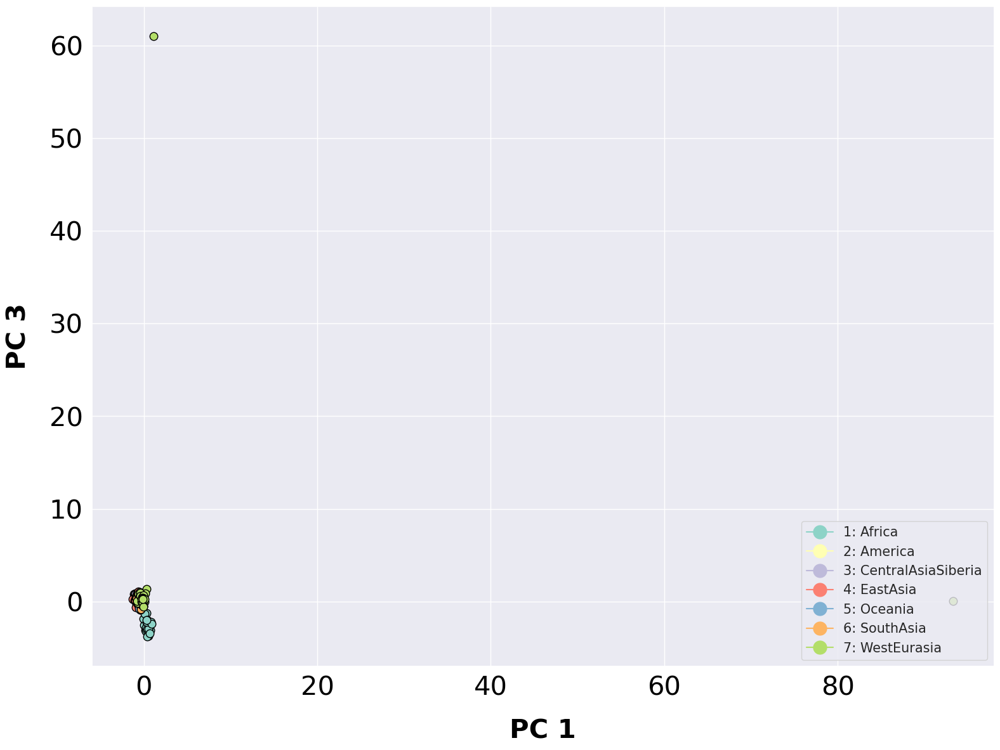

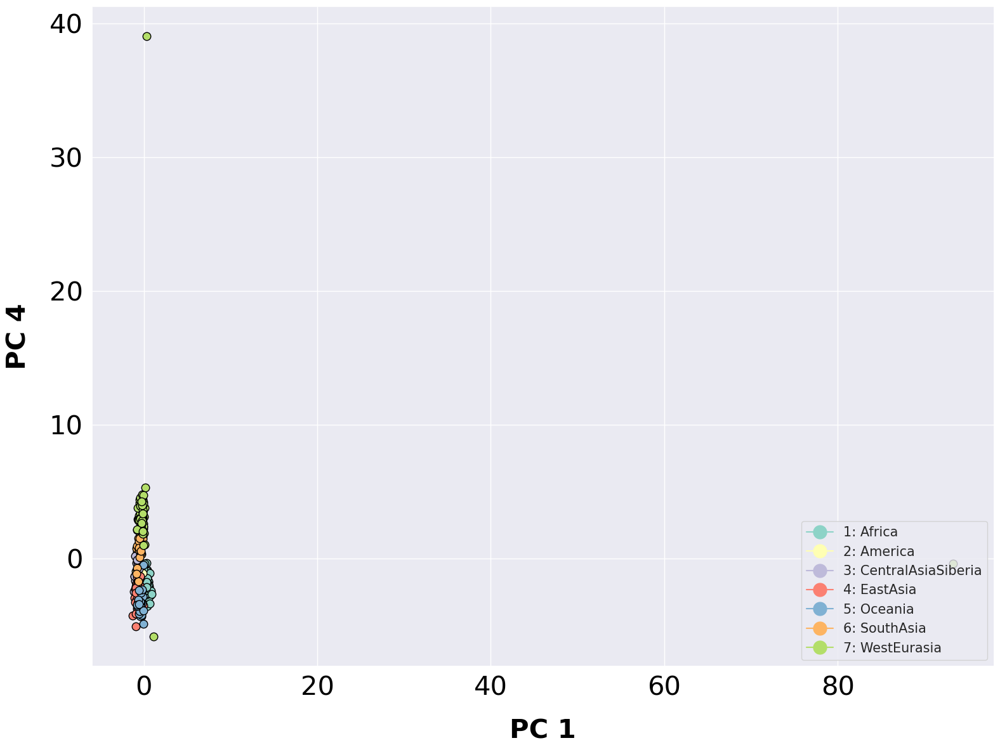

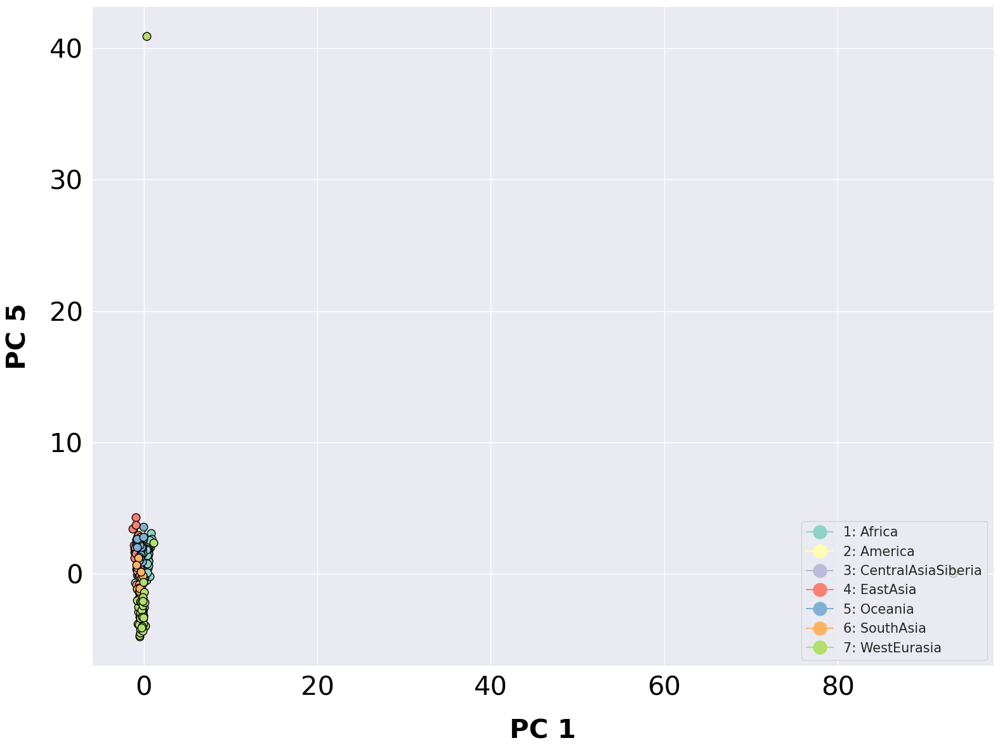

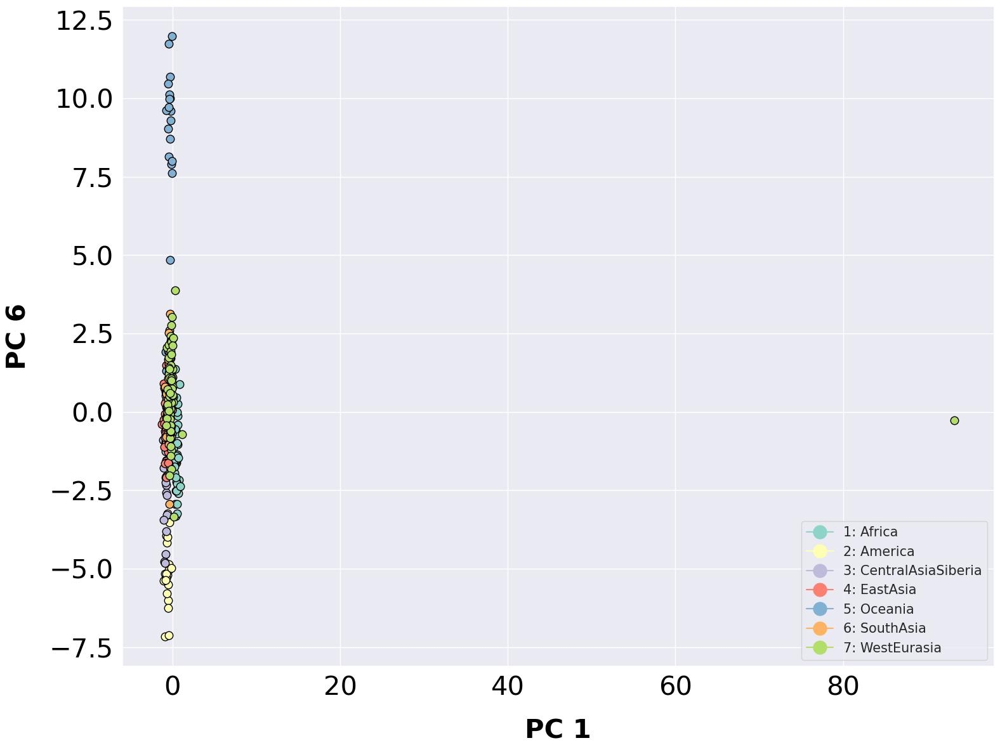

...

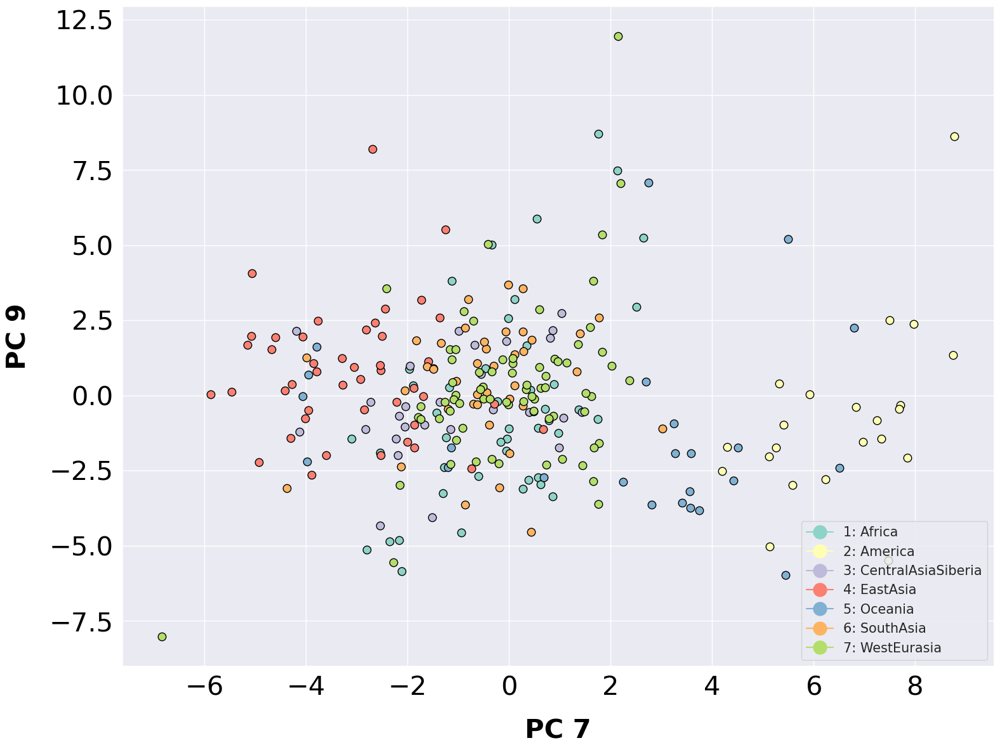

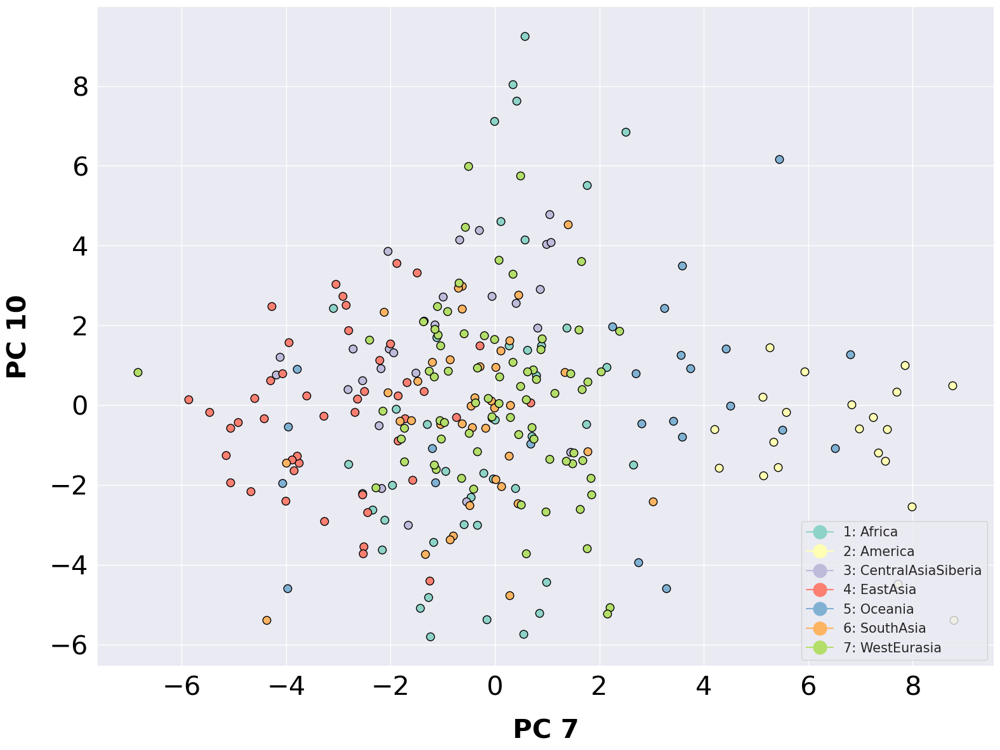

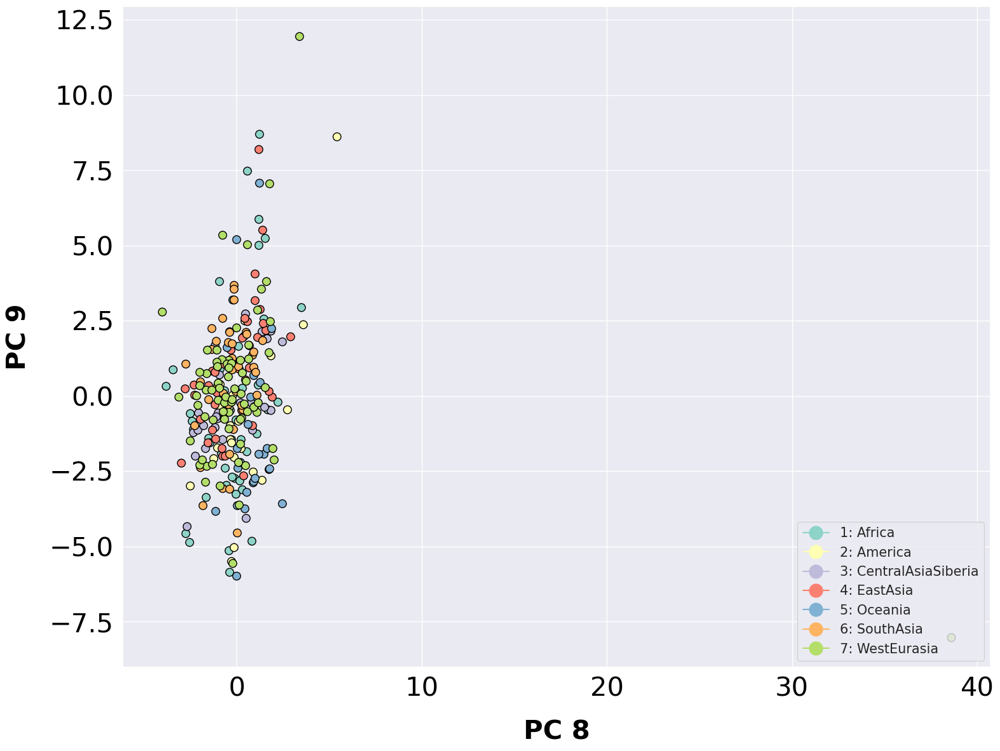

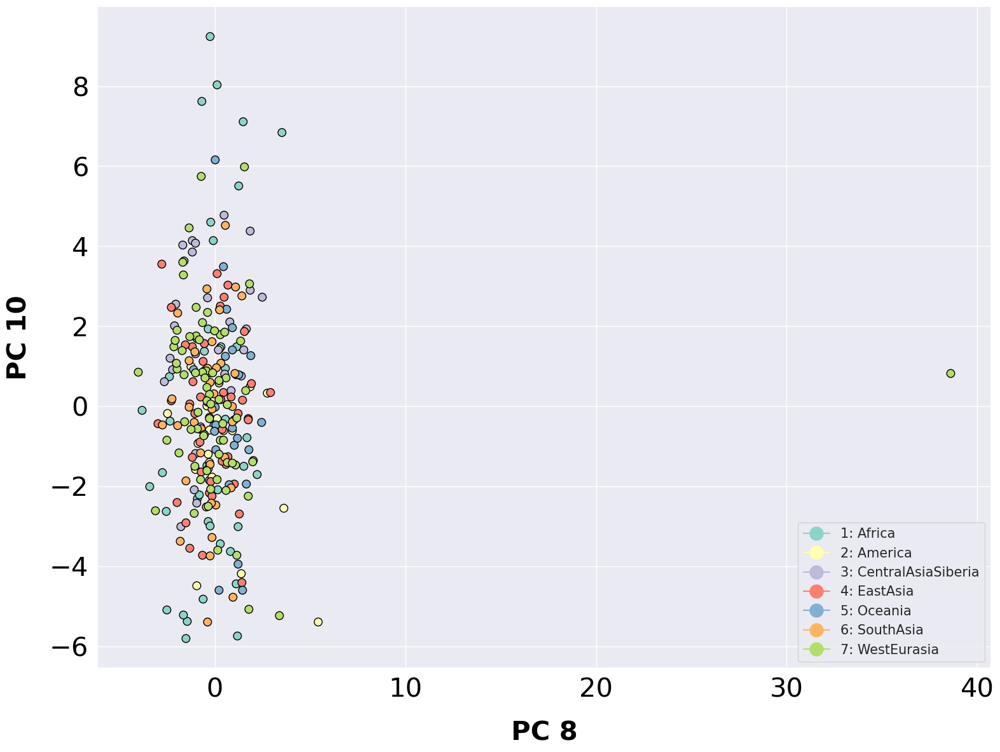

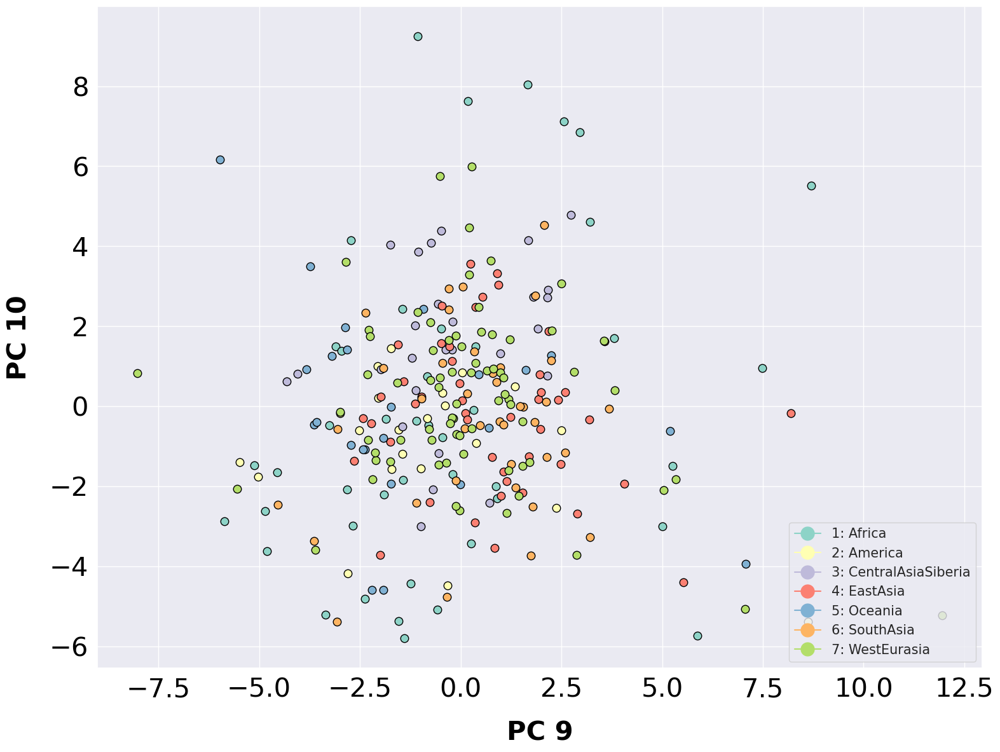

In [125]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [126]:
pca.explained_variance_ratio_

array([0.02588386, 0.01369235, 0.01196523, 0.01016718, 0.0092713 ,
       0.00807665, 0.0067791 , 0.0059137 , 0.0054974 , 0.0052139 ])